In [175]:
from qutip import *
from matplotlib import cm
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from scipy.optimize import curve_fit

class sideband:
    def __init__(self,**params) -> None:
        '''
        level,Tstep,t_edge,|||
        w,yita,g,|||
        L,wd,phid,amp,sp,|||
        rho0,rho_tar|||

        (w+k)n-k/12(x**4)=wn-k/2*ad*ad*a*a
        '''

        self.params={
        # qcircuit
        'level':3,          'hascoupler':False,
        # qubtrit params,   GHz/2pi
        'w':[7,5,0],        'yita':[100,300,0],         'g':[100,0,0],
        # drive params,      GHz/2pi,rad,1
        'wd':[5.15,6],      'phid':[0,0],               'sp_eff':[1,0],
        'sp_direct':None,
        # envelope,         ns,ns,GHz/2pi
        'L':100,            't_edge':10,               'amp':0.1,
        # simulate
        'Tstep':1000,       'rho0':0,                   'rho_tar':None,
        'ksp':None
        }
        self.params.update(params)
        self.__setparams(self.params)
   
    def __setparams(self,dic):
        for p in dic:
            setattr(self,p,dic[p])
        
        # qcircuit
        global n
        n=self.level

        # qubtrit params,   GHz,MHz,MHz
        self.H0=self.__H0
        self.ee,self.es,self.proj=self.__eigen
        self.e1,self.e2=self.ee[2],self.ee[1]
        self.e11,self.e22=self.ee[self.to(1)],self.ee[self.to(2)]
        
        # params pre_guess
        self.ws_g=self.e11/2
        self.wp_g=(self.e22-self.e11)/2
        self.wd_g=[self.ws_g,self.wp_g]
        self.ks_g=1/(self.e1-self.ws_g)+1/(self.e1+self.ws_g)
        self.kp_g=1/(self.e1-self.wp_g)+1/(self.e1+self.wp_g)

        # drive
        self.ws,self.wp=self.wd[0],self.wd[1]
        self.envelope=self.__envelope
        self.ks,self.kp,self.sp=self.__sp
        self.DS,self.HD=self.__DS,self.__HD

        # d
        self.ds_g=2*(self.sp[0]*self.amp*self.ks_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2)
        # 差了4倍
        self.ds_g=self.ds_g/4

        self.dp_g=4*(self.sp[1]*self.amp*self.kp_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2)
        # 差了2倍
        self.dp_g=self.dp_g/2
        self.d_eff_g=[self.ds_g,self.dp_g]
        
        self.T_g=8/(2*(self.amp*self.ks_g)**2*\
            self.yita[0]*self.g[0]/(self.e1-self.e2))
 

        # simulate
        self.H=[2*np.pi*self.H0,[2*np.pi*self.HD,self.DS]]
        self.tlist=np.linspace(0,self.L,self.Tstep)
        if self.rho_tar==None:
            self.rho_tar=self.rho0+1
    
    def update(self,**params):
        self.params.update(params)
        self.__setparams(self.params)

    @property
    def __envelope(self):
        return lambda t,args:\
            self.amp*(0.5*np.cos(np.pi*t/self.t_edge-np.pi)+0.5)\
        if 0<=t<=self.t_edge else\
            self.amp*(0.5*np.cos(np.pi*(t-self.L)/self.t_edge-np.pi)+0.5)\
        if (self.L-self.t_edge)<=t<=self.L else\
            self.amp\
        if self.t_edge<t<(self.L-self.t_edge) else 0
    @property 
    def __sp(self):
        sp_eff,ks_g,kp_g,ws,wp=self.sp_eff,self.ks_g,self.kp_g,self.ws,self.wp
        ks,kp,sp=0,0,0
        sp=[0,0]
        # theoral:sp=[sp_eff[0],np.sqrt(sp_eff[1]*0.5)*(ks_g/kp_g)]

        ks=1/(self.e1-ws)+1/(self.e1+ws)
        kp=1/(self.e1-wp)+1/(self.e1+wp)
        if self.ksp==None:    
            ksp=0.5*(ks_g/kp_g)
        else:
            ksp=self.ksp
        self.ksp_g=ksp
        if self.sp_direct==None:
            sp[0]=sp_eff[0]
            sp[1]=np.sqrt(sp_eff[1])*ksp
        else:
            sp=self.sp_direct
        return ks,kp,sp
    @property
    def __DS(self):
        DS=lambda t,args:0
        def cos(sp,a,w,phi): 
            return lambda t,args:sp*a(t,args)*np.cos(2*np.pi*w*t+phi)
        def add(f1,f2):
            return lambda t,args:f1(t,args)+f2(t,args)

        for i in range(len(self.wd)):
            DS=add(cos(self.sp[i],self.envelope,self.wd[i],self.phid[i]),DS)
        return DS
    @property
    def __HD(self):
        a=destroy(n)
        ad=create(n)
        I=qeye(n)
        D=tensor(a+ad,I)
        return D       
    @property
    def __H0(self):
        w,g,yita=self.w,self.g,self.yita
        a,ad,I=destroy(15),create(15),qeye(n)
        x=a+ad
        def trunc(x):
            return Qobj(x[:n,:n])

        h0=(w[0]+yita[0])*ad*a-yita[0]/12*(x**4)
        h1=(w[1]+yita[1])*ad*a-yita[1]/12*(x**4)

        h0,h1=trunc(h0),trunc(h1)
        G01=g[0]*tensor(trunc(x),trunc(x))

        H0=tensor(h0,I)+tensor(I,h1)+G01
        return H0 
            # return trunc(h0)
    @property
    def __eigen(self):
        eigen=self.H0.eigenstates()
        ee=[e-eigen[0][0] for e in eigen[0]]
        es=eigen[1]
        proj=[s*s.dag() for s in es]
        return ee,es,proj
    
    def plot(self,target='DS'):
        if target=='DS':
            func=self.DS
        elif target=='envelope':
            func=self.envelope
        fix,ax=plt.subplots()
        ax.plot(self.tlist,list(map(func,self.tlist,self.tlist)))

    def to(self,x):
        #n=3,4,5 p22=p[8,11,12] ,assume 11,22 setten at middle of exciting number subspace
        #without consider 30 exceed 04
        #assume w2=2w-yita,w3=3w-2yita
        if x==0:
            return 0
        elif x==1:
            return 4
        elif x==2:
            if n==3:
                return 8
            elif n==4:
                return 11
            elif n==5:
                return 12
            elif n>=6:
                return 13

    def g_Level(self,target=None,g=None):
        if g==None:
            g=self.g[0]*1000
        z=[]
        glist=np.linspace(0,g,100)
        for p in glist:
            self.update(g=[p,0,0])
            ee=self.ee
            ee=[e-ee[0] for e in ee]
            # z.append(ee[2]-ee[1]-2)
            z.append(ee)
        z=np.transpose(z)
        fix,ax=plt.subplots()
        if target==None:
            target=4
            ax.plot(glist,np.transpose(z))
        else:
            # ax.plot(glist,np.transpose(z)[target])
            ax.plot(glist,[i-0*z[target][0] for i in z[target]])
        return z[target][-1]-z[0][-1]
        # return z[target][0]-z[0][0]        

    def run(self,plot=False,population=True,bloch=True):
        if plot:print(f'run start')
        proj,to,tlist,H=self.proj,self.to,self.tlist,self.H
        rho0,rho_tar=self.rho0,self.rho_tar

        rho0=proj[to(rho0)]

        e_ops=[proj[to(0)],proj[to(1)],proj[to(2)]]

        result=mesolve(H,rho0,tlist,e_ops=e_ops)
        tot,error=[],[]
        for i in range(len(result.expect[0])):
            tot.append(
            result.expect[0][i]+result.expect[1][i]+result.expect[2][i]
            )
            error.append(
            result.expect[0][i]+result.expect[1][i]+result.expect[2][i]\
                -result.expect[rho_tar][i]
            )
        result.expect.append(tot)
        result.expect.append(error)
        result.min=min(error)
        
        if plot:
            self.GateProcess(result=result,population=population,bloch=bloch)
            print('run end')
        return result

    def GateProcess(self,result,population=True,bloch=True):
        if population:
            fig, ax = plt.subplots()
            ax.plot(result.times ,
            # np.transpose([result.expect[p]]))
            np.transpose([result.expect[0],result.expect[1],result.expect[2],\
                          result.expect[3],result.expect[4]]))
            ax.set_xlabel('t/ns')
            ax.set_ylabel('Population')
            ax.legend(['P00','P11','P22','tot','tot-target'])
            plt.show()
        if bloch:
            b=Bloch()
            b.add_points([result.expect[0],result.expect[1],result.expect[2]],'l')
            b.show()

    def scan_wd(self,wstart,wstop,wstep,sp=0,runplot=False,plot=True):
        '''
        sp=0,wd=[w_scan,wp]
        sp=1,wd=[ws,w_scan]
        '''
        rho0,rho_tar=self.rho0,self.rho_tar
        wdlist=np.linspace(wstart,wstop,wstep)
        wd=self.wd
        z=[]
        for w in wdlist:
            wd[sp]=w
            # wdt=[lambda t,args:wd]
            self.update(wd=wd)
            result=self.run(plot=runplot)
            z.append(np.transpose(result.expect))
        z=np.transpose(z)
        print(shape(z))

        if plot:
            self.imshow([z[rho_tar],wstart,wstop,wstep],rho_tar)

        return [z,wstart,wstop,wstep,wdlist]
  
    def find_w_mat(self,input,target=None,plot=False):
        z,wstart,wstop,wstep,wdlist=input[0],input[1],input[2],input[3],input[4]
        dom=wstop-wstart
        dpi=(wstop-wstart)/wstep
        error=list(np.min(z[-1],axis=0))
        w_arg=np.argmin(error,axis=0)
        wm_guess=wdlist[w_arg]
        isside= w_arg==0 or w_arg==wstep-1
        return [wm_guess,dom,dpi,isside]

    def wd_fit(self,result,sp=0,plot=True):
        '''return [d_eff,F,t0,c,T]'''
        print(f'wd_fit start \n sp={sp}' )
        edge_step=int(self.Tstep*self.t_edge/self.L)+2
        d_guess=self.d_eff_g[sp]
        error=result.expect[-1][edge_step:self.Tstep-edge_step]
        tlist=self.tlist[edge_step:self.Tstep-edge_step]
        def func(t,d_eff,F,t0,c):
            return F*(0.5*(np.cos(2*np.pi*d_eff*(t-t0))+1))+c
        guess=[d_guess,1,self.t_edge/2,0]
        # print(f',sp={sp}' )
        bounds=([d_guess*0.5,     0.5,      0,            -0.5],\
                [d_guess*1.5,     1.5,        self.t_edge,  +0.5])
        coeff, var_matrix = curve_fit(func,tlist,error,guess,bounds=bounds)
        if plot==True:
            plt.plot(tlist, error)
            plt.plot(tlist, func(tlist,*coeff),color='red')
            plt.xlabel('t')
            plt.ylabel('error')
            plt.title('Linear Fit')
            plt.show()
        T=1/coeff[0]
        coeff=list(coeff)
        coeff.append(T)
        print(f'guess value of [d_eff,F,t0,c]={guess}')
        print(f"fit coeff [d_eff,F,t0,c,T]={coeff}\n wd_fit end")
        return coeff

    ###############################################

    ###############################################

    def auto_scan_scope_error(self,sp=0,dpim=None,plot=True):
        '''return [w,input]'''
        print(f'auto_scan_scope start \n sp={sp}' )
        if dpim==None:
            dpim=0.1*self.d_eff_g[sp]
        wsp,wd=self.wd_g,self.wd
        dw=self.e1-self.e2
        dpi0=0.02*dw
        dpi=dpi0
        w=[wsp[sp]-2*dpi,wsp[sp]-1*dpi,wsp[sp],wsp[sp]+1*dpi,wsp[sp]+2*dpi]
        error=[0,0,0,0,0]

        wm=w
        z,wdlist,iter_list=[],[],[]
        global iter_num
        iter_num=1
        print('iter_num=\n')
        def iter(i):
            global iter_num
            print(iter_num,end='\t')
            if iter_num%5==0:
                print('\n')
            iter_num=iter_num+1
            wd[sp]=w[i]
            self.update(wd=wd)
            result=self.run(plot=True)
            error[i]=np.min(result.expect[-1])
            wdlist.append(w[i])
            z.append(np.transpose(result.expect))

            iter_list.append(iter_num)
            

        # T=2*self.t_edge+0.5*self.T_g/4
        T=2*self.t_edge+0.25*1/self.d_eff_g[sp]
        self.update(L=T)
        print(f'T for scan:{T}')
        for i in [0,2,4]:
            iter(i)
            
        while dpi>dpim:
            # print(f'w--error:{[w,error]}')
            # print(f'dpi={dpi}')
            if error[0]<error[4]:
                iter(1)
                if error[1]<error[2] and error[1]<error[0]:
                    w=list(np.linspace(w[0],w[2],5))
                    error[0]=error[0]
                    error[4]=error[2]
                    error[2]=error[1]
                else:
                    iter(3)
                    j=np.argmin(error)
                    print(f'j={j}')
                    w=list(np.linspace(w[j-1],w[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            elif error[0]>=error[4]:
                iter(3)
                if error[3]<error[2] and error[3]<error[4]:
                    w=list(np.linspace(w[2],w[4],5))
                    error[0]=error[2]
                    error[4]=error[4]
                    error[2]=error[3]
                else:
                    iter(1)
                    j=np.argmin(error)
                    print(f'j={j}')
                    w=list(np.linspace(w[j-1],w[j+1],5))
                    error[0]=error[j-1]
                    error[4]=error[j+1]
                    error[2]=error[j]
            dpi=dpi/2


        print([w[2],error[2]])
        z=np.transpose(z)
        wdlist_sort,zm=zip(*sorted(zip(wdlist,np.transpose(z[self.rho_tar]))))
        
        input=[np.transpose(zm),wsp[sp]-dpi0,wsp[sp]+dpi0,100]
        if plot:
            self.imshow(input=input)
            fix,ax=plt.subplots()
            ax.plot(iter_list,wdlist)
            ax.set_xlabel('iter/n')
            ax.set_ylabel('wd/GHz')
            plt.show()
        
        print(f'dpi={dpim},w_match={w[2]} \n auto_scan_scope end')
        return [w[2],input]

    def auto_scan_scope(self,sp=0,tar=None,dpim=None,plot=True,runplot=False):
        '''tar=0,1,2
        return [w,input]'''
        print(f'auto_scan_scope start \n sp={sp}' )
        if dpim==None:
            dpim=0.01*self.d_eff_g[sp]
        if tar==None:
            tar=self.rho_tar
        wsp,wd,to=self.wd_g,self.wd,self.to
        dw=self.e1-self.e2
        dpi0=0.02*dw
        dpi=dpi0
        w=[wsp[sp]-2*dpi,wsp[sp]-1*dpi,wsp[sp],wsp[sp]+1*dpi,wsp[sp]+2*dpi]
        P_tar=[0,0,0,0,0]

        wm=w
        z,wdlist,iter_list=[],[],[]
        global iter_num
        iter_num=1

        def iter(i):
            global iter_num
            print(iter_num,end=',')
            iter_num=iter_num+1
            wd[sp]=w[i]
            self.update(wd=wd)
            result=self.run(plot=runplot)#plot=True)
            P_tar[i]=np.max(result.expect[tar])
            wdlist.append(w[i])
            z.append(np.transpose(result.expect))

            iter_list.append(iter_num)
            

        # T=2*self.t_edge+0.5*self.T_g/4
        # T=2*self.t_edge+0.1*1/self.d_eff_g[sp]
        T=2*self.t_edge+1*1/self.d_eff_g[0]
        self.update(L=T)
        print(f'T for scan:{T}')
        print('iter_num=')
        for i in [0,2,4]:
            iter(i)
            
        while dpi>dpim:
            # print(f'w--error:{[w,error]}')
            # print(f'dpi={dpi}')
            iter(1)
            if P_tar[1]>P_tar[2] and P_tar[1]>P_tar[0]:
                w=list(np.linspace(w[0],w[2],5))
                P_tar[0]=P_tar[0]
                P_tar[4]=P_tar[2]
                P_tar[2]=P_tar[1]
            else:
                iter(3)
                j=np.argmax(P_tar)
                # print(f'j={j}')
                w=list(np.linspace(w[j-1],w[j+1],5))
                P_tar[0]=P_tar[j-1]
                P_tar[4]=P_tar[j+1]
                P_tar[2]=P_tar[j]
            dpi=dpi/2

        print('\n')
        print([w[2],P_tar[2]])
        z=np.transpose(z)
        wdlist_sort,zm=zip(*sorted(zip(wdlist,np.transpose(z[self.rho_tar]))))
        
        input=[np.transpose(zm),wsp[sp]-dpi0,wsp[sp]+dpi0,100]
        if plot:
            self.imshow(input=input)
            fix,ax=plt.subplots()
            ax.plot(iter_list,wdlist)
            ax.set_xlabel('iter/n')
            ax.set_ylabel('wd/GHz')
            plt.show()
        
        print(f'dpi={dpim},w_match={w[2]} \n auto_scan_scope end')
        return [w[2],input]

    def auto_scan_amp(self,astart,astop,astep,plot=True):
        print(f'auto_scan_amp start \n astart,astop,astep={astart,astop,astep}')
        wd=self.wd_g
        alist=np.linspace(astart,astop,astep)
        wdlist,d_eff_list,T_list=[[],[]],[[],[]],[[],[]]
        for sp in [0,1]:
            for amp in alist:
                print(f'auto_scan_amp ,sp={sp} ,amp={amp}')    
                self.update(amp=amp)
                print(f'amp={amp}')
                self.update(sp_direct=[1-sp,sp],rho0=sp,rho_tar=sp+1)
                wd_m=wd
                wd_m[sp]=self.auto_scan_scope(sp=sp,plot=True)[0]
                wdlist[sp].append(wd_m[sp])

                self.update(L=self.T_g/2,wd=wd_m)   #auto_scan_scope改变了wd，因此改变了T_g
                res=self.run(plot=True,bloch=False)
                coeff=self.wd_fit(res,sp=sp)
                d_eff_list[sp].append(coeff[0])
                T_list[sp].append(coeff[-1])
        wdlist=np.transpose(wdlist)
        d_eff_list=np.transpose(d_eff_list)
        T_list=np.transpose(T_list)
        if plot:
            fig,ax=plt.subplots()
            ax.plot(alist,wdlist)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('w_match/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()            
            fig,ax=plt.subplots()
            ax.plot(alist,d_eff_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('d_eff/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()
            fig,ax=plt.subplots()
            ax.plot(alist,T_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('T/ns')
            ax.legend(['s','p'])
            plt.show()
        print(f'auto_scan_amp end')
        return [alist,wdlist,d_eff_list,T_list]


    def auto_scan_amp(self,astart,astop,astep,plot=True,mix=False,runplot=False):
        '''MIX: While wp far away from wp_mat ,wp only affect ws by delta_ws_p,
        therotically assumed as delta_wp_p which is affect of wp on itself.
        '''
        print(f'auto_scan_amp start \nastart,astop,astep={astart,astop,astep}')
        if mix:
            print(f'mix={mix},sp_direct=[1,1]')
        wd=self.wd_g
        alist=np.linspace(astart,astop,astep)
        wdlist,d_eff_list,T_list=[[],[]],[[],[]],[[],[]]
        print('+'*60)
        if mix:
            for sp in[0,1]:
                self.update(rho0=sp,rho_tar=sp+1)
                for amp in alist:
                    print(f'auto_scan_amp \tsp={sp} \tamp={amp}')    
                    self.update(amp=amp)
                    wd_m=wd
                    wd_m[sp]=self.auto_scan_scope(sp=sp,plot=True,runplot=runplot)[0]
                    wdlist[sp].append(wd_m[sp])
                    self.update(L=1/self.d_eff_g[sp],wd=wd_m) 
                    #auto_scan_scope改变了wd，因此改变了T_g
                    res=self.run(plot=True,bloch=False)
                    coeff=self.wd_fit(res,sp=sp)
                    d_eff_list[sp].append(coeff[0])
                    T_list[sp].append(coeff[-1])
                    print('+'*60)
        else:
            for sp in [0,1]:
                self.update(sp_direct=[1-sp,sp],rho0=sp,rho_tar=sp+1)
                for amp in alist:
                    print(f'auto_scan_amp ,sp={sp} ,amp={amp}')    
                    self.update(amp=amp)
                    wd_m=wd
                    wd_m[sp]=self.auto_scan_scope(sp=sp,plot=True)[0]
                    wdlist[sp].append(wd_m[sp])

                    self.update(L=self.T_g/2,wd=wd_m)   
                    #auto_scan_scope改变了wd，因此改变了T_g
                    res=self.run(plot=True,bloch=False)
                    coeff=self.wd_fit(res,sp=sp)
                    d_eff_list[sp].append(coeff[0])
                    T_list[sp].append(coeff[-1])
                    print('+'*60)
        wdlist=np.transpose(wdlist)
        d_eff_list=np.transpose(d_eff_list)
        T_list=np.transpose(T_list)
        
        if plot:
            fig,ax=plt.subplots()
            ax.plot(alist,wdlist)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('w_match/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()            
            fig,ax=plt.subplots()
            ax.plot(alist,d_eff_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('d_eff/2pi/GHz')
            ax.legend(['s','p'])
            plt.show()
            fig,ax=plt.subplots()
            ax.plot(alist,T_list)
            ax.set_xlabel('amp/2pi/GHz')
            ax.set_ylabel('T/ns')
            ax.legend(['s','p'])
            plt.show()
        print(f'auto_scan_amp end')
        print('+'*60)
        return [alist,wdlist,d_eff_list,T_list]


    def imshow(self,input,target=0):
        z,wstart,wstop,wstep=input[0],input[1],input[2],input[3]
        # print(shape(z))
        # plt.imshow(z[target],extent=[wstart,wstop,self.tlist[-1],self.tlist[0]],\
        # aspect=(wstop-wstart)/(self.tlist[-1]-self.tlist[0]),interpolation='none')
        plt.imshow(z,extent=[0,wstop-wstart,self.tlist[-1],self.tlist[0]],\
        aspect=(wstop-wstart)/(self.tlist[-1]-self.tlist[0]),interpolation='none')
        plt.colorbar()
        plt.show()


run start


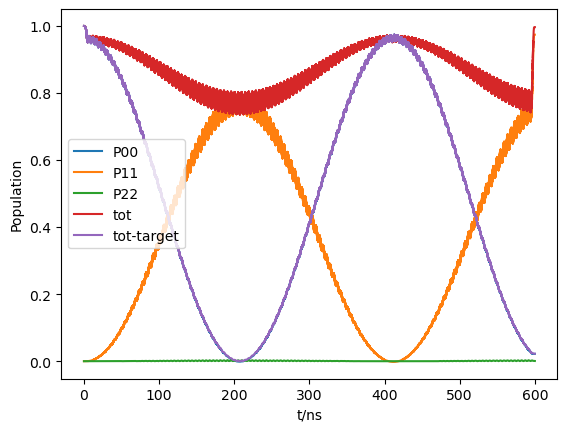

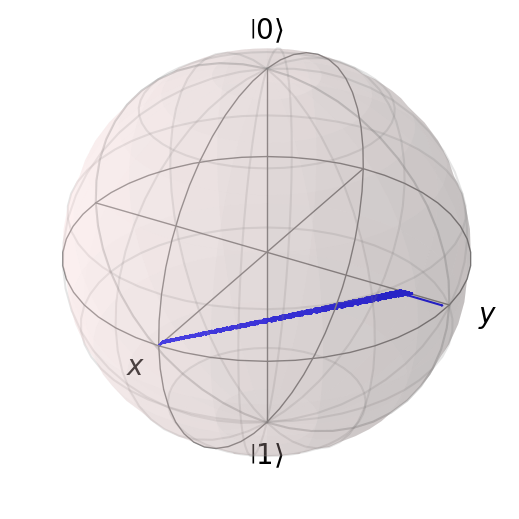

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [176]:

# wd=[4.437674361533853,4.240367440173982]
wd=[4.437634021354223,4.225607661794411 ]
# wd=[4.433922724828316,4.240367440173982 ]
# wd=[4.4339,4.2500]
# 4.433922724828316
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],
L=600,wd=wd,sp_direct=[1,0.1],amp=0.2,
rho0=0,rho_tar=1)
a.run(plot=True)
# b=a.auto_scan_scope(sp=1,runplot=True)

auto_scan_scope start 
 sp=1
T for scan:430.2175112334954
iter_num=
1,run start


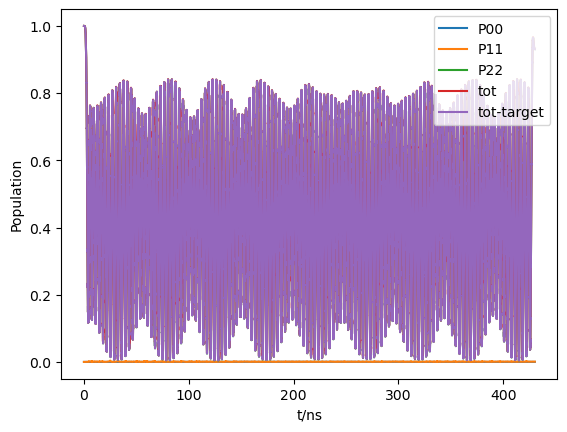

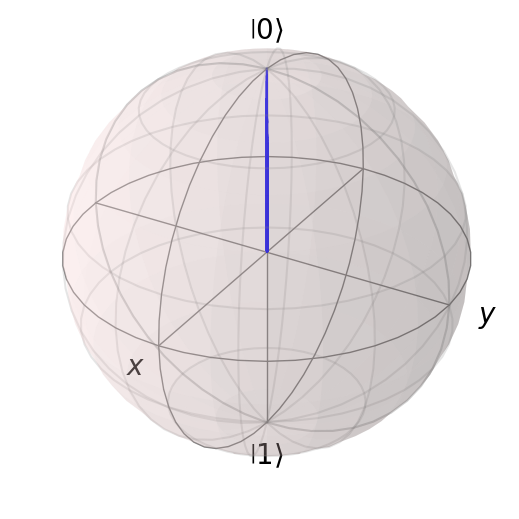

run end
2,run start


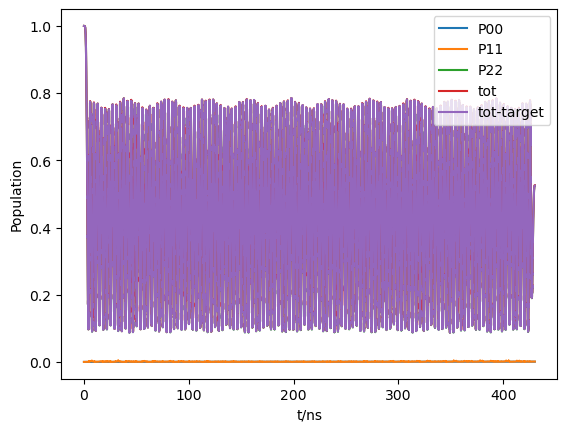

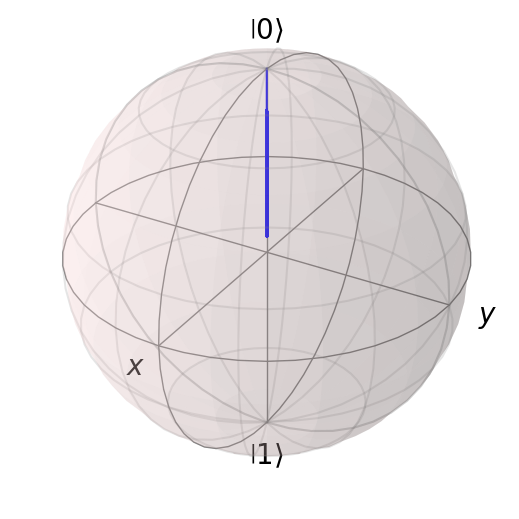

run end
3,run start


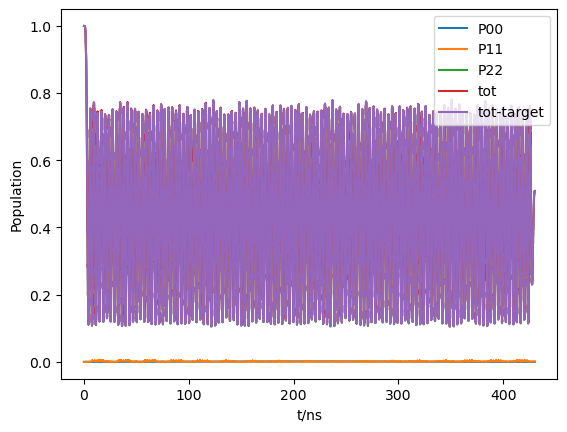

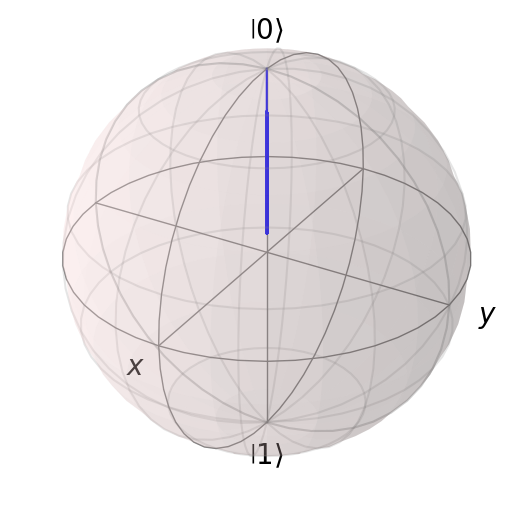

run end
4,run start


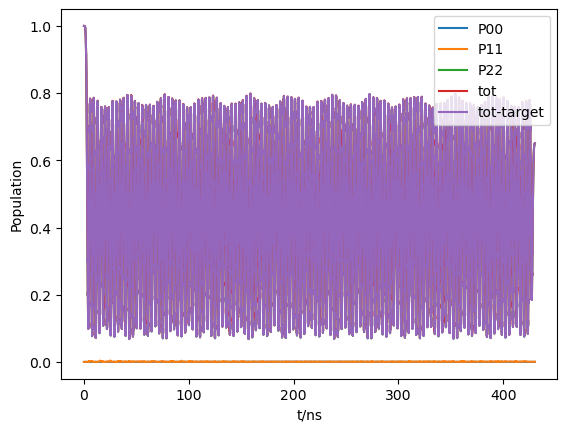

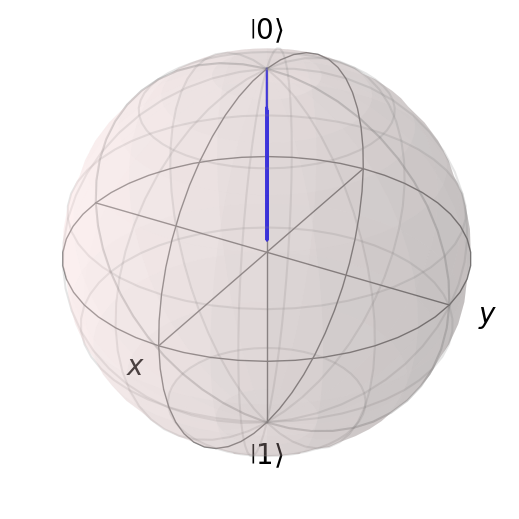

run end
5,run start


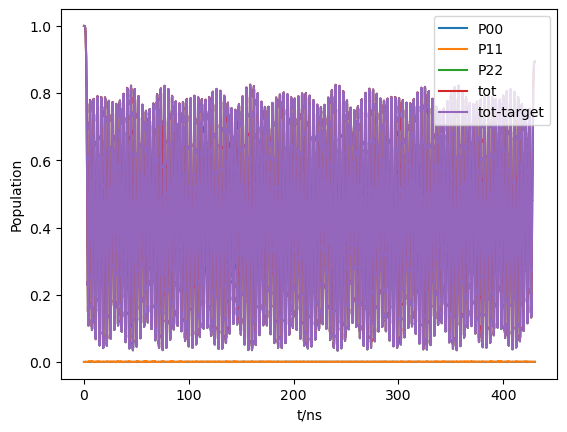

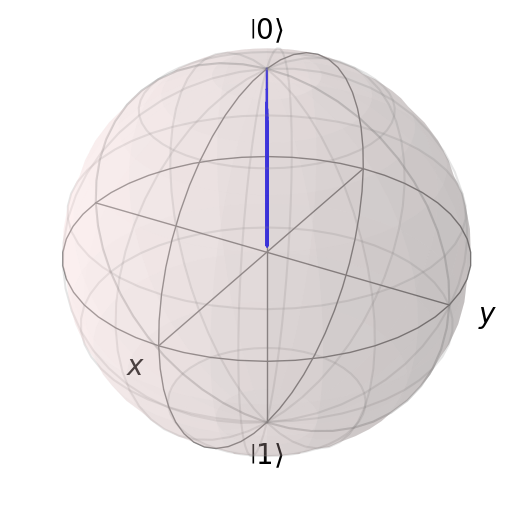

run end
6,run start


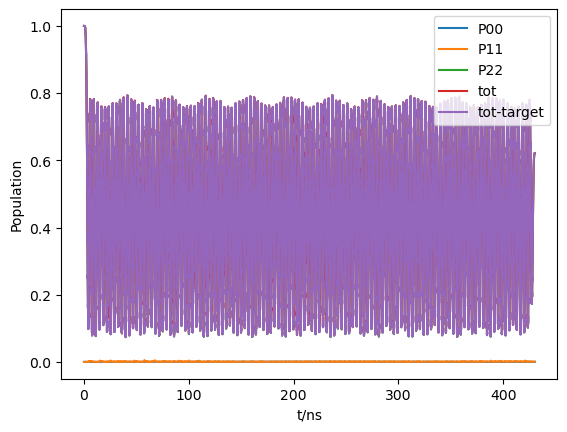

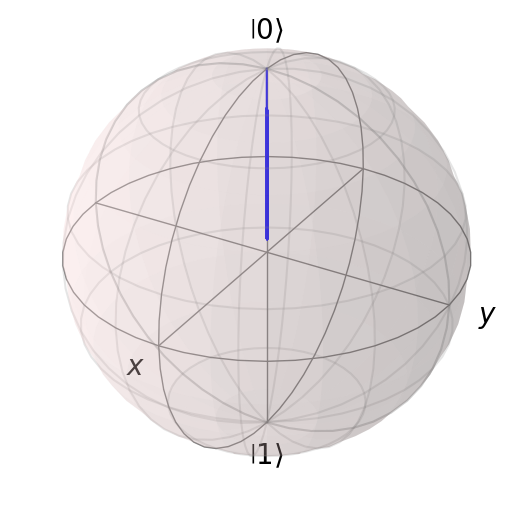

run end
7,run start


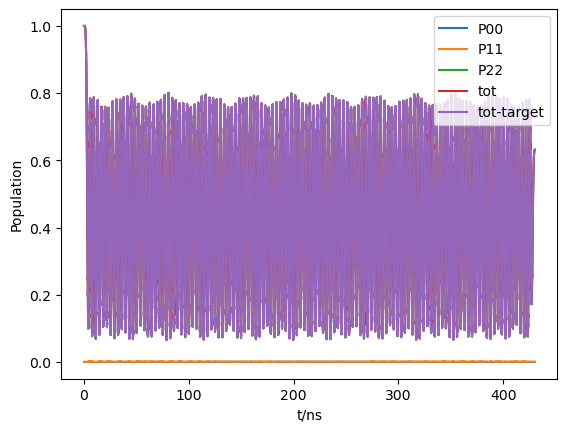

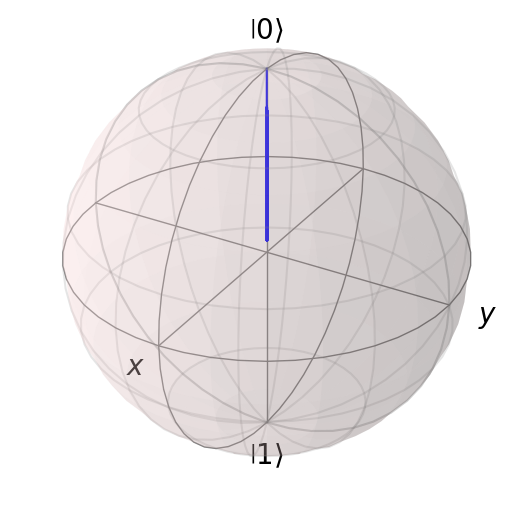

run end
8,run start


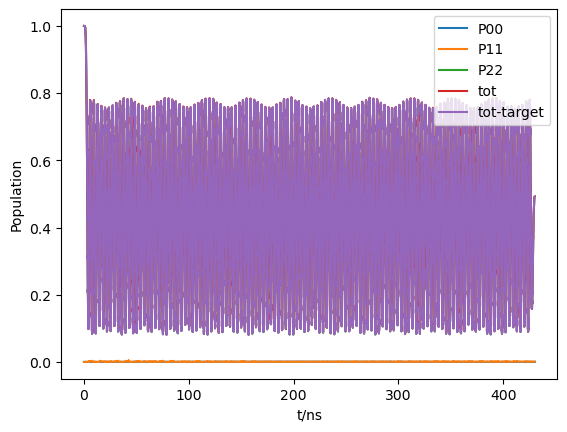

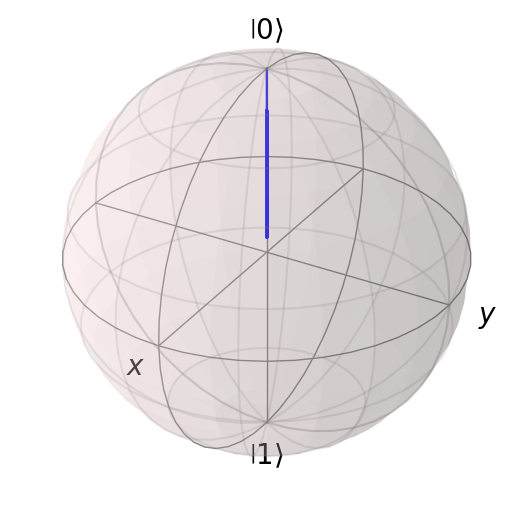

run end
9,run start


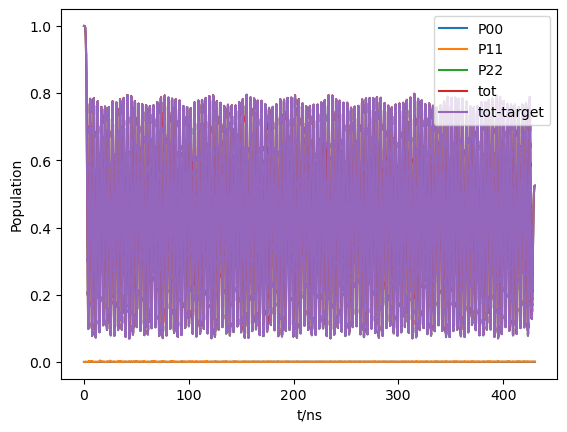

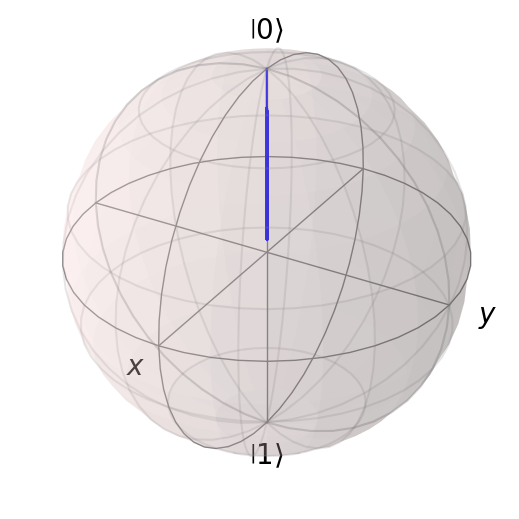

run end
10,run start


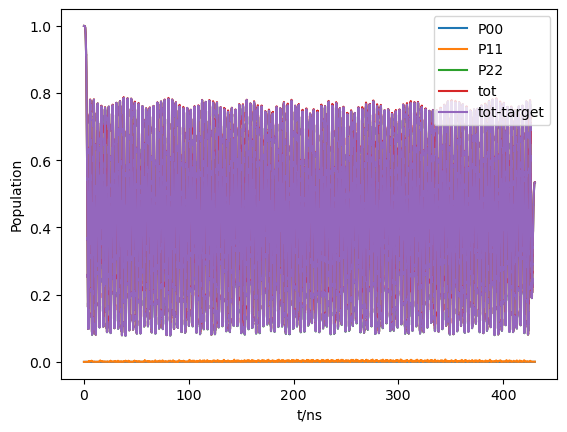

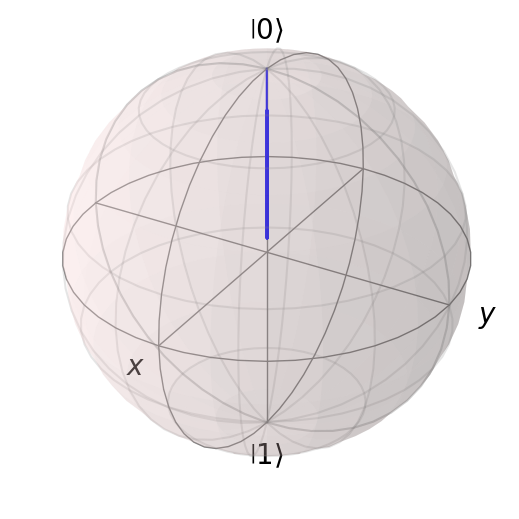

run end
11,run start


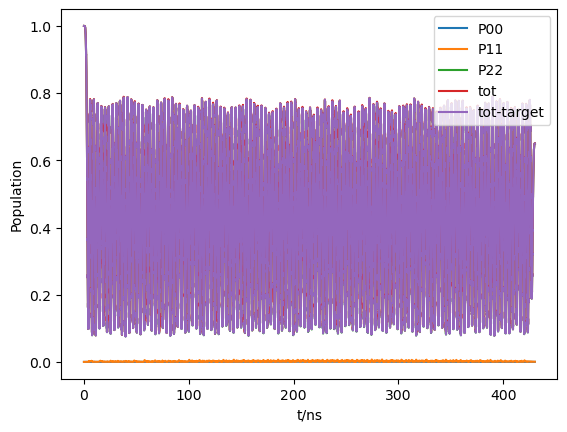

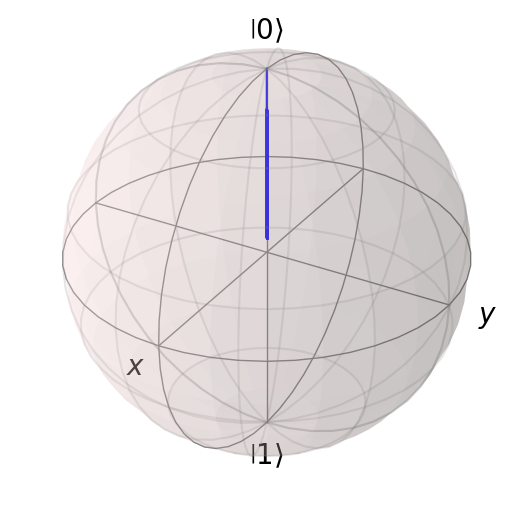

run end
12,run start


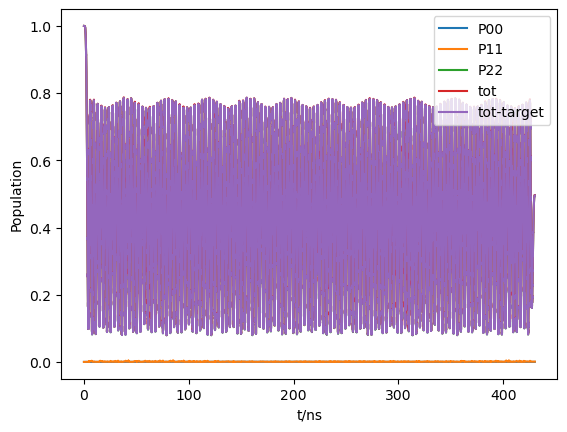

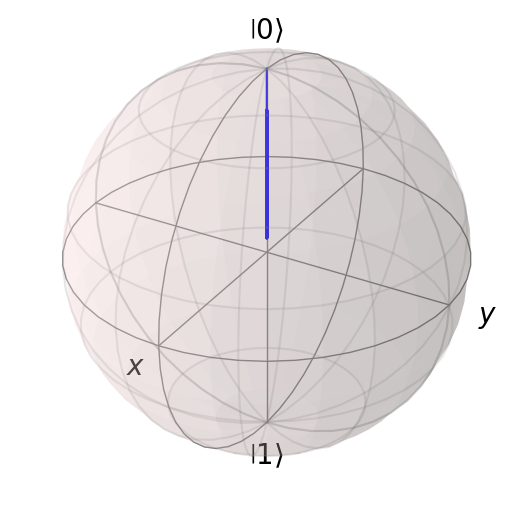

run end
13,run start


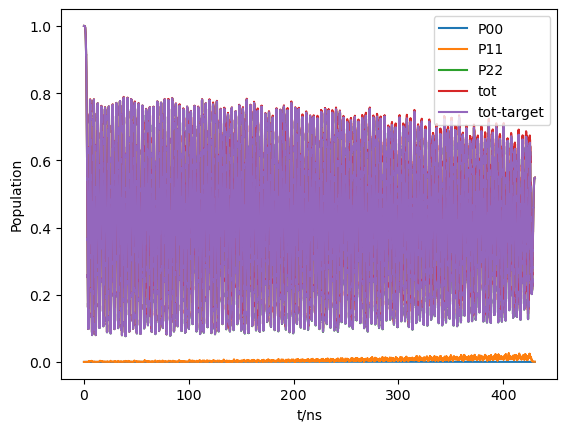

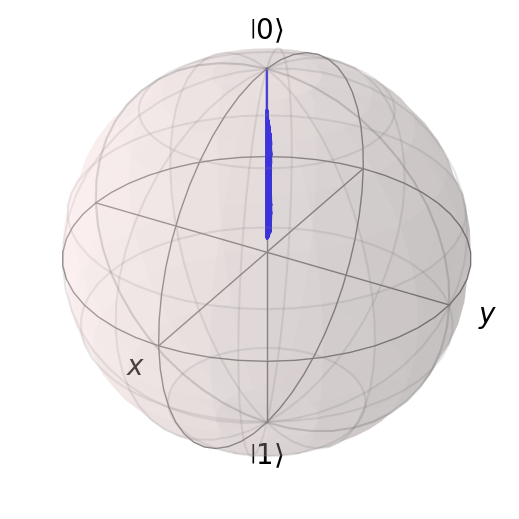

run end
14,run start


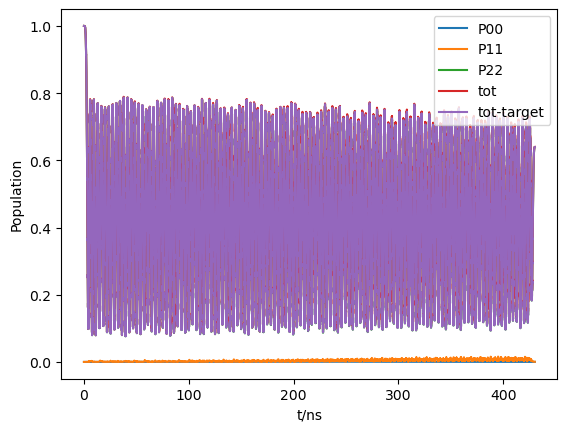

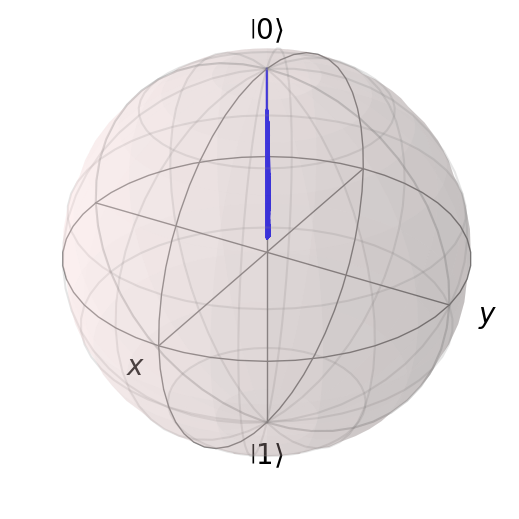

run end
15,run start


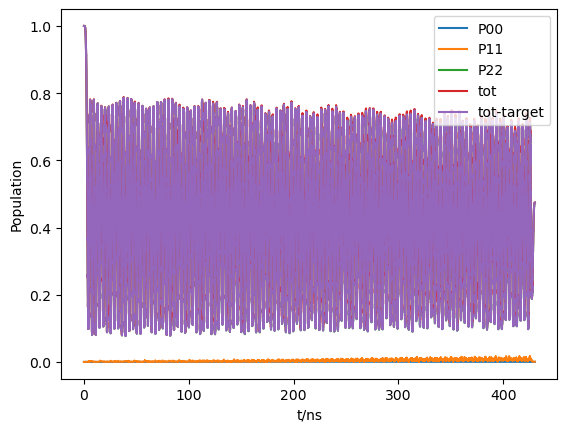

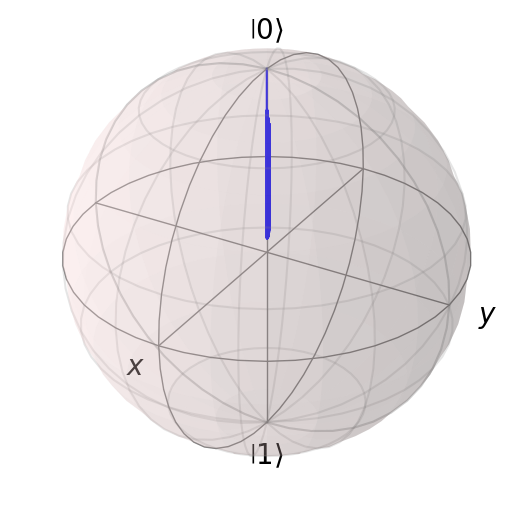

run end
16,run start


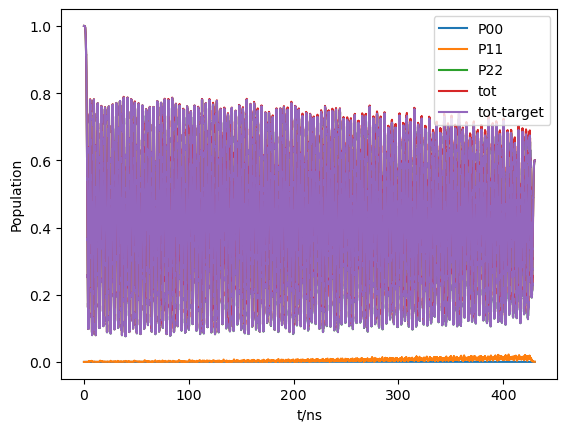

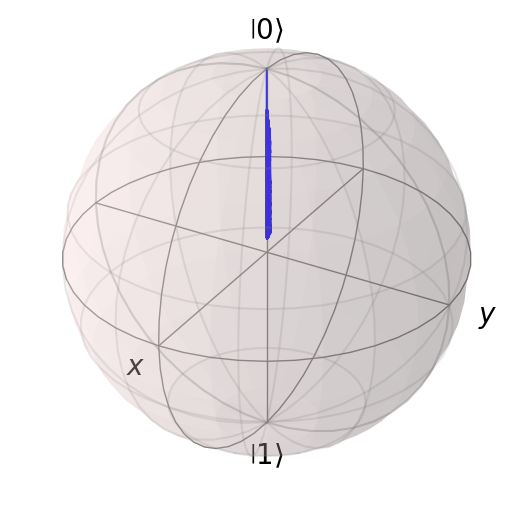

run end
17,run start


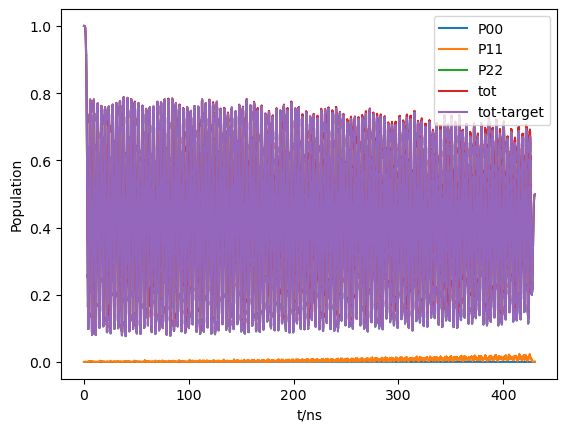

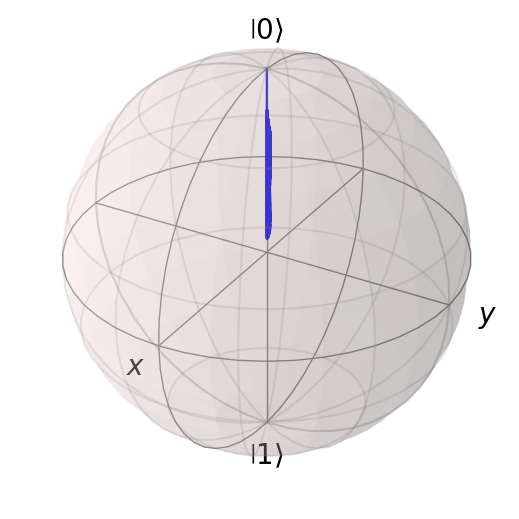

run end
18,run start


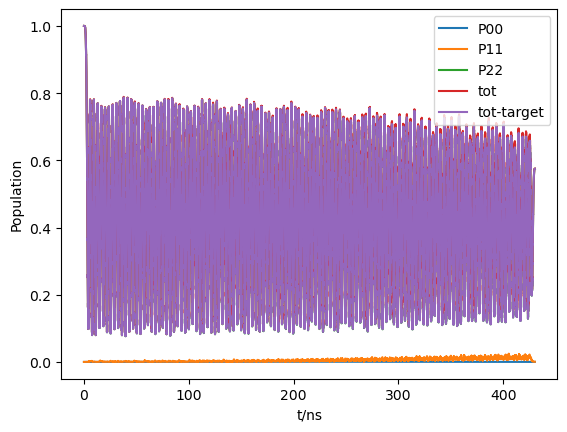

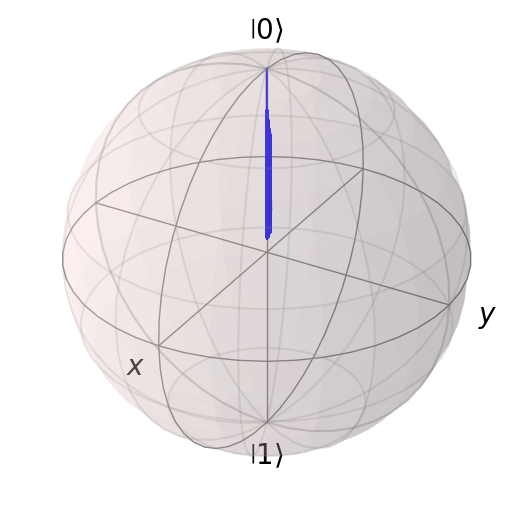

run end
19,run start


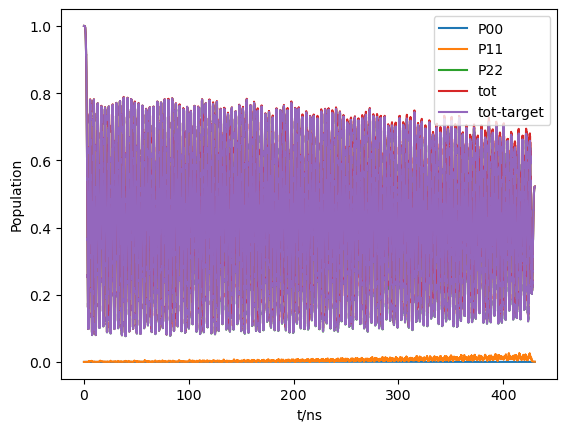

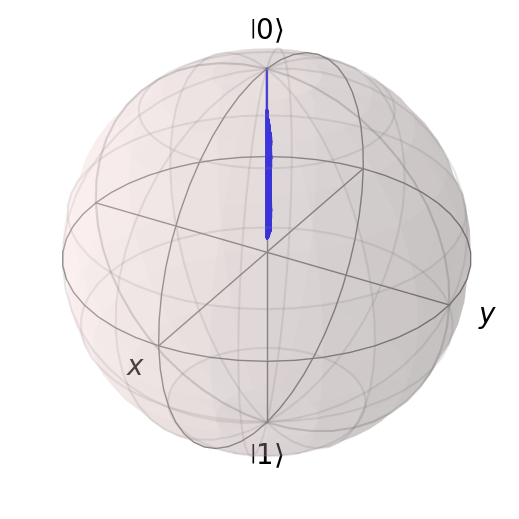

run end
20,run start


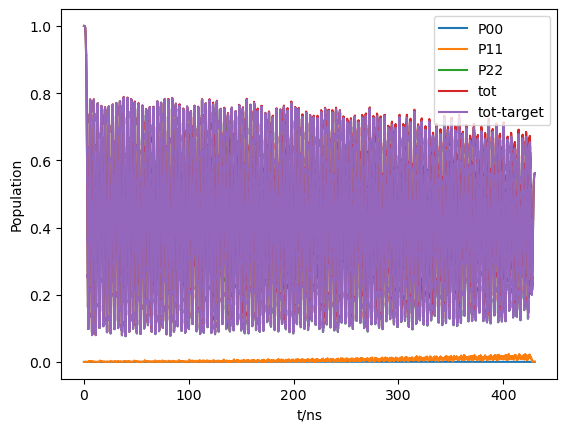

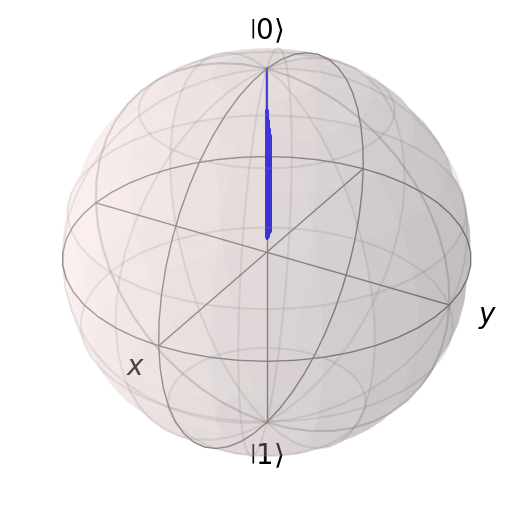

run end
21,run start


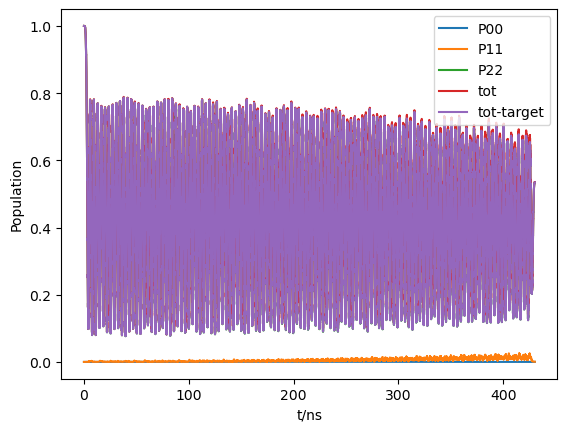

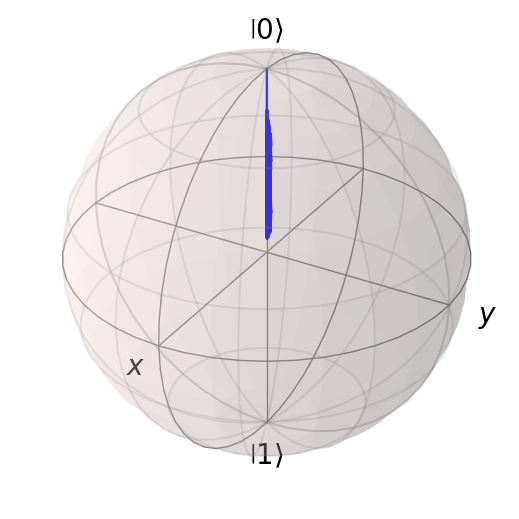

run end
22,run start


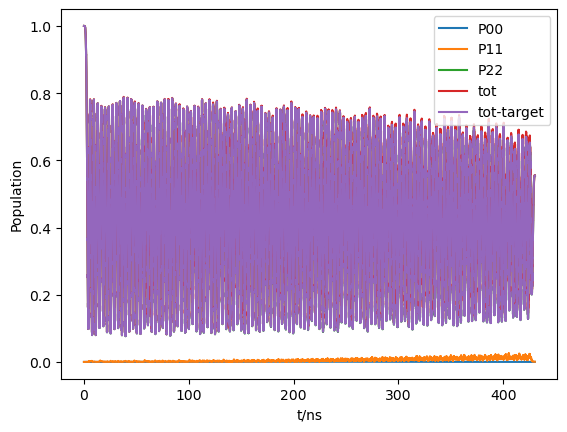

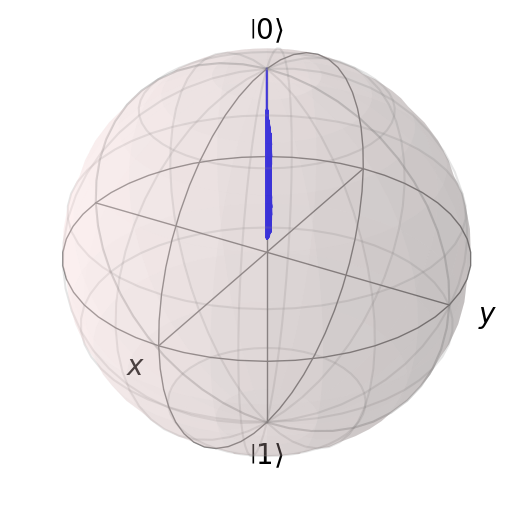

run end
23,run start


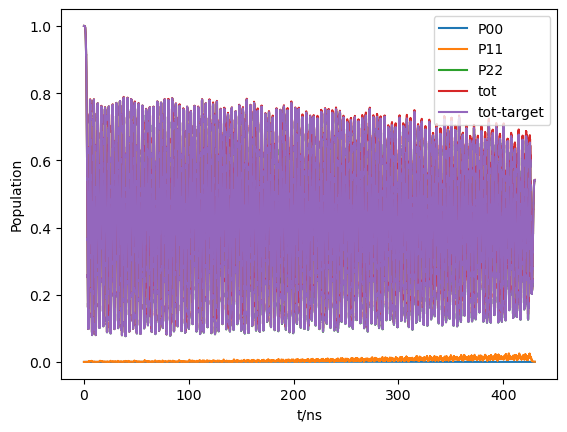

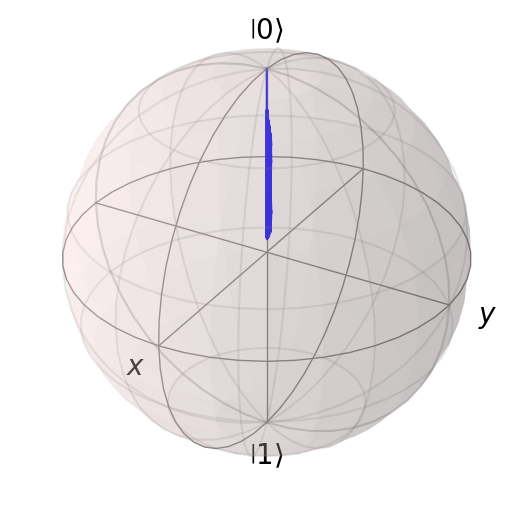

run end
24,run start


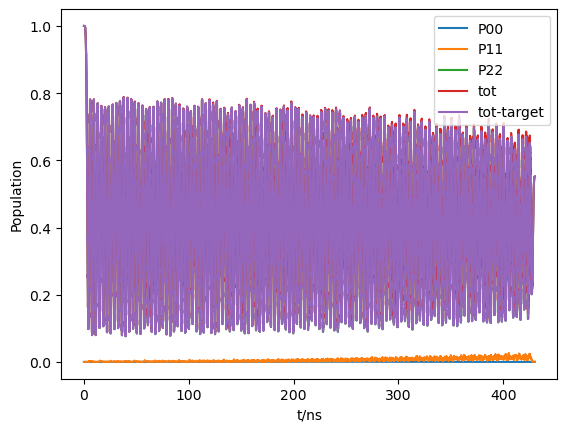

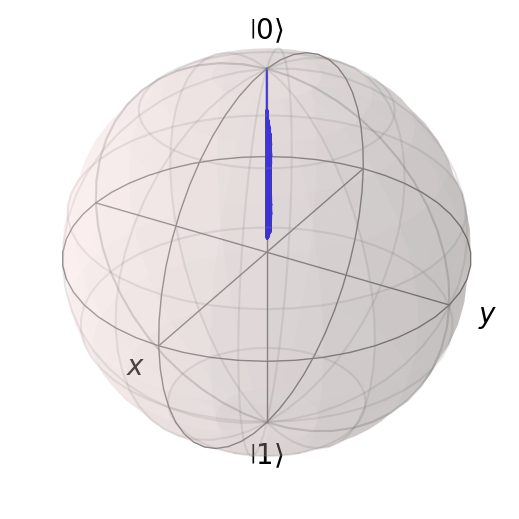

run end
25,run start


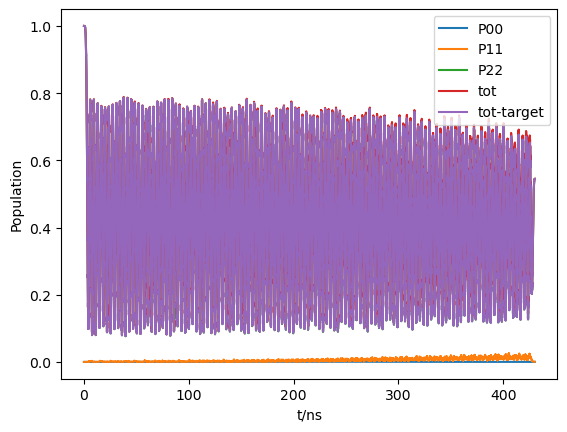

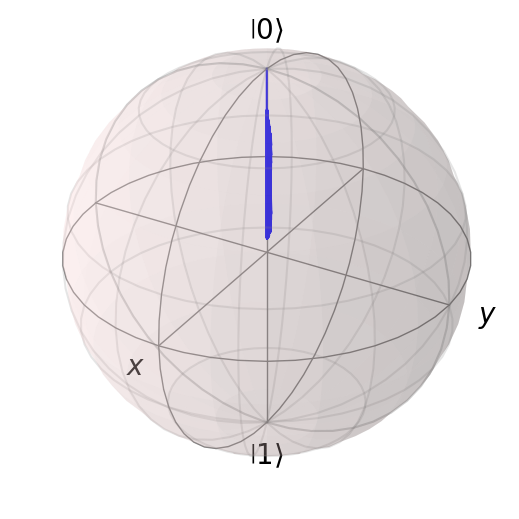

run end
26,run start


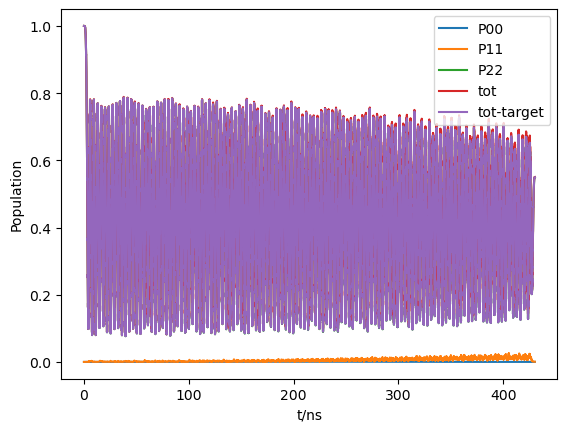

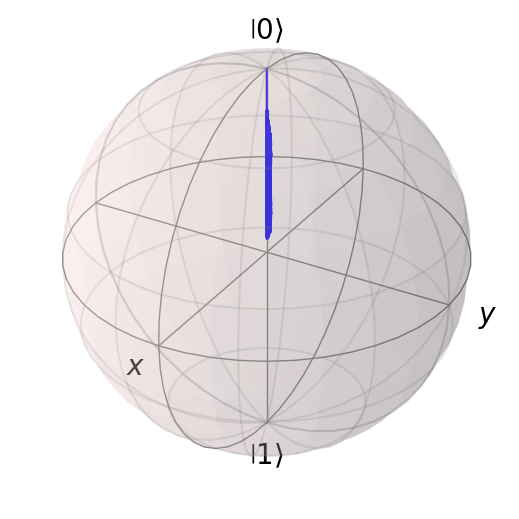

run end
27,run start


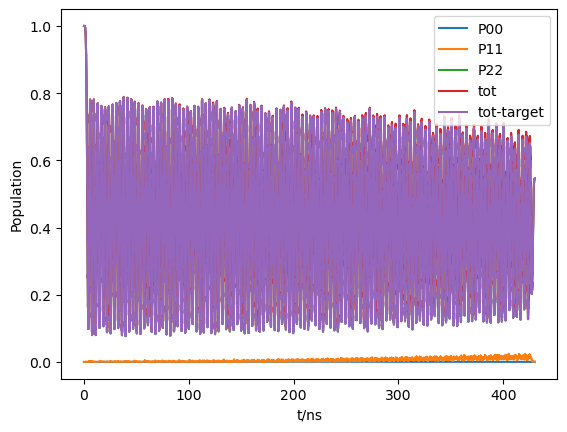

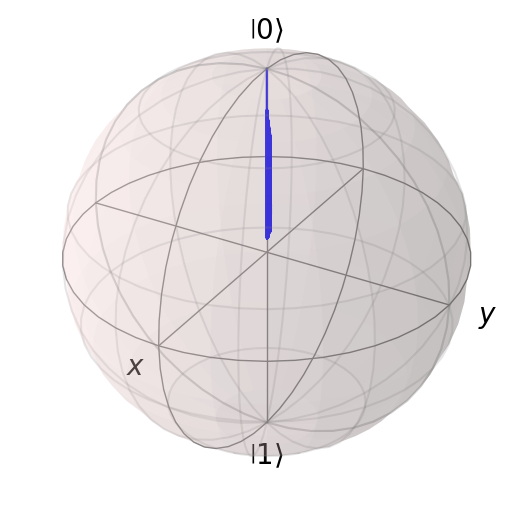

run end
28,run start


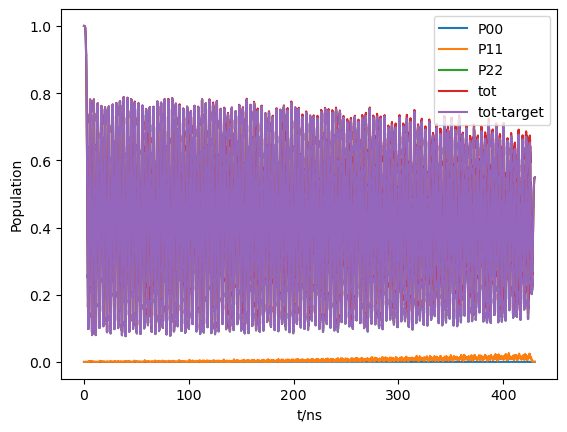

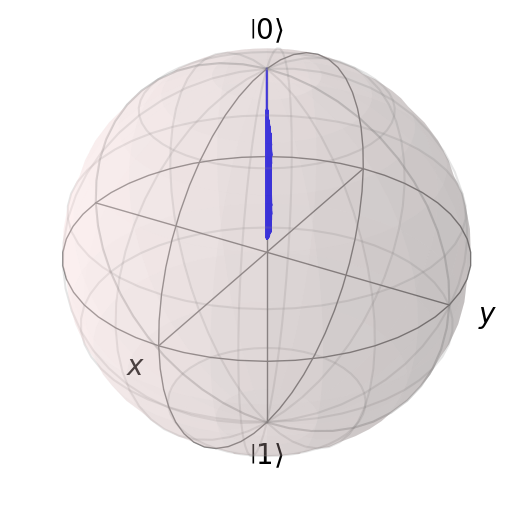

run end
29,run start


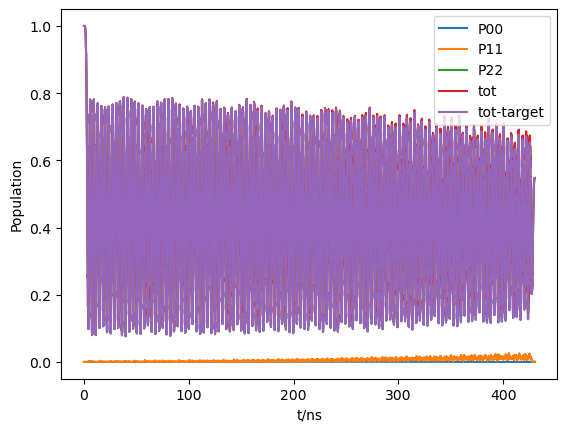

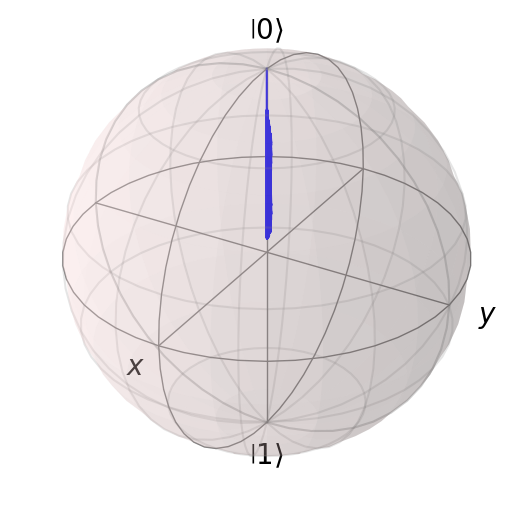

run end
30,run start


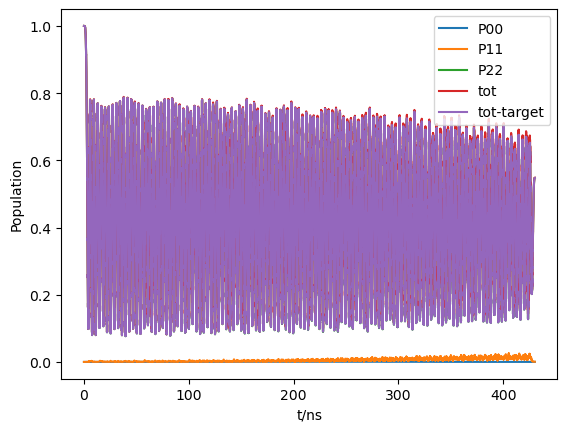

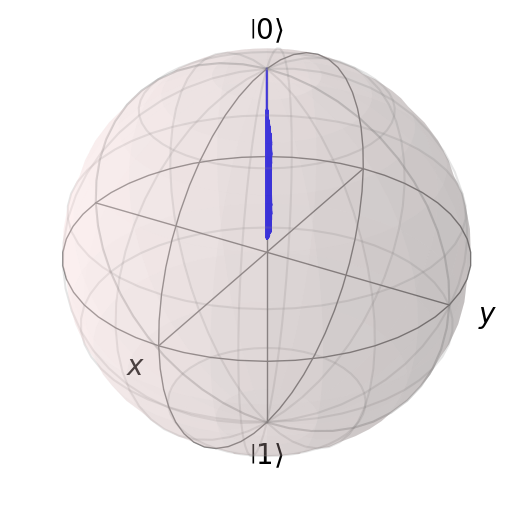

run end
31,run start


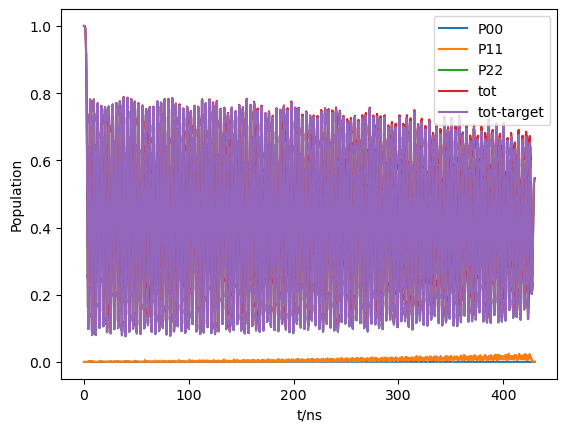

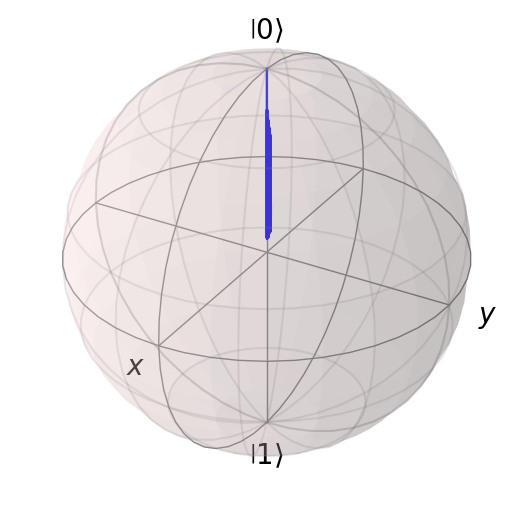

run end
32,run start


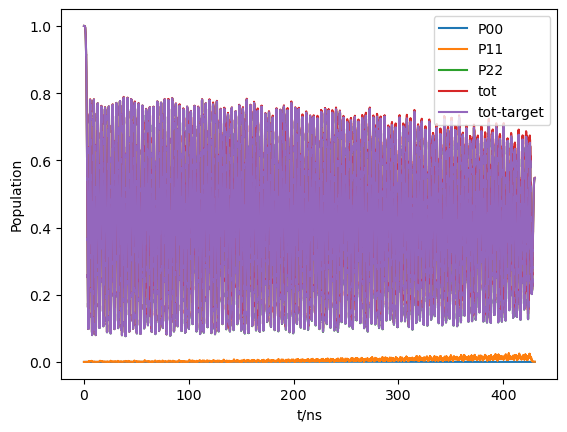

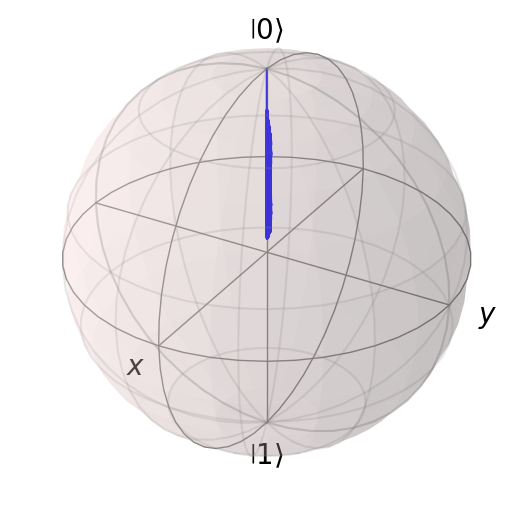

run end
33,run start


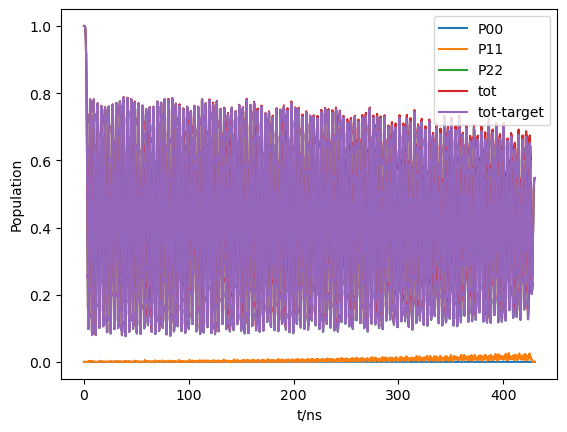

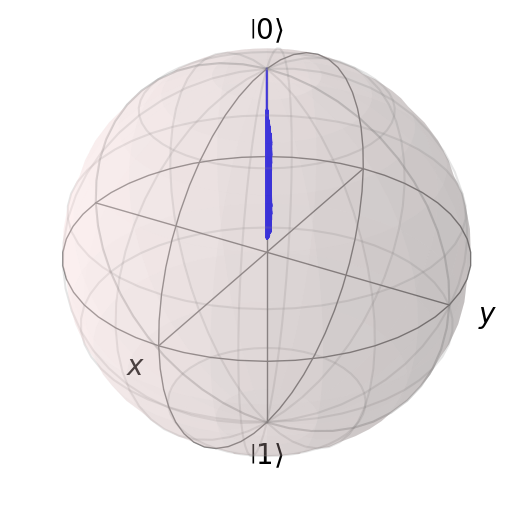

run end


[4.225607661794411, 0.025744626763926873]


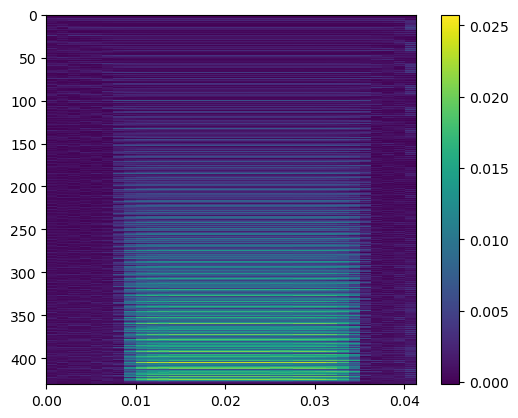

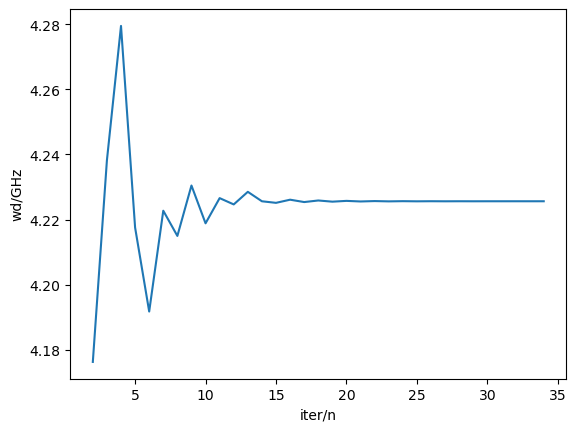

dpi=5.014116163640093e-07,w_match=4.225607661794411 
 auto_scan_scope end


In [174]:
# wd=[4.437674361533853,4.240367440173982]
wd=[4.437634021354223,4.240367440173982]
# wd=[4.433922724828316,4.240367440173982 ]
# wd=[4.4339,4.2500]
# 4.433922724828316
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],
L=200,wd=wd,sp_direct=[1,0.1],amp=0.2,
rho0=2,rho_tar=1)
# a.run(plot=True)
b=a.auto_scan_scope(sp=1,runplot=True)

run start


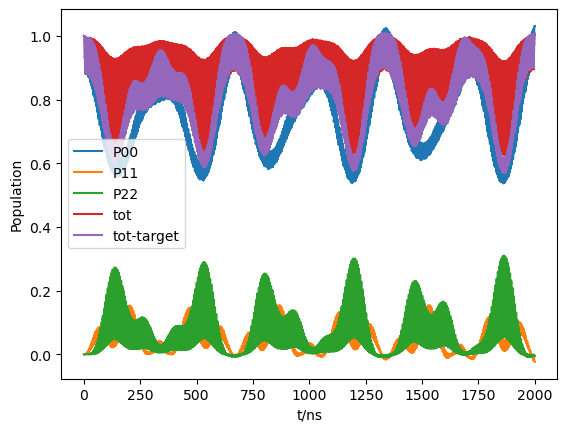

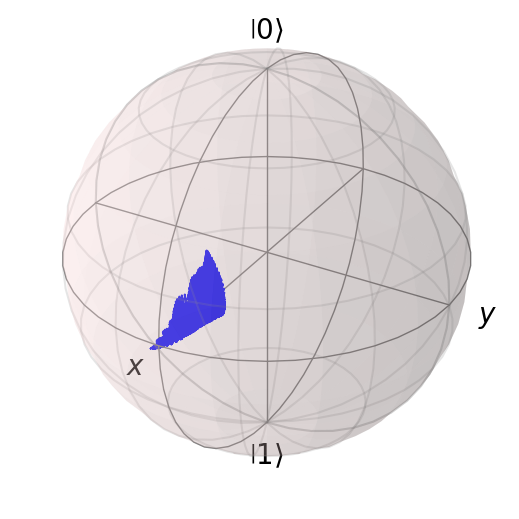

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [125]:
# wd=[4.437674361533853,4.240367440173982]
wd=[4.433922724828316,4.24900023861468 ]
# 4.433922724828316
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],

L=2000,wd=wd,sp_direct=[1,0],amp=0.2,
rho0=0,rho_tar=2)
a.run(plot=True)
# b=a.auto_scan_scope(sp=1,runplot=True)

run start


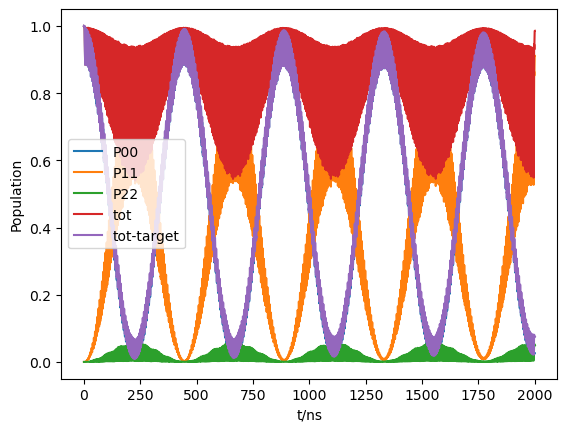

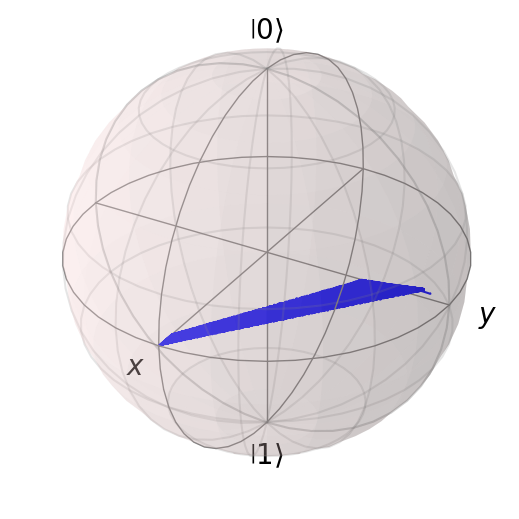

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [146]:
# wd=[4.437674361533853,4.240367440173982]
wd=[4.433922724828316,4.240367440173982 ]
# wd=[4.4339,4.2500]
# 4.433922724828316
a=sideband(level=4,Tstep=10000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],

L=2000,wd=wd,sp_direct=[1,0.85],amp=0.2,
rho0=0,rho_tar=1)
a.run(plot=True)
# b=a.auto_scan_scope(sp=1,runplot=True)

run start


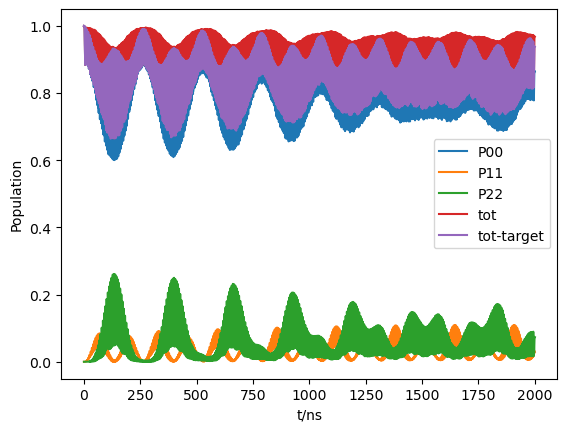

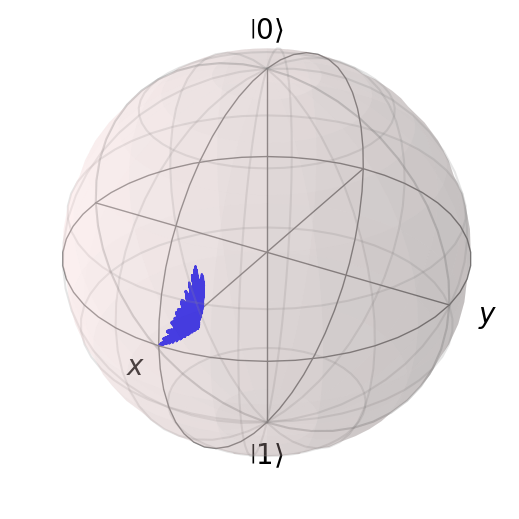

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [145]:
# wd=[4.437674361533853,4.240367440173982]
wd=[4.433922724828316,4.240367440173982 ]
# wd=[4.4339,4.2500]
# 4.433922724828316
a=sideband(level=4,Tstep=10000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],

L=2000,wd=wd,sp_direct=[1,0.85],amp=0.2,
rho0=0,rho_tar=1)
a.run(plot=True)
# b=a.auto_scan_scope(sp=1,runplot=True)

run start


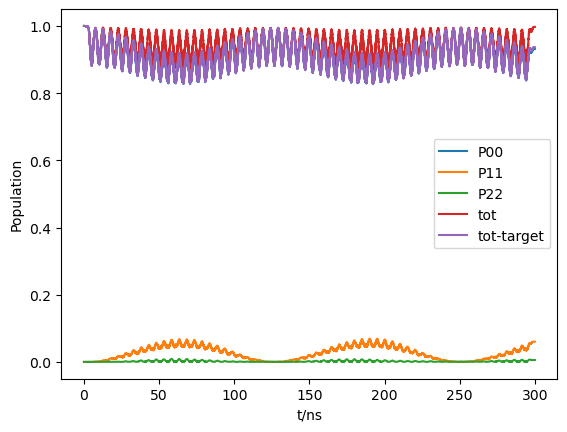

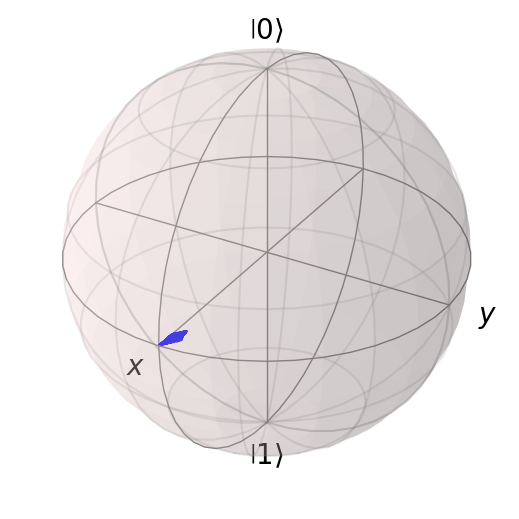

run end


Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [115]:
wd=[4.437674361533853,4.240367440173982]
# 4.244749961774963
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.1],

L=300,wd=wd,sp_direct=[1,0.85],amp=0.2,
rho0=0)
# a.run(plot=True)
b=a.auto_scan_scope(sp=0)


In [ ]:
# fix,ax=plt.subplots()
# ax.plot(amp_result_delat1G[0],amp_result_delat1G[1])
# ax[1].plot(amp_result_delat1G[0],amp_result_delat1G[2])
# ax[2].plot(amp_result_delat1G[0],amp_result_delat1G[3])

In [ ]:
stop

In [ ]:
stop

auto_scan_amp start 
 astart,astop,astep=(0.04, 0.3, 27)
auto_scan_amp ,sp=0 ,amp=0.04
amp=0.04
auto_scan_scope start 
 sp=0
T for scan:1060.5437780837385
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
iter_num=23
run start
run end
iter_num=24
run start
run end
j=2
iter_num=25
run start
run end
iter_num=26
run start
run end
iter_num=27
run start
run end
j=3


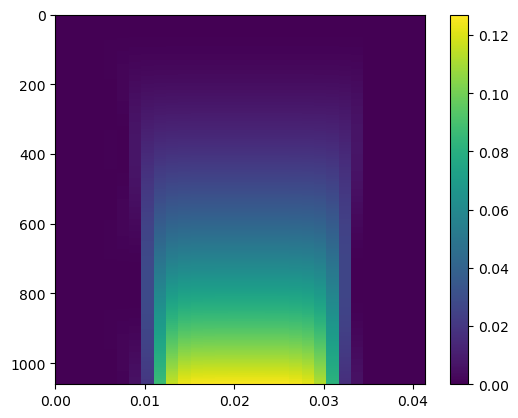

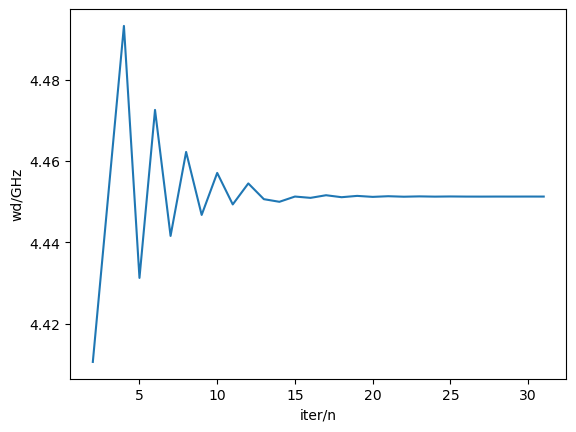

dpi=9.518879849291634e-07,w_match=4.451222358736274 
 auto_scan_scope end
run start


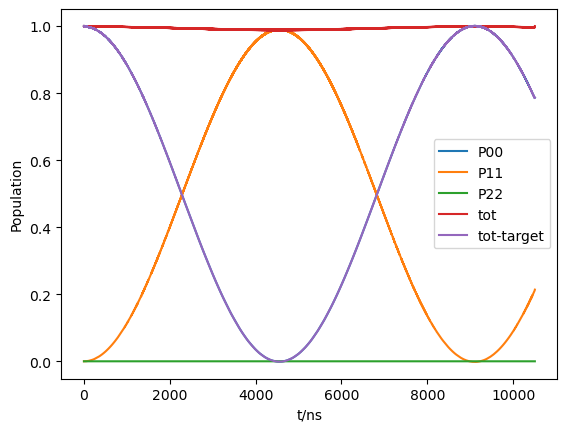

run end
wd_fit start 
 sp=0


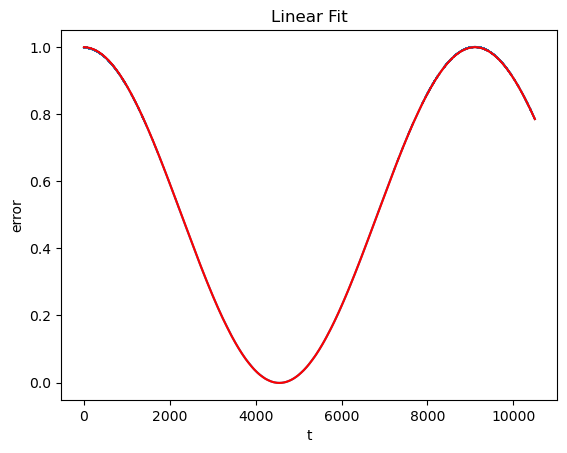

guess value of [d_eff,F,t0,c]=[9.518879849291633e-05, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.00010982104197746922, 1.0008336901083803, 2.2324627775592766e-12, -0.0011520429947082683, 9105.723110924035]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.05
amp=0.05
auto_scan_scope start 
 sp=0
T for scan:682.3480179735926
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
iter_num=21
run start
run end
j=3
iter_num=22
run start
run end
iter

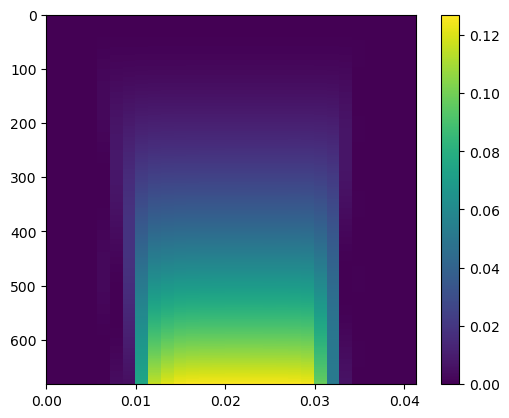

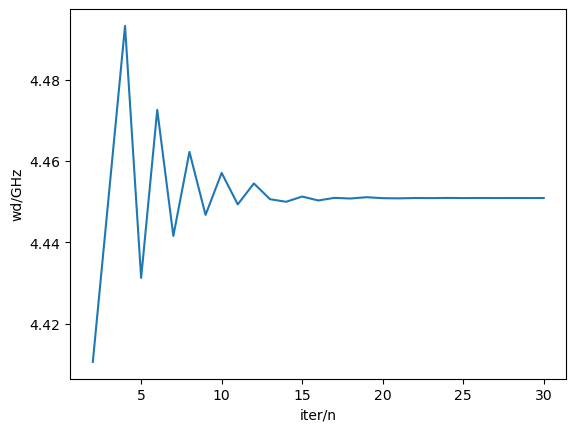

dpi=1.4873249764518179e-06,w_match=4.450865600272677 
 auto_scan_scope end
run start


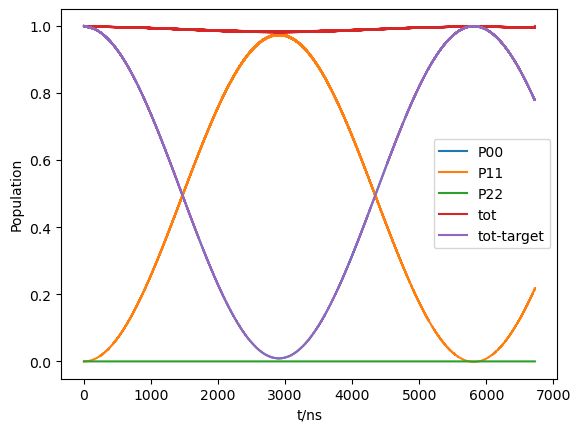

run end
wd_fit start 
 sp=0


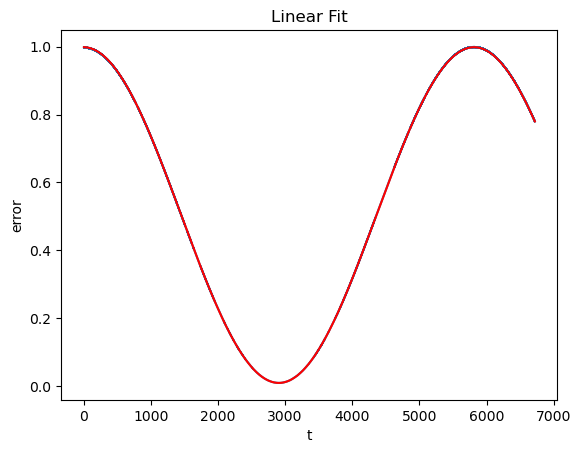

guess value of [d_eff,F,t0,c]=[0.0001487324976451818, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.00017203466447387938, 0.9898105636542273, 1.0083547509462495e-18, 0.008861035397782468, 5812.781994013965]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.06
amp=0.06
auto_scan_scope start 
 sp=0
T for scan:476.90834581499496
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_

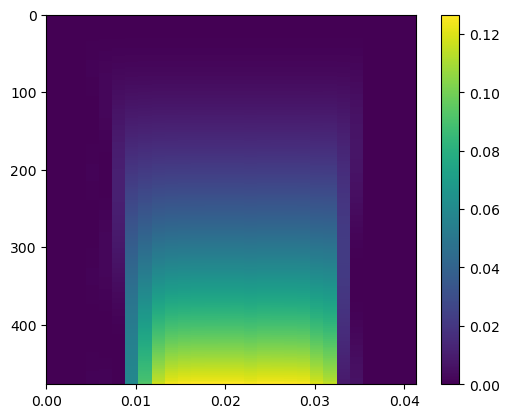

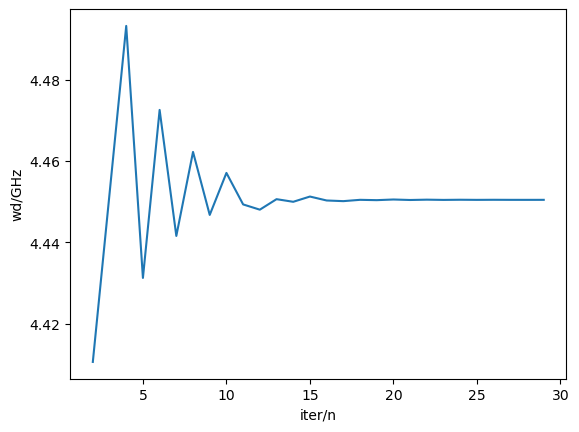

dpi=2.141747966090617e-06,w_match=4.450416815774299 
 auto_scan_scope end
run start


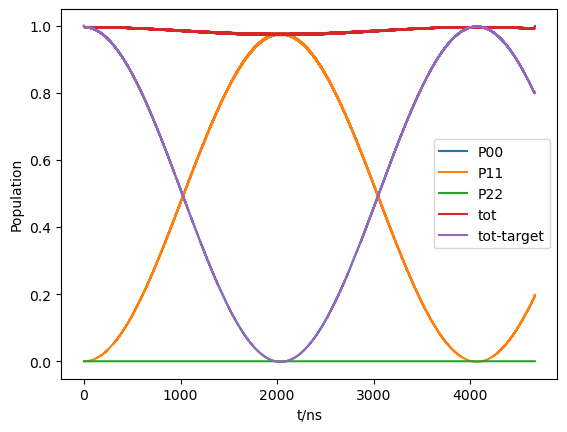

run end
wd_fit start 
 sp=0


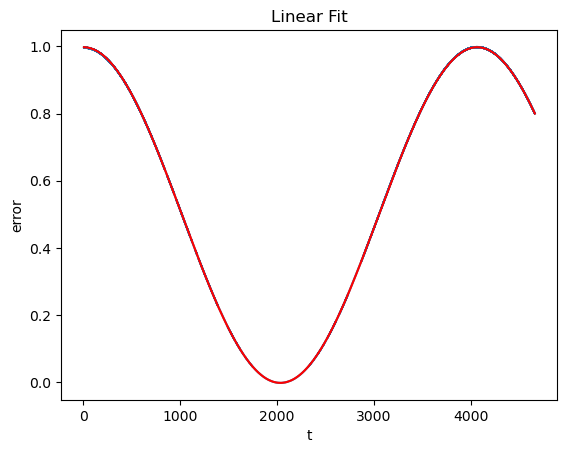

guess value of [d_eff,F,t0,c]=[0.00021417479660906173, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.00024596588461965255, 0.9994840239059611, 2.3359220139788204, -0.0018416302148763068, 4065.6044700928437]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.07
amp=0.07
auto_scan_scope start 
 sp=0
T for scan:353.0347030477514
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
iter_num=21
run start
run end
iter_num=22
run start
run end
iter_n

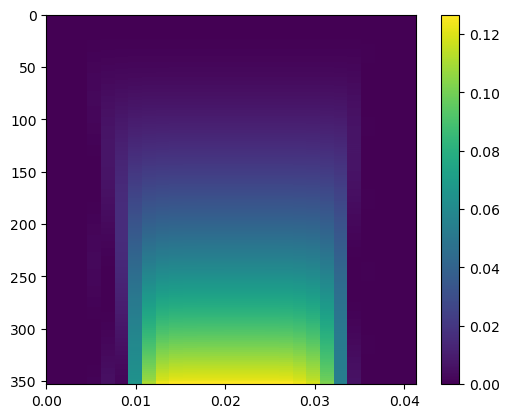

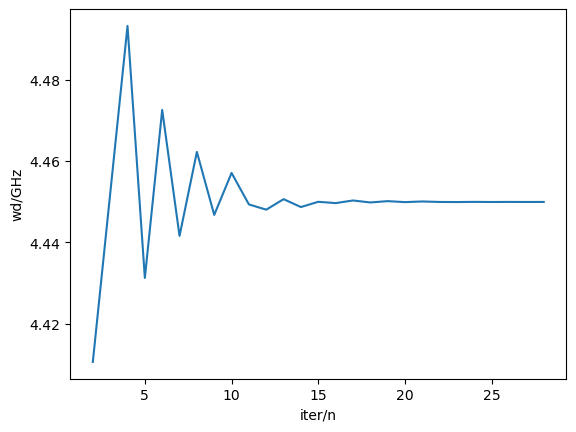

dpi=2.9151569538455626e-06,w_match=4.449897435961571 
 auto_scan_scope end
run start


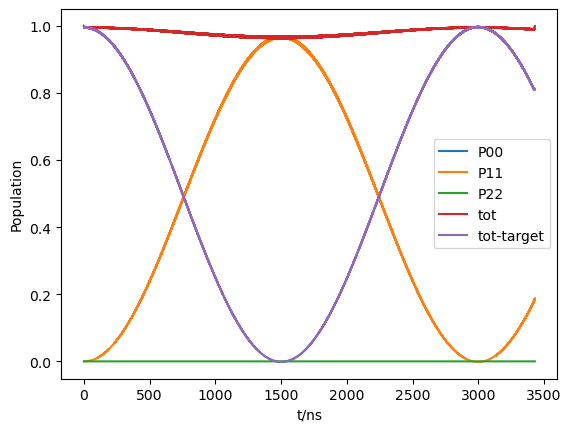

run end
wd_fit start 
 sp=0


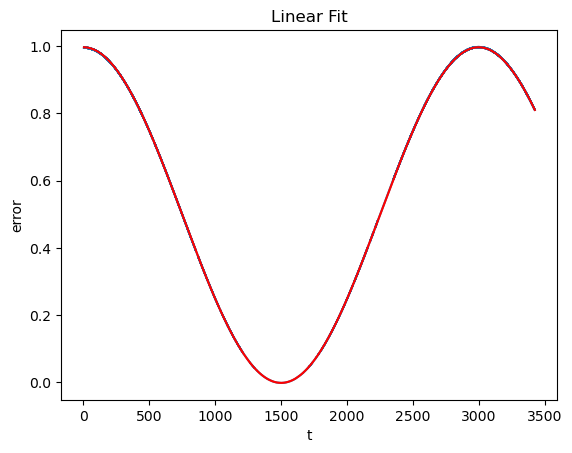

guess value of [d_eff,F,t0,c]=[0.00029151569538455626, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0003337191078076948, 0.9977900283034871, 2.6080552220208966, -0.0015447618509340638, 2996.532043278291]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.08
amp=0.08
auto_scan_scope start 
 sp=0
T for scan:272.63594452093463
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
iter_num=21
run start
run end
iter_num=22
run start
run end
j=3
ite

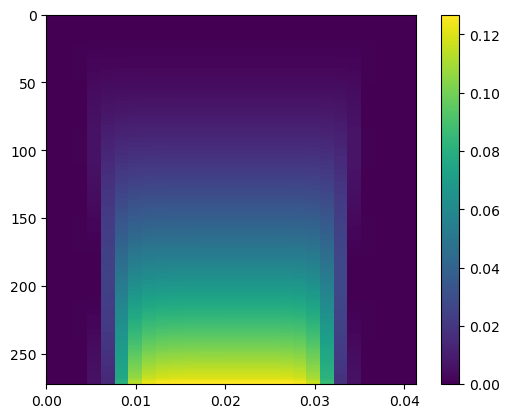

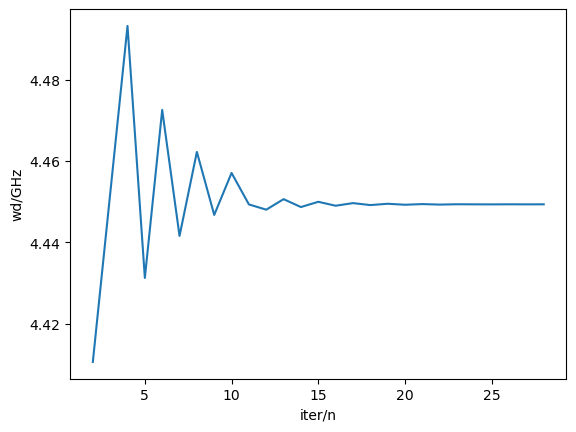

dpi=3.8075519397166534e-06,w_match=4.449312503356944 
 auto_scan_scope end
run start


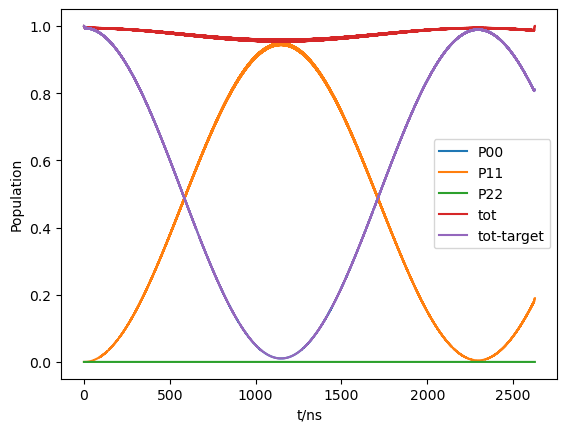

run end
wd_fit start 
 sp=0


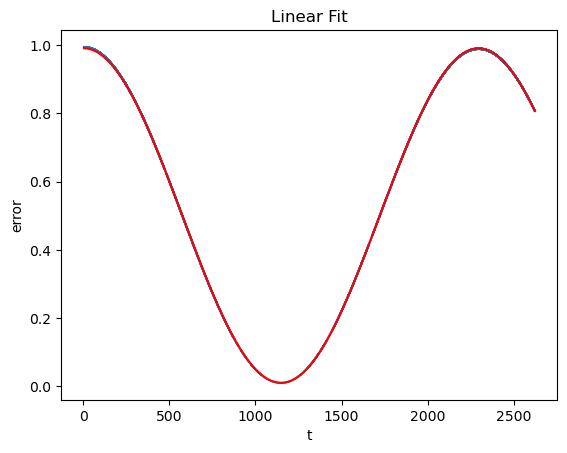

guess value of [d_eff,F,t0,c]=[0.0003807551939716653, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0004363784766300741, 0.9804333929702919, 3.014437821878527, 0.01005379271284081, 2291.5887321539876]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.09
amp=0.09
auto_scan_scope start 
 sp=0
T for scan:217.51482036222004
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=23

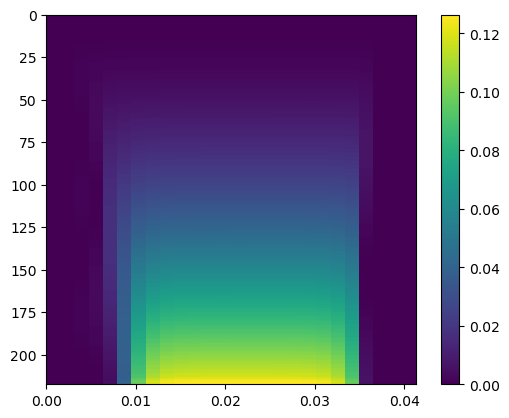

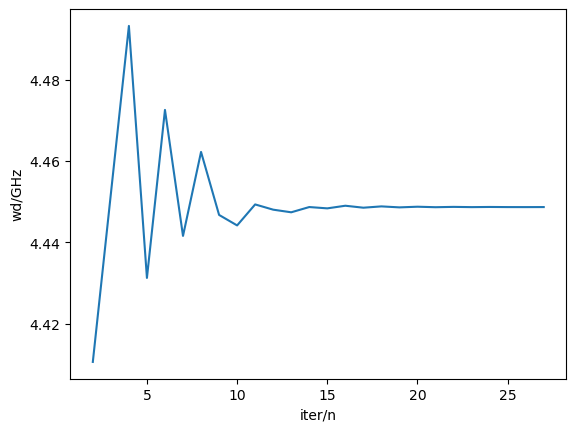

dpi=4.8189329237038884e-06,w_match=4.448641847870604 
 auto_scan_scope end
run start


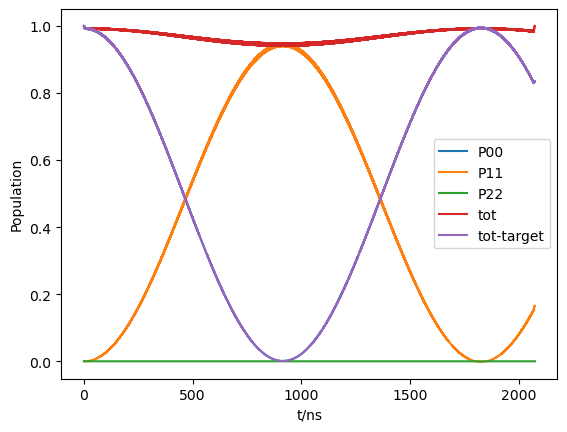

run end
wd_fit start 
 sp=0


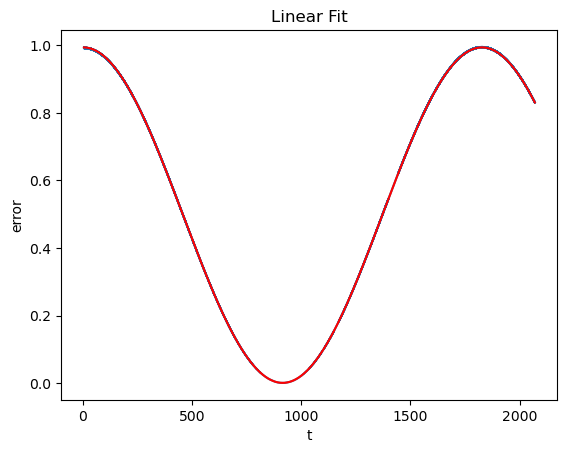

guess value of [d_eff,F,t0,c]=[0.0004818932923703888, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0005478799830646533, 0.9926475398209778, 2.4984233251371966, 0.0008851196239319264, 1825.2172572656186]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.1
amp=0.1
auto_scan_scope start 
 sp=0
T for scan:178.08700449339815
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=2

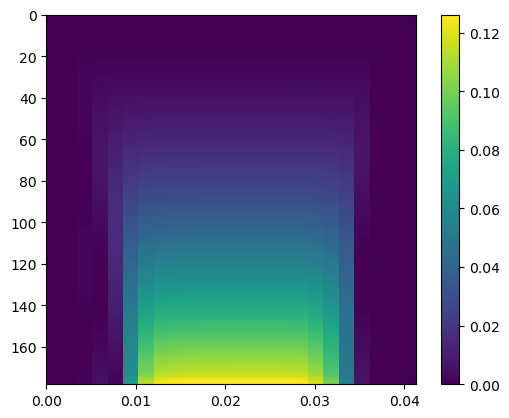

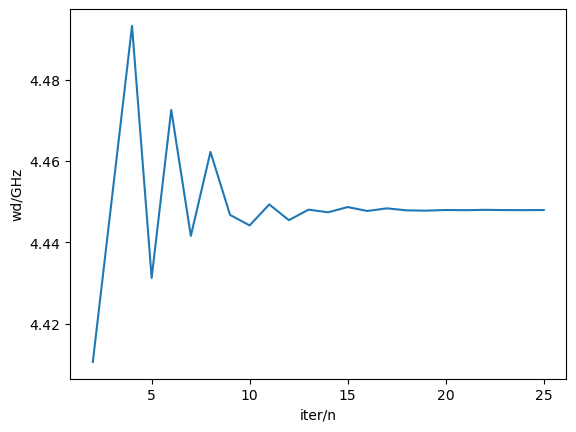

dpi=5.9492999058072714e-06,w_match=4.447900597069913 
 auto_scan_scope end
run start


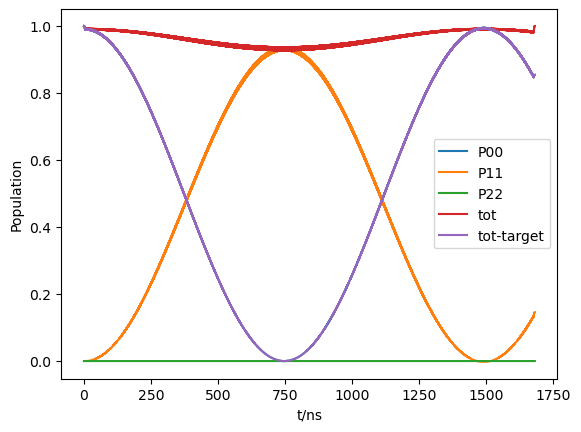

run end
wd_fit start 
 sp=0


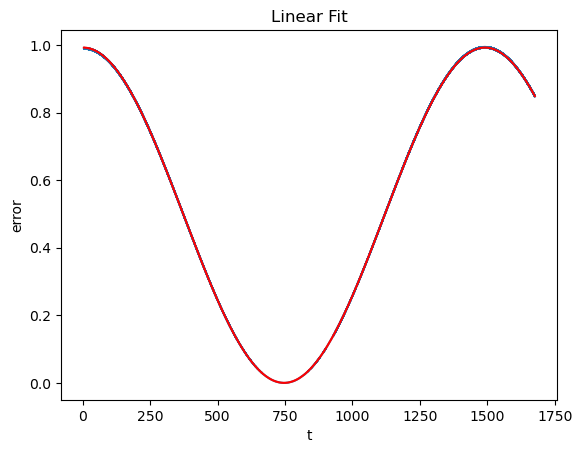

guess value of [d_eff,F,t0,c]=[0.0005949299905807272, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0006716760942994213, 0.9923177413193546, 2.0968589377056044, 2.6400702721574474e-05, 1488.8128496563966]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.11000000000000001
amp=0.11000000000000001
auto_scan_scope start 
 sp=0
T for scan:148.91487974661004
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
iter_num=20
run start
run end
iter_num=21
run start
run end
iter_num=22

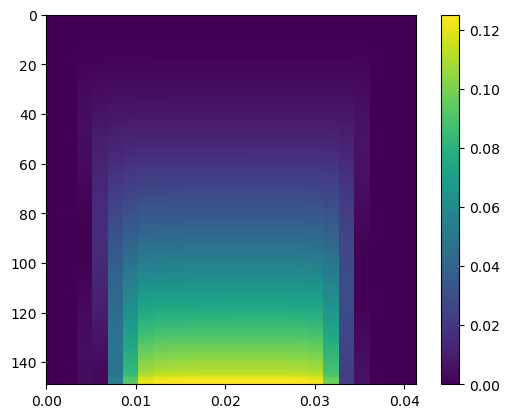

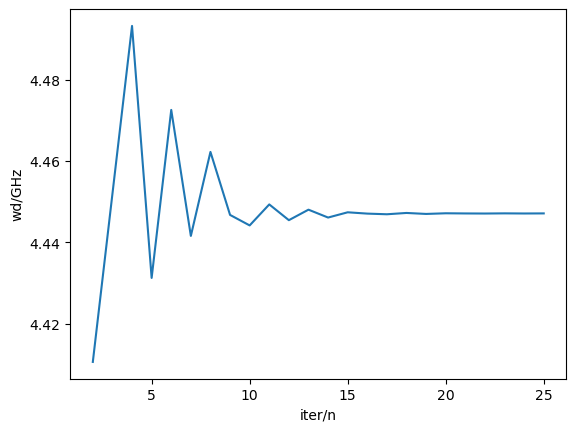

dpi=7.198652886026799e-06,w_match=4.447073623387511 
 auto_scan_scope end
run start


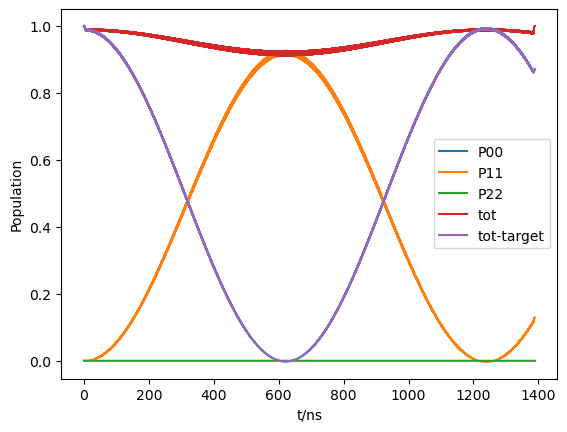

run end
wd_fit start 
 sp=0


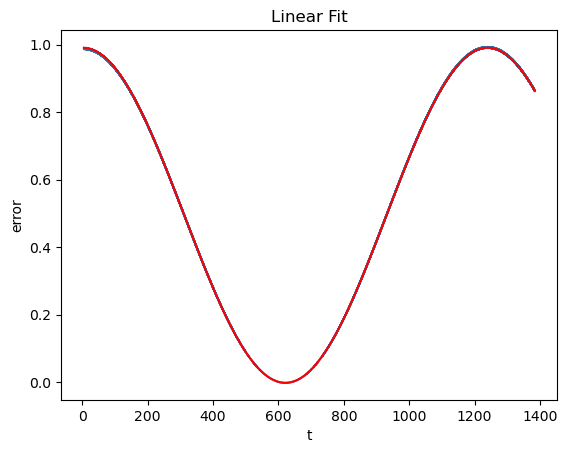

guess value of [d_eff,F,t0,c]=[0.0007198652886026799, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0008082191795174246, 0.9927437103326736, 2.31932311949949, -0.0018275711494318443, 1237.2881333960484]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.12
amp=0.12
auto_scan_scope start 
 sp=0
T for scan:126.72708645374874
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=

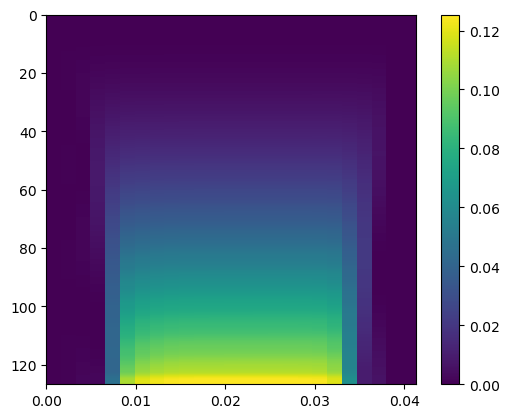

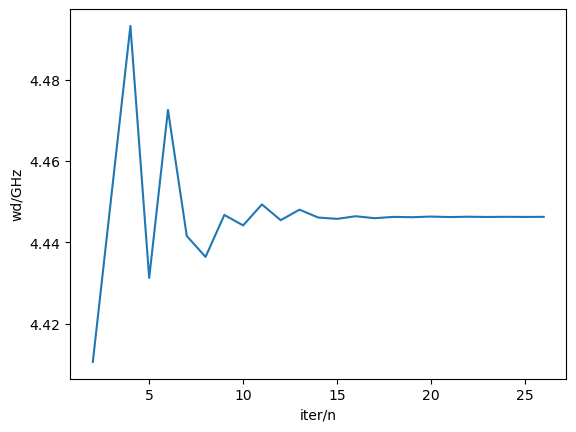

dpi=8.566991864362469e-06,w_match=4.446226479615293 
 auto_scan_scope end
run start


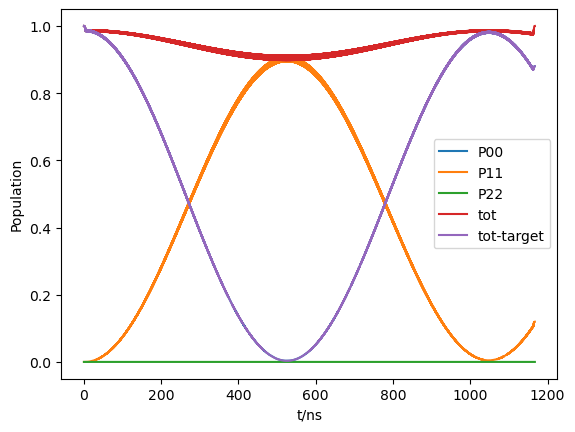

run end
wd_fit start 
 sp=0


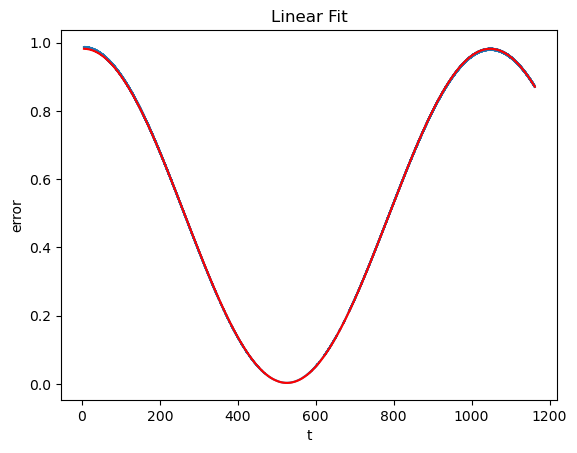

guess value of [d_eff,F,t0,c]=[0.0008566991864362469, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0009578227382088692, 0.9793612817283908, 3.941783873606845, 0.0030186081888548774, 1044.03451714876]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.13
amp=0.13
auto_scan_scope start 
 sp=0
T for scan:109.45976597242495
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
iter_num=23

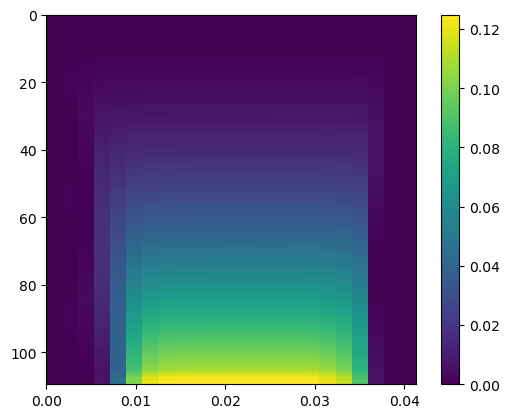

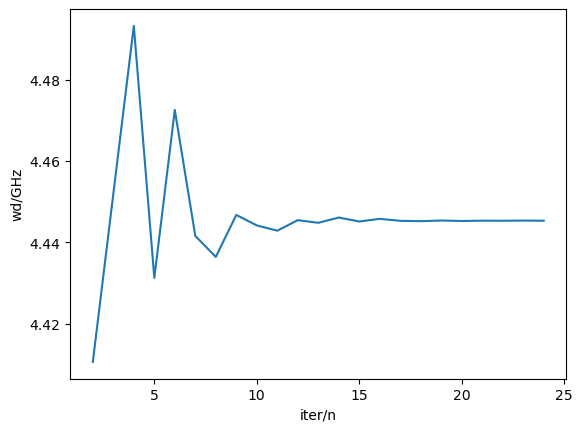

dpi=1.0054316840814289e-05,w_match=4.445288570438908 
 auto_scan_scope end
run start


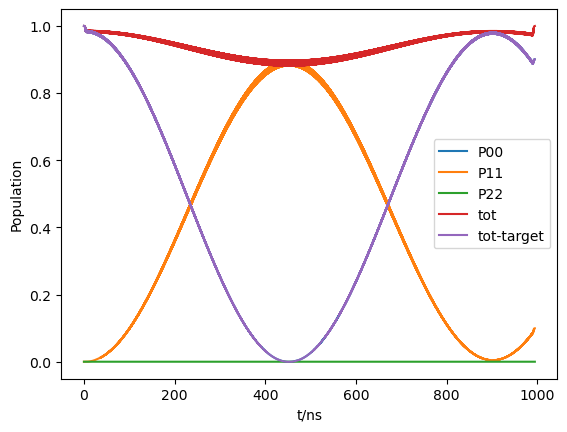

run end
wd_fit start 
 sp=0


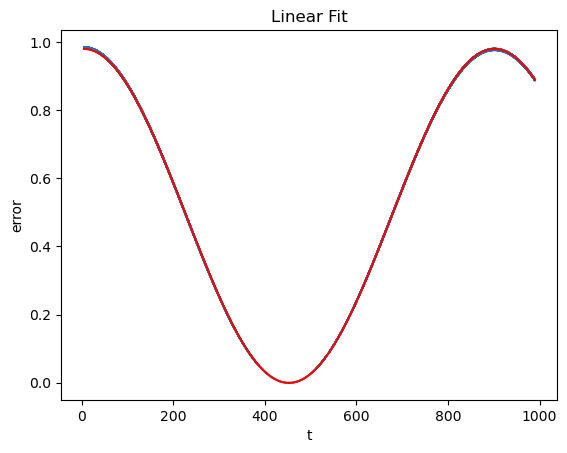

guess value of [d_eff,F,t0,c]=[0.0010054316840814289, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0011147999991139375, 0.980447179262071, 4.216066195383206, -0.0005721946335005932, 897.0218880470196]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.14
amp=0.14
auto_scan_scope start 
 sp=0
T for scan:95.75867576193785
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
iter_num=21
run start
run end
iter_num=22
run start
run end
j=3
[4.44431032

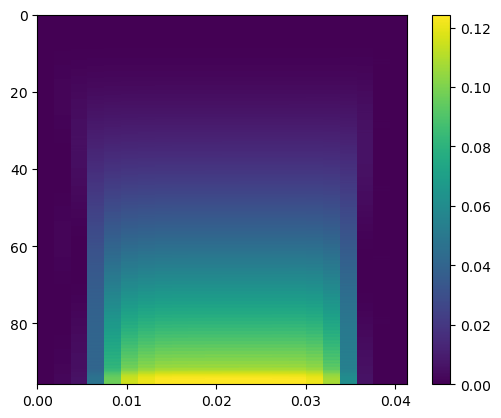

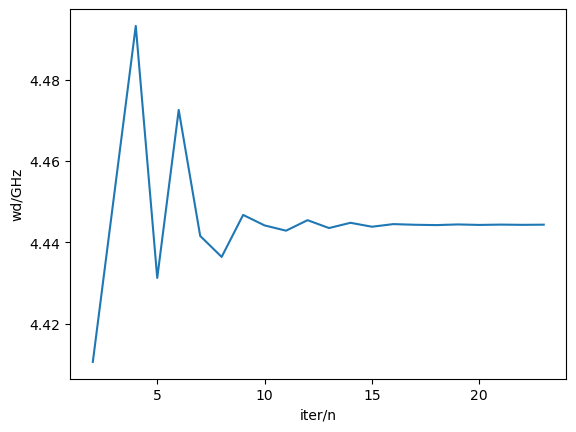

dpi=1.166062781538225e-05,w_match=4.444310321082893 
 auto_scan_scope end
run start


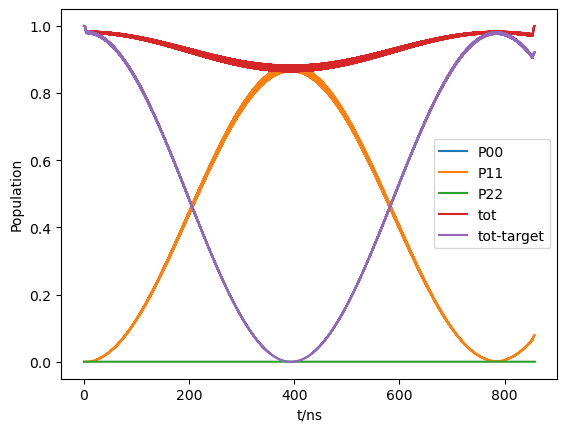

run end
wd_fit start 
 sp=0


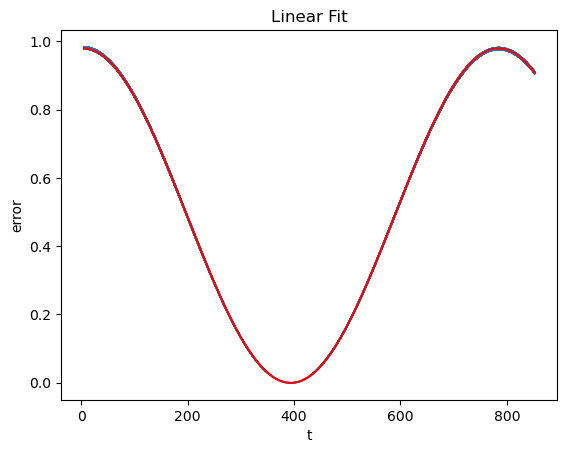

guess value of [d_eff,F,t0,c]=[0.001166062781538225, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0012803928417942255, 0.9797569235881709, 3.441572154506268, -0.00045843598960644555, 781.0103019622411]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.15
amp=0.15
auto_scan_scope start 
 sp=0
T for scan:84.70533533039918
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.443281646502344, 0.12369386939038017]


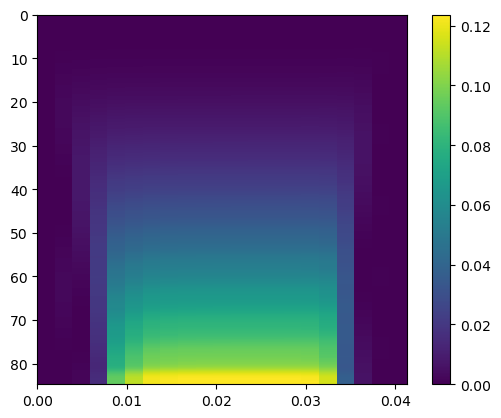

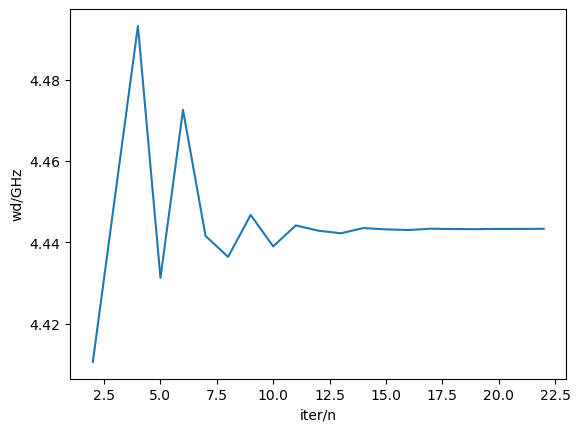

dpi=1.3385924788066361e-05,w_match=4.443281646502344 
 auto_scan_scope end
run start


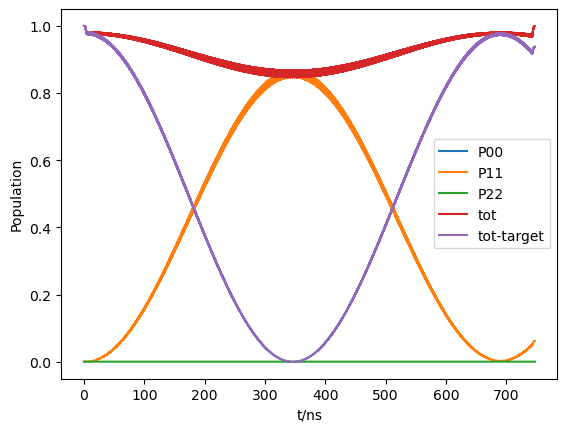

run end
wd_fit start 
 sp=0


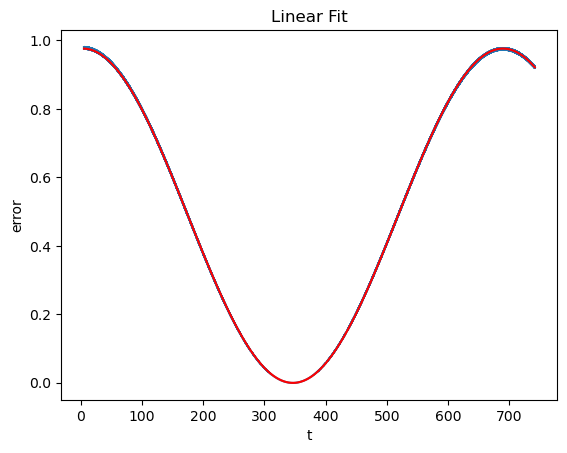

guess value of [d_eff,F,t0,c]=[0.001338592478806636, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.001456922739837931, 0.9766830404002885, 3.484071646216895, -0.0005026841663946317, 686.3781947086917]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.16
amp=0.16
auto_scan_scope start 
 sp=0
T for scan:75.65898613023366
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=23


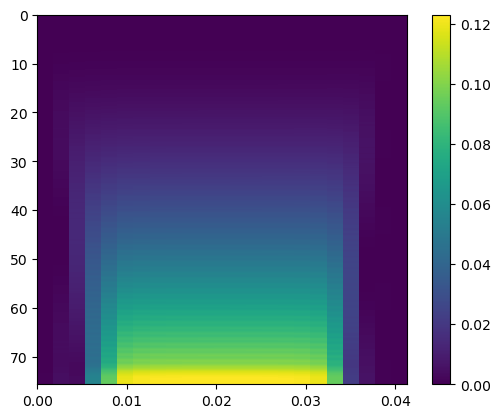

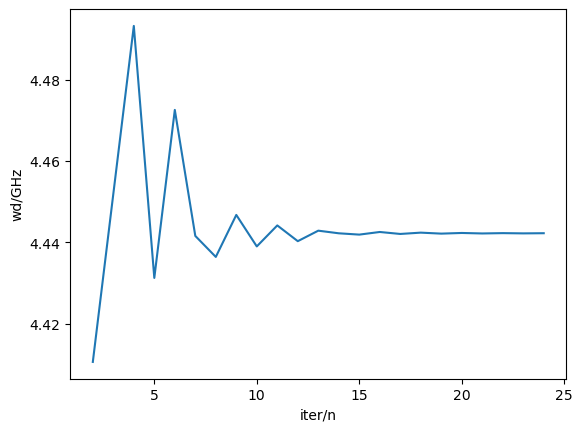

dpi=1.5230207758866614e-05,w_match=4.442212631742164 
 auto_scan_scope end
run start


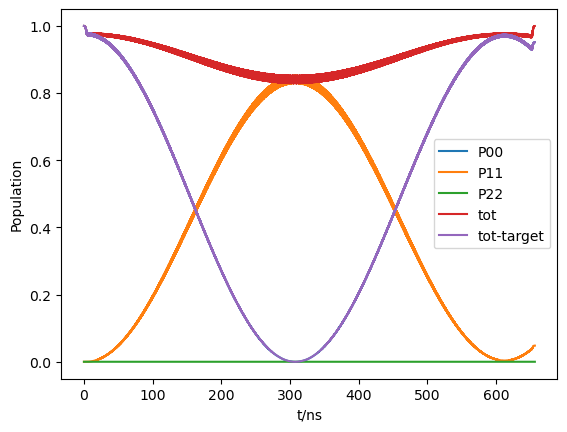

run end
wd_fit start 
 sp=0


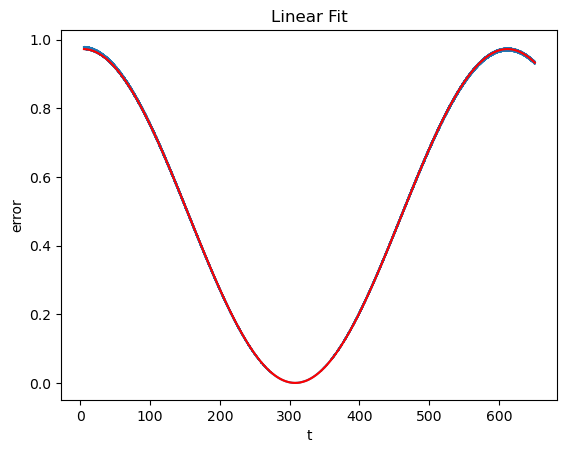

guess value of [d_eff,F,t0,c]=[0.0015230207758866613, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0016435312286508864, 0.9724434889228186, 3.758917461758959, -0.0002774604213364273, 608.4459988149192]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.17
amp=0.17
auto_scan_scope start 
 sp=0
T for scan:68.16159325031077
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
[4.4411032

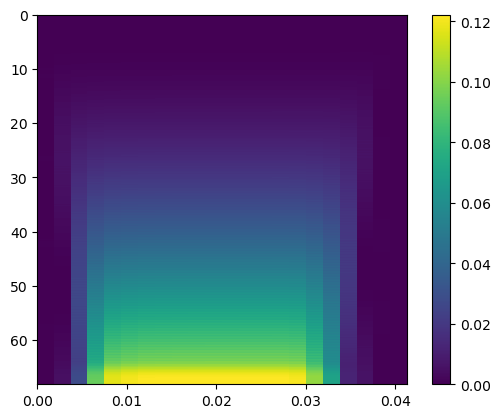

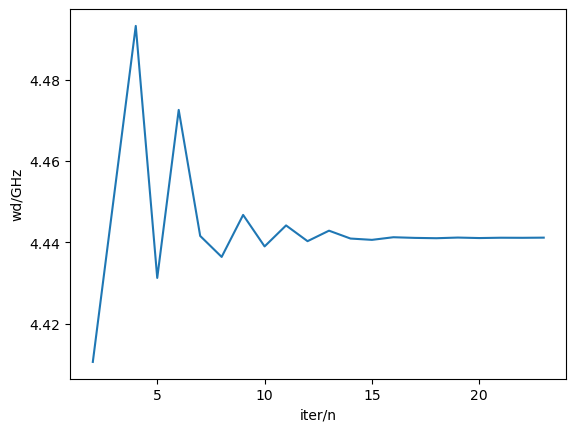

dpi=1.7193476727783016e-05,w_match=4.441103276802355 
 auto_scan_scope end
run start


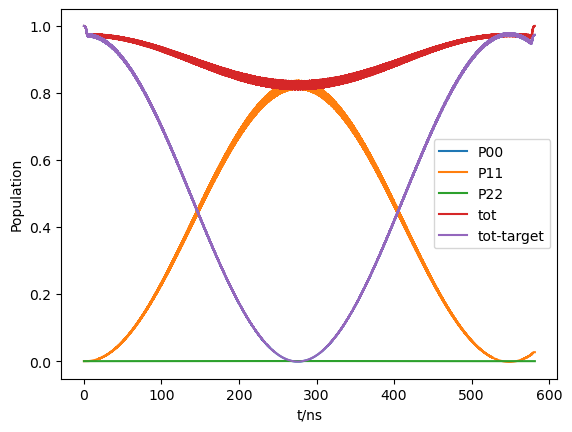

run end
wd_fit start 
 sp=0


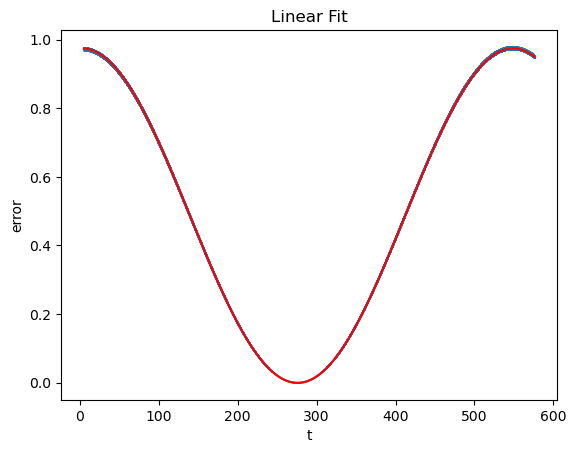

guess value of [d_eff,F,t0,c]=[0.0017193476727783014, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0018317845357721007, 0.9755012378931004, 2.772487403063166, -0.0010980730356420292, 545.9157343407194]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.18000000000000002
amp=0.18000000000000002
auto_scan_scope start 
 sp=0
T for scan:61.878705090554995
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=3
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22
r

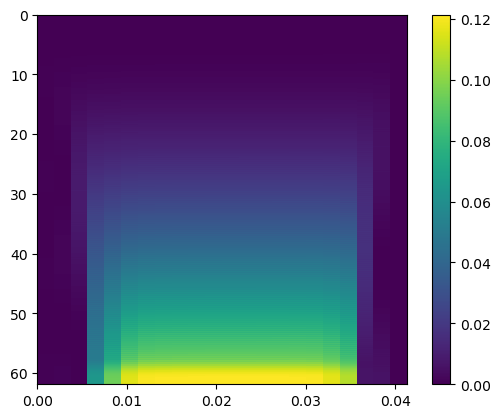

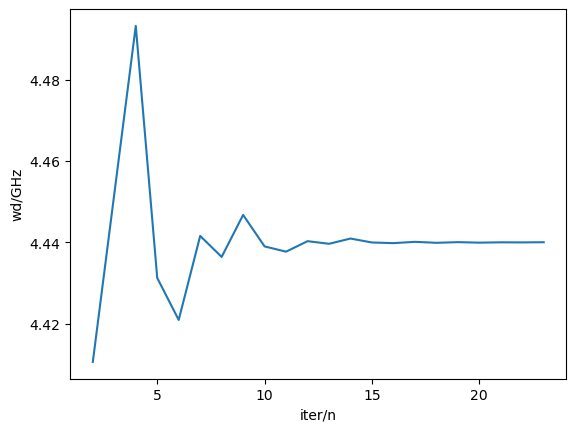

dpi=1.9275731694815557e-05,w_match=4.4399737517727305 
 auto_scan_scope end
run start


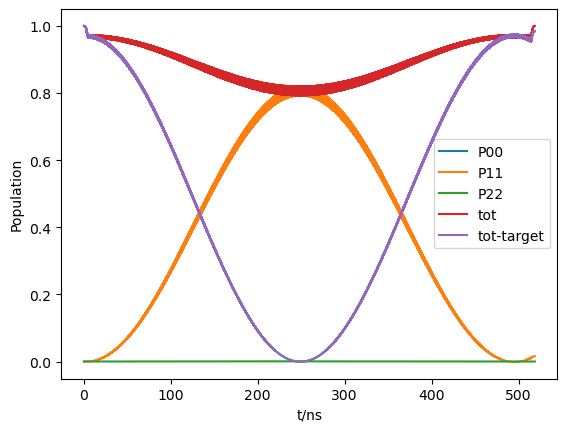

run end
wd_fit start 
 sp=0


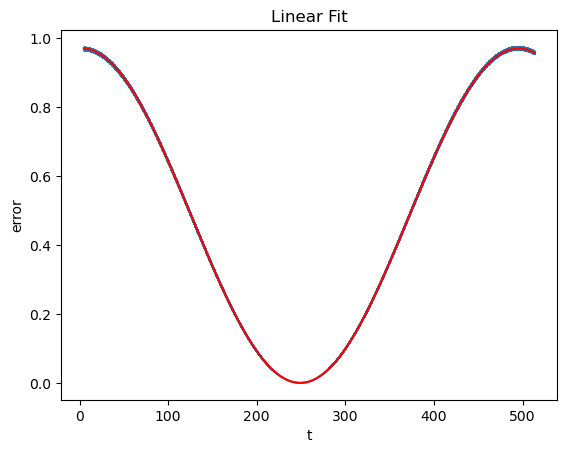

guess value of [d_eff,F,t0,c]=[0.0019275731694815557, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.002031589398179896, 0.9704367385819542, 2.922532785441283, -0.000217327231624184, 492.2254471774176]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.19
amp=0.19
auto_scan_scope start 
 sp=0
T for scan:56.56149708958399
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=3
iter_num=7
run start
run end
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
[4.4388442267431065, 0.12048707528597959]


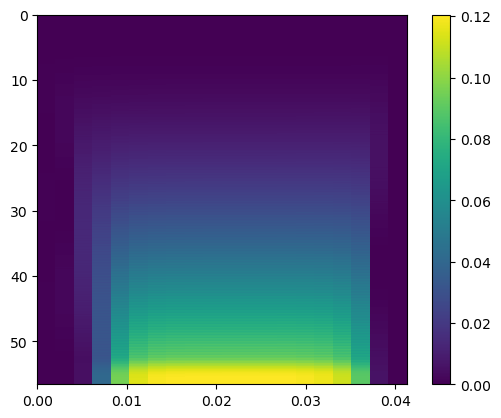

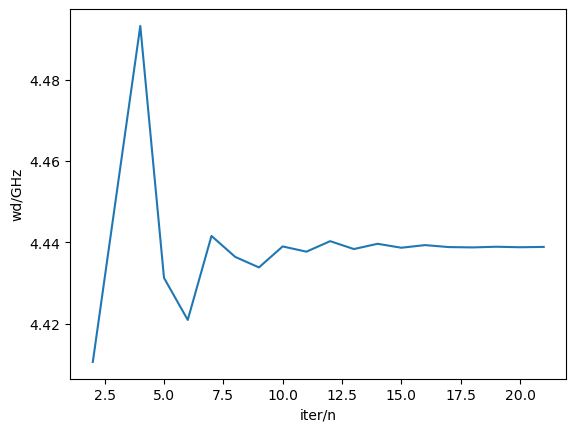

dpi=2.1476972659964245e-05,w_match=4.4388442267431065 
 auto_scan_scope end
run start


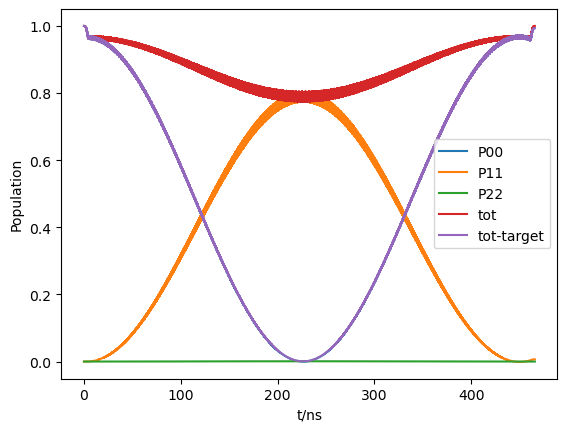

run end
wd_fit start 
 sp=0


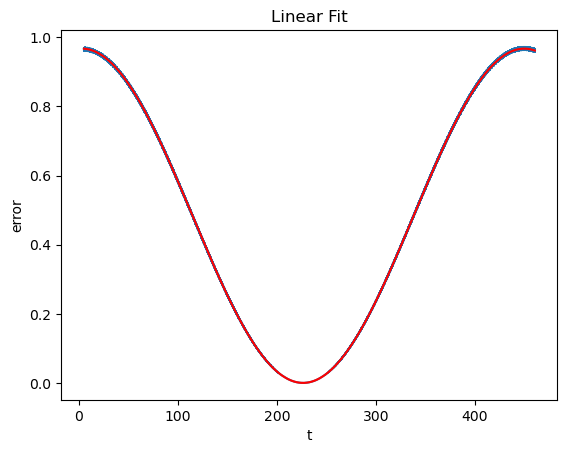

guess value of [d_eff,F,t0,c]=[0.0021476972659964246, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0022377111348083046, 0.9659341576334068, 2.9593360722565816, 0.0006975366752963072, 446.8852053532217]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.2
amp=0.2
auto_scan_scope start 
 sp=0
T for scan:52.02175112334954
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=3
iter_num=7
run start
run end
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.437674361533853, 0.11949952548758278]


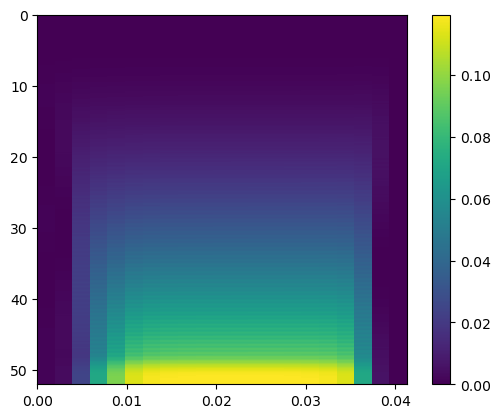

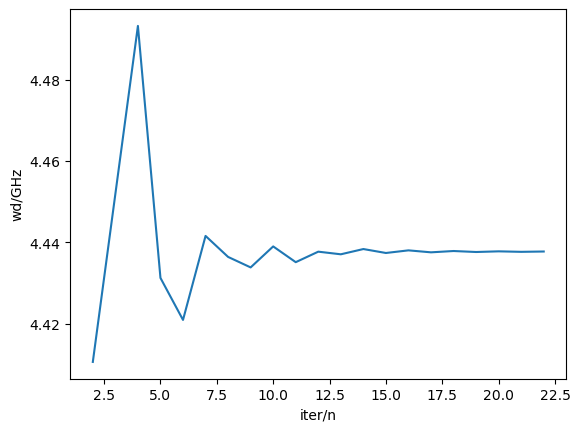

dpi=2.3797199623229086e-05,w_match=4.437674361533853 
 auto_scan_scope end
run start


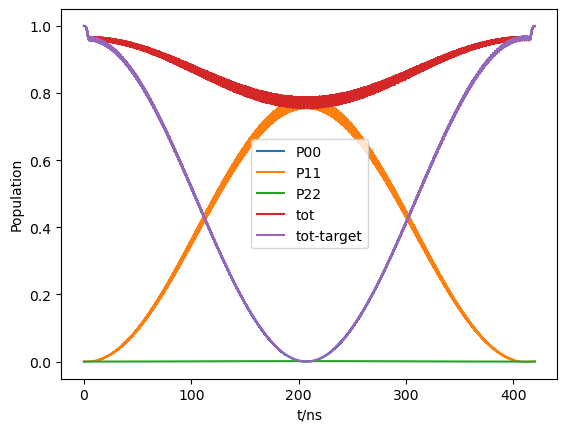

run end
wd_fit start 
 sp=0


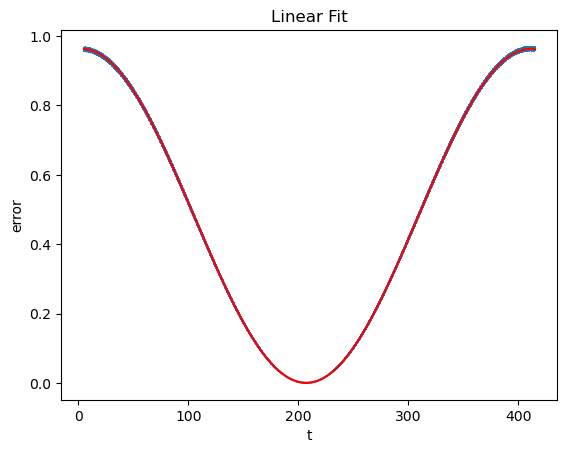

guess value of [d_eff,F,t0,c]=[0.0023797199623229086, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0024486875240554776, 0.9621889159759787, 2.984770693096488, 0.0007274973307024226, 408.38203738785575]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.21000000000000002
amp=0.21000000000000002
auto_scan_scope start 
 sp=0
T for scan:48.11496700530571
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=3
iter_num=7
run start
run end
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
[4.4365044963246, 0.11806144628746863]


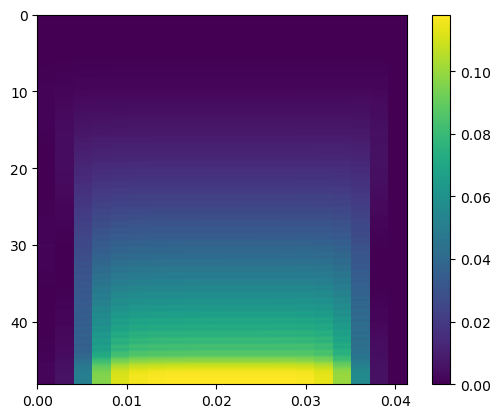

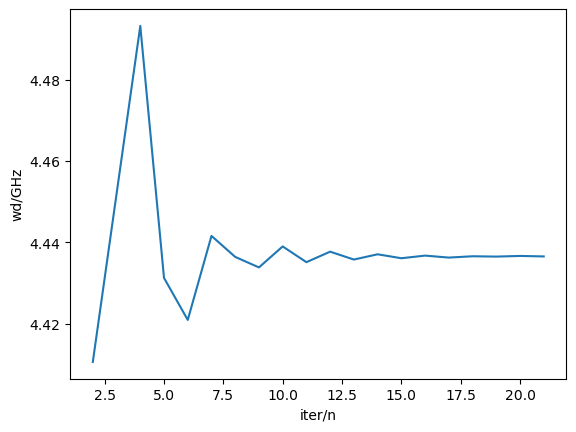

dpi=2.6236412584610066e-05,w_match=4.4365044963246 
 auto_scan_scope end
run start


c:\Users\1163080609\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


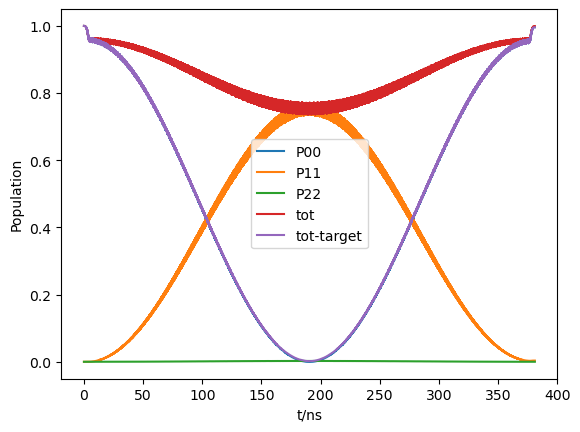

run end
wd_fit start 
 sp=0


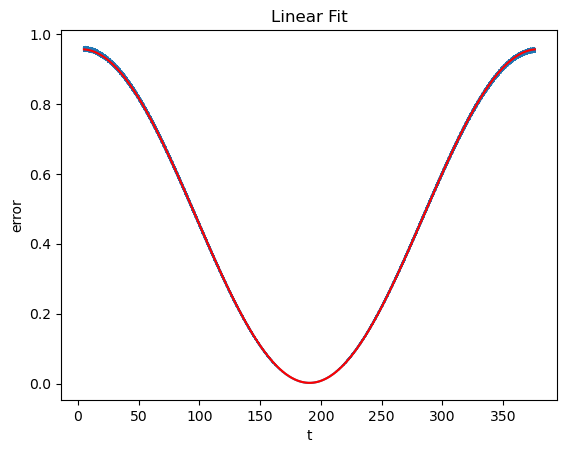

guess value of [d_eff,F,t0,c]=[0.0026236412584610064, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0026671429637852486, 0.9542575297244577, 3.2598951197340624, 0.002063357975773586, 374.9330326788277]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.22
amp=0.22
auto_scan_scope start 
 sp=0
T for scan:44.72871993665252
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=2
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
[4.435455651654235, 0.11710998342647636]


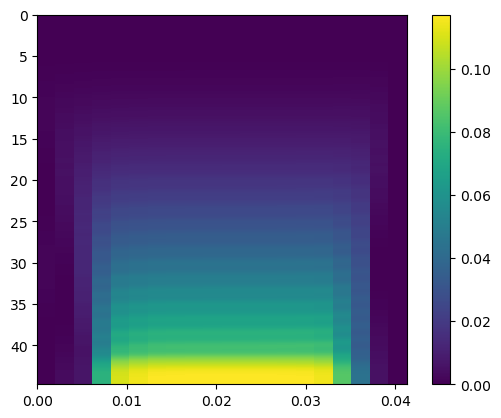

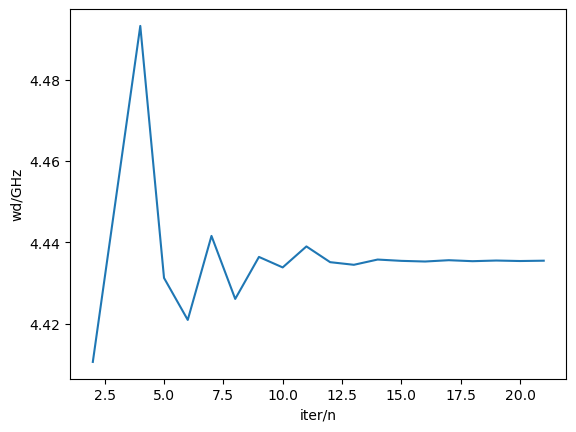

dpi=2.879461154410719e-05,w_match=4.435455651654235 
 auto_scan_scope end
run start


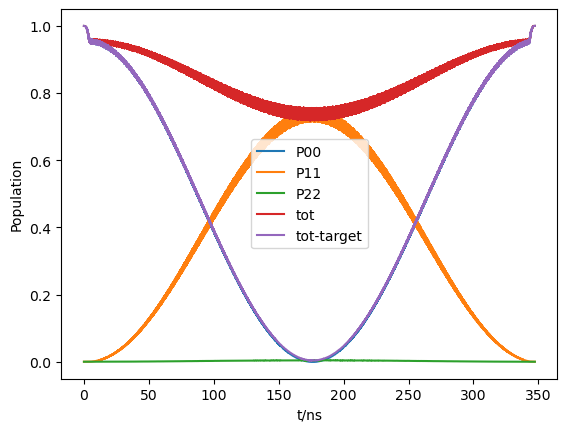

run end
wd_fit start 
 sp=0


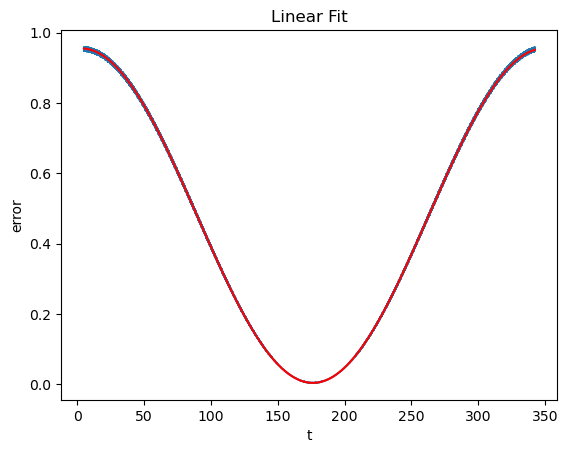

guess value of [d_eff,F,t0,c]=[0.002879461154410719, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.002886578242294406, 0.9518769772373654, 3.0161519190862323, 0.00351736575580075, 346.43093519791336]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.23
amp=0.23
auto_scan_scope start 
 sp=0
T for scan:41.77448100064237
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=2
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
[4.434406806983869, 0.11517920238630477]


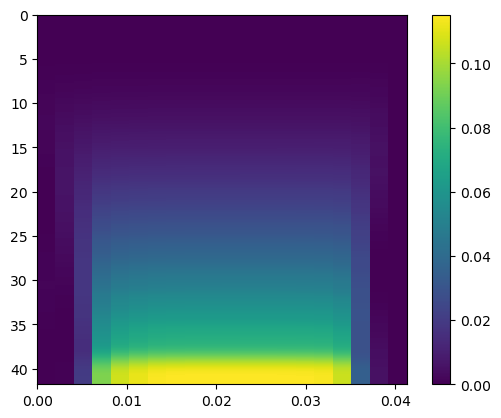

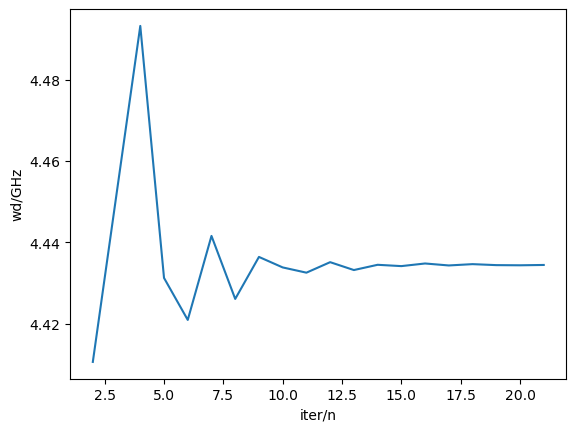

dpi=3.1471796501720466e-05,w_match=4.434406806983869 
 auto_scan_scope end
run start


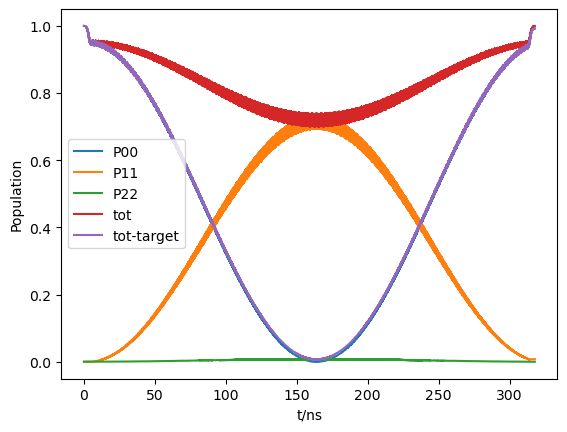

run end
wd_fit start 
 sp=0


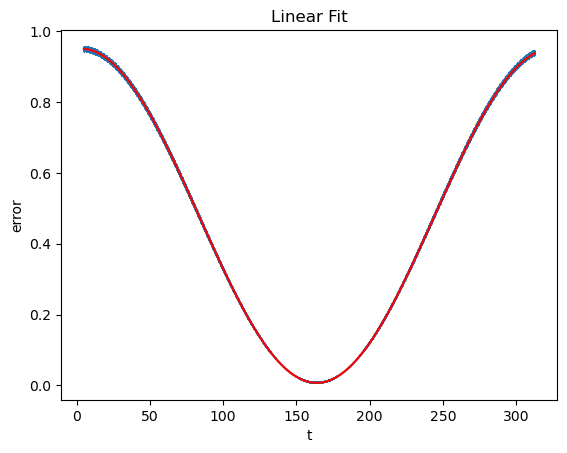

guess value of [d_eff,F,t0,c]=[0.003147179650172047, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.00310941755858425, 0.9439309760501248, 3.0520027412805097, 0.006935145895303506, 321.6036383531938]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.24000000000000002
amp=0.24000000000000002
auto_scan_scope start 
 sp=0
T for scan:39.18177161343718
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=2
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
[4.43360000339128, 0.11201600416589108]


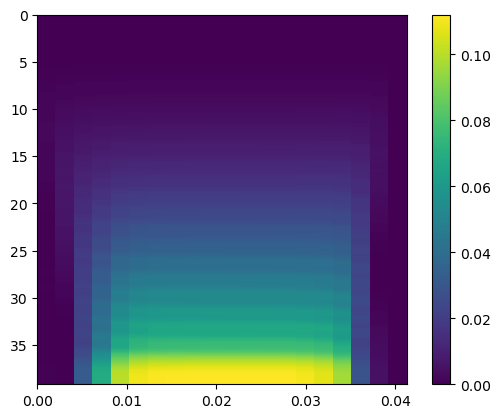

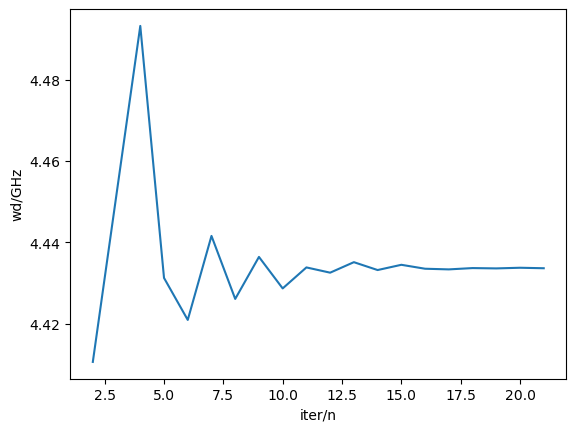

dpi=3.426796745744988e-05,w_match=4.43360000339128 
 auto_scan_scope end
run start


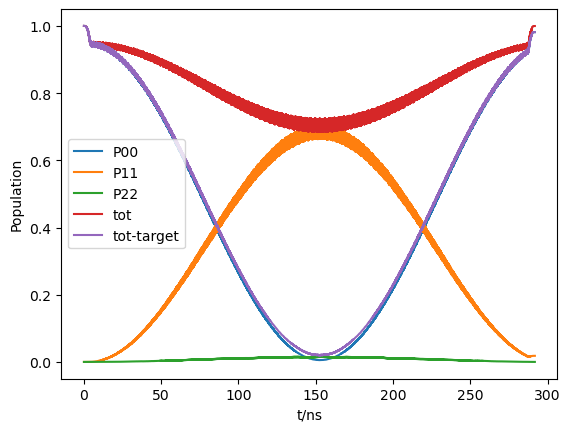

run end
wd_fit start 
 sp=0


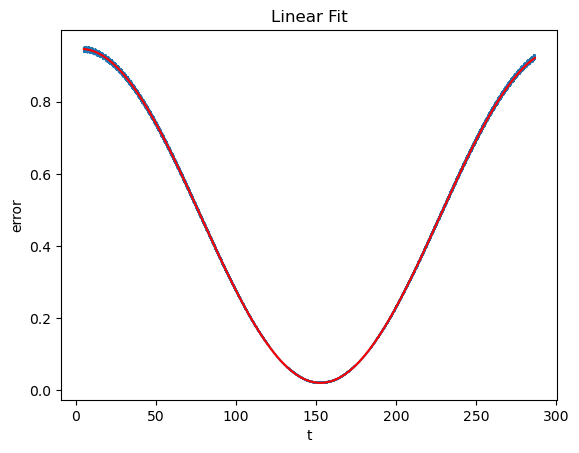

guess value of [d_eff,F,t0,c]=[0.003426796745744988, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0033396650509092476, 0.9264473501932109, 3.0809327905282045, 0.020019417605909907, 299.43122581342186]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.25
amp=0.25
auto_scan_scope start 
 sp=0
T for scan:36.893920718943704
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=2
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
[4.432994900696839, 0.106383678975748]


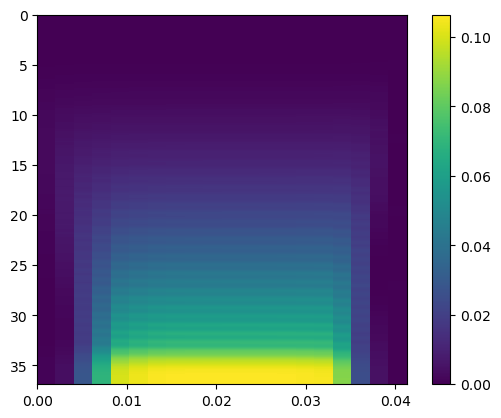

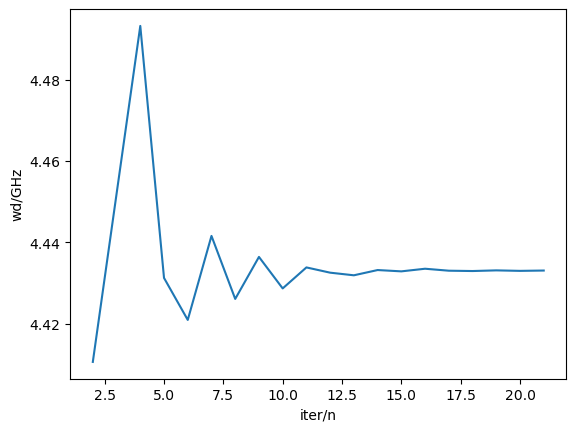

dpi=3.718312441129544e-05,w_match=4.432994900696839 
 auto_scan_scope end
run start


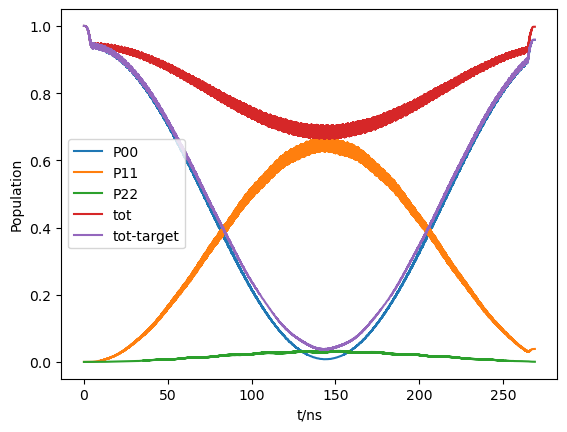

run end
wd_fit start 
 sp=0


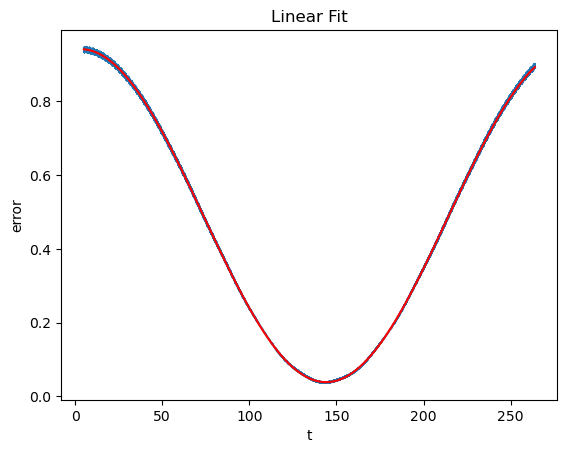

guess value of [d_eff,F,t0,c]=[0.003718312441129544, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0035490547802775724, 0.9032859547070248, 3.152747993528482, 0.03841777499011313, 281.7651633773288]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.26
amp=0.26
auto_scan_scope start 
 sp=0
T for scan:34.86494149310624
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
j=2
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.4338017042894275, 0.09400610380693257]


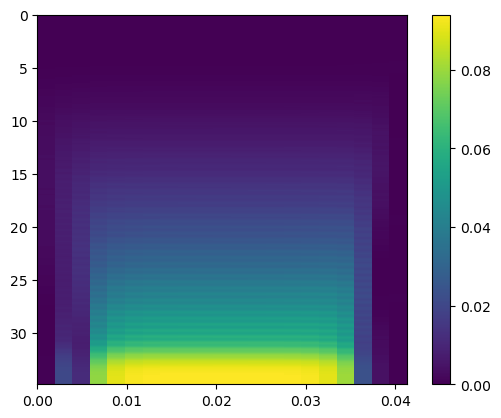

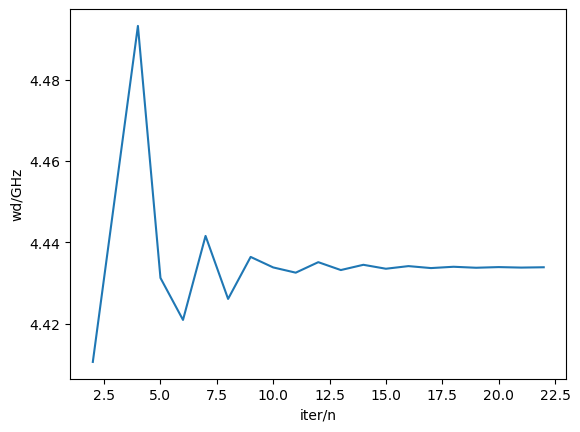

dpi=4.0217267363257156e-05,w_match=4.4338017042894275 
 auto_scan_scope end
run start


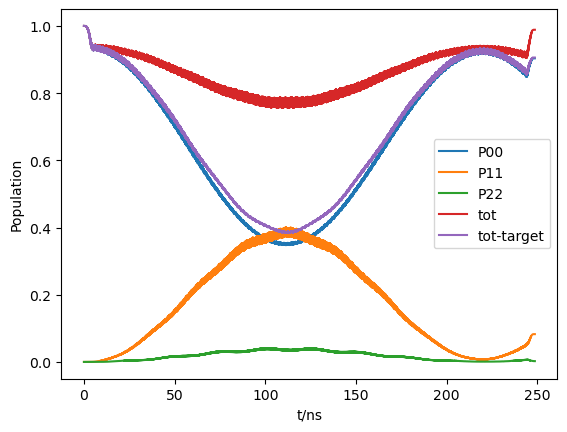

run end
wd_fit start 
 sp=0


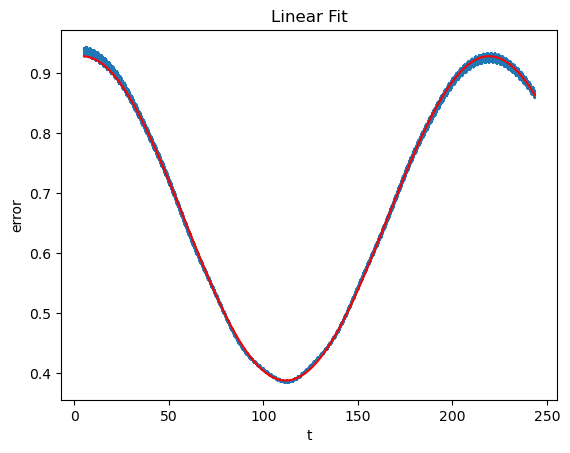

guess value of [d_eff,F,t0,c]=[0.0040217267363257155, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.004643919772075828, 0.539621882099268, 4.131459585109572, 0.3880248255655699, 215.33533072923888]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.27
amp=0.27
auto_scan_scope start 
 sp=0
T for scan:33.05720226246889
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
[4.420650805730235, 0.04554880736751102]


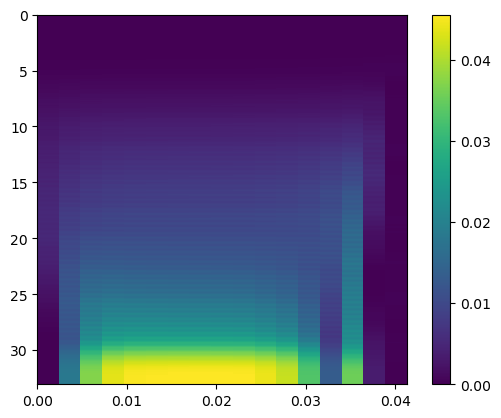

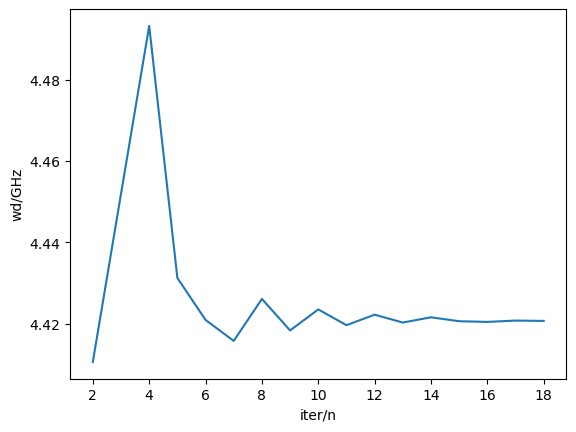

dpi=4.3370396313334993e-05,w_match=4.420650805730235 
 auto_scan_scope end
run start


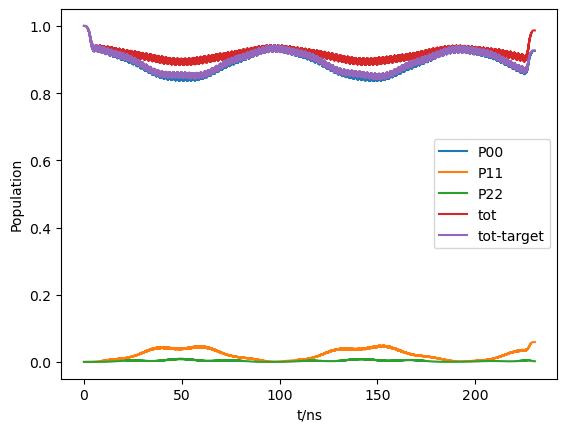

run end
wd_fit start 
 sp=0


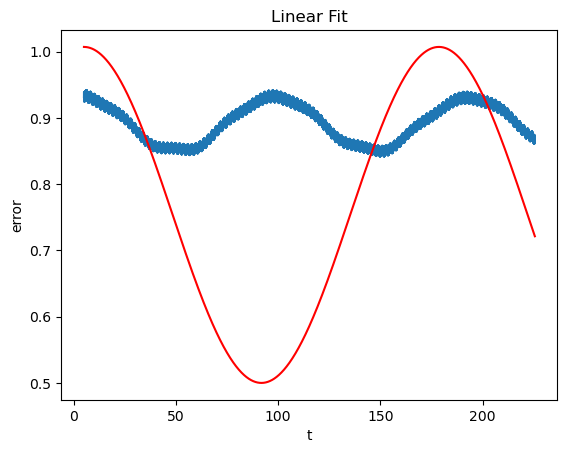

guess value of [d_eff,F,t0,c]=[0.004337039631333499, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.005759110300408422, 0.5069829895043625, 4.999999999999999, 0.49999999999999994, 173.63793152721567]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.27999999999999997
amp=0.27999999999999997
auto_scan_scope start 
 sp=0
T for scan:31.43966894048447
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
[4.421780330759857, 0.06566441751259129]


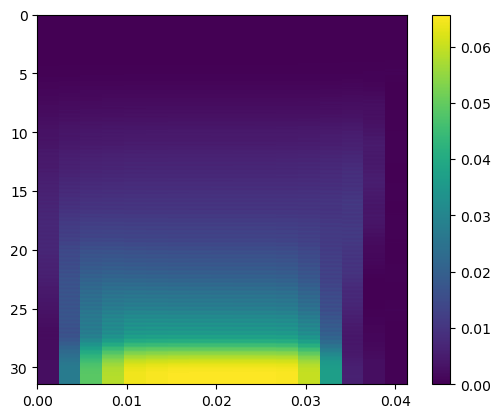

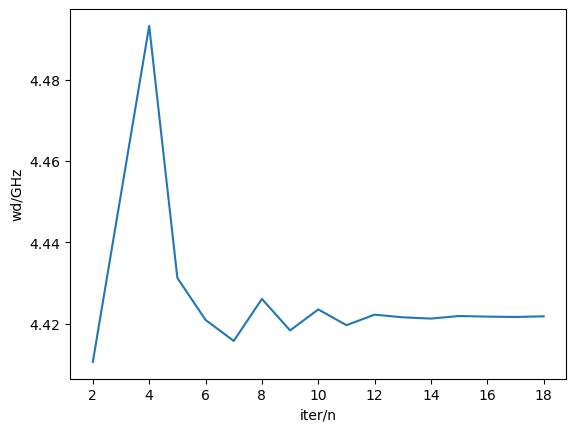

dpi=4.664251126152899e-05,w_match=4.421780330759857 
 auto_scan_scope end
run start


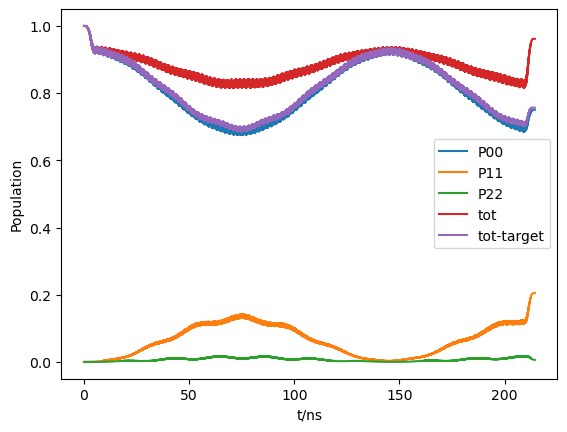

run end
wd_fit start 
 sp=0


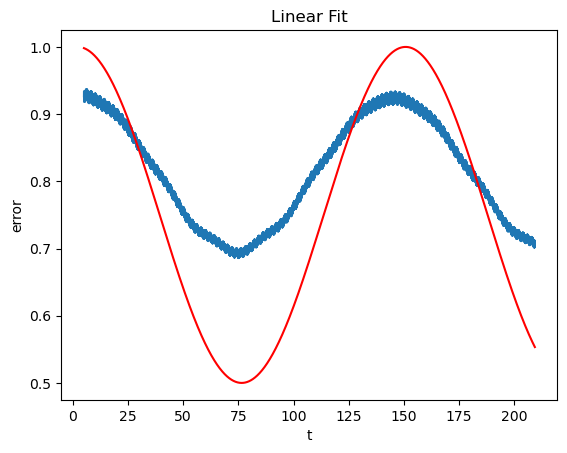

guess value of [d_eff,F,t0,c]=[0.004664251126152898, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.006727245323581482, 0.5000000000000001, 2.16558560594373, 0.49999999999999994, 148.649254174607]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.29
amp=0.29
auto_scan_scope start 
 sp=0
T for scan:29.986564149036653
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=0
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
[4.465347724759642, 0.0023395205182879467]


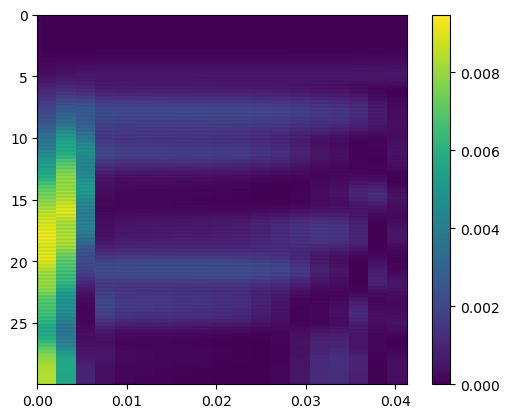

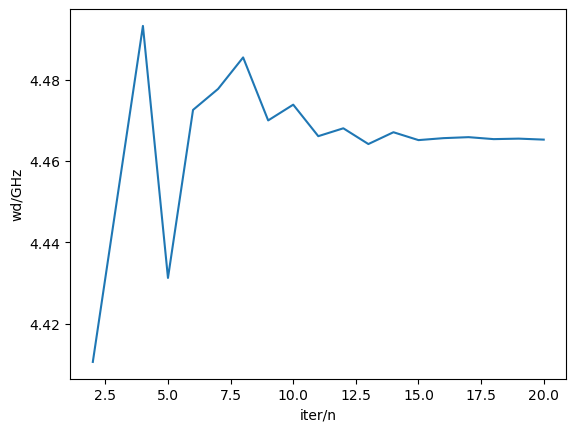

dpi=5.0033612207839125e-05,w_match=4.465347724759642 
 auto_scan_scope end
run start


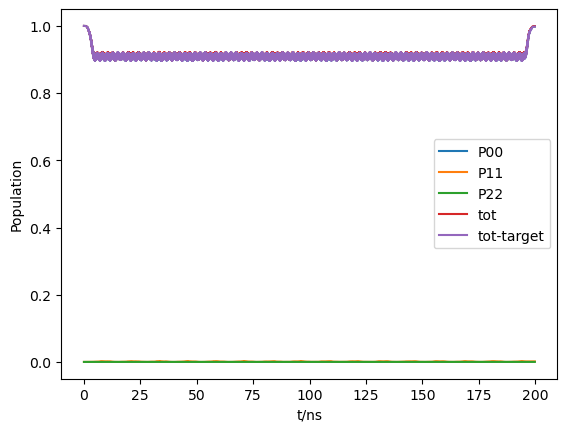

run end
wd_fit start 
 sp=0


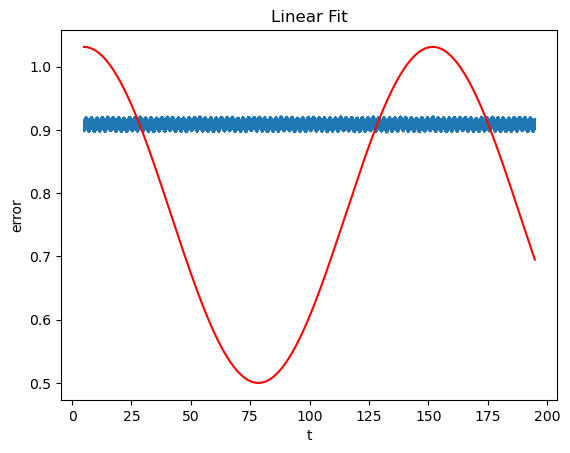

guess value of [d_eff,F,t0,c]=[0.005003361220783912, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.006809212191101137, 0.5313313227872806, 4.999999999999999, 0.49999999999999994, 146.8598674758419]
 wd_fit end
auto_scan_amp ,sp=0 ,amp=0.3
amp=0.3
auto_scan_scope start 
 sp=0
T for scan:28.676333832599795
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
[4.422425773633929, 0.07719171447159004]


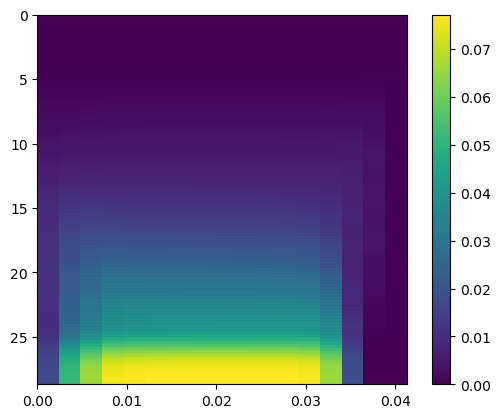

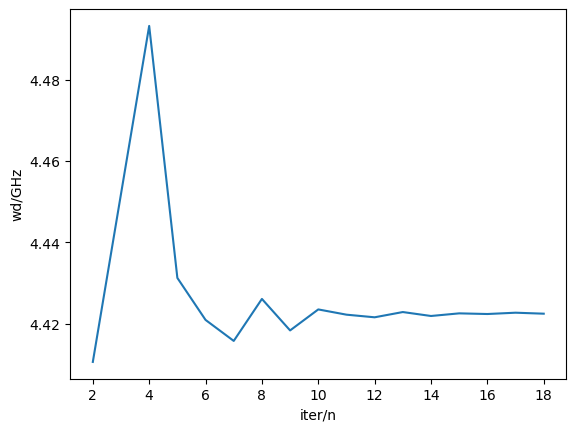

dpi=5.3543699152265446e-05,w_match=4.422425773633929 
 auto_scan_scope end
run start


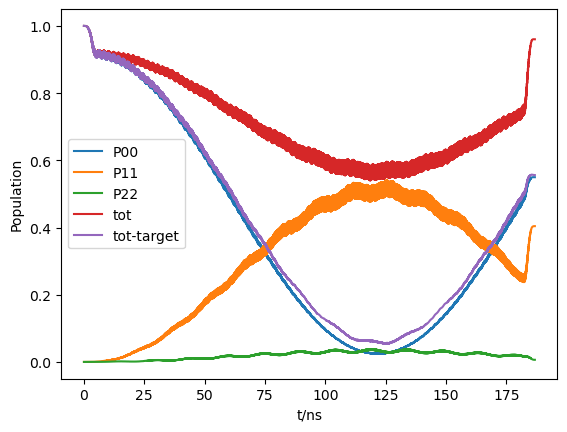

run end
wd_fit start 
 sp=0


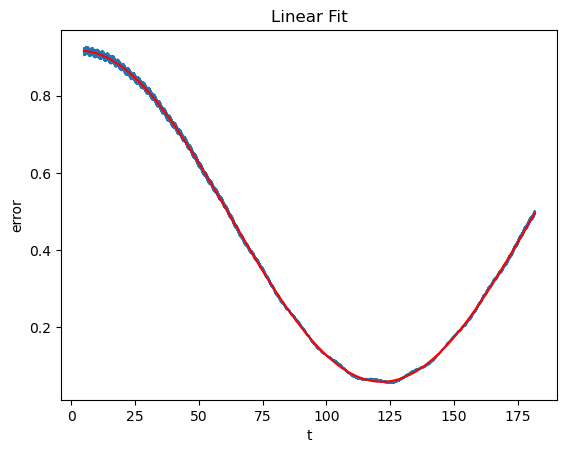

guess value of [d_eff,F,t0,c]=[0.005354369915226544, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.004212565933538339, 0.8601338374588686, 3.029817972900504, 0.05717056042437648, 237.38500851428842]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.04
amp=0.04
auto_scan_scope start 
 sp=1
T for scan:508.5923577376952
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=2

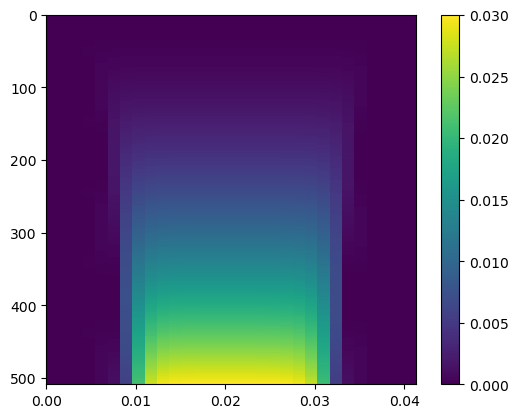

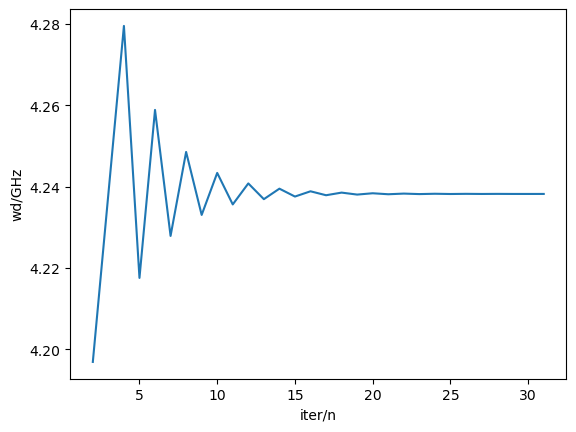

dpi=2.0056464654560364e-06,w_match=4.238184027951539 
 auto_scan_scope end
run start


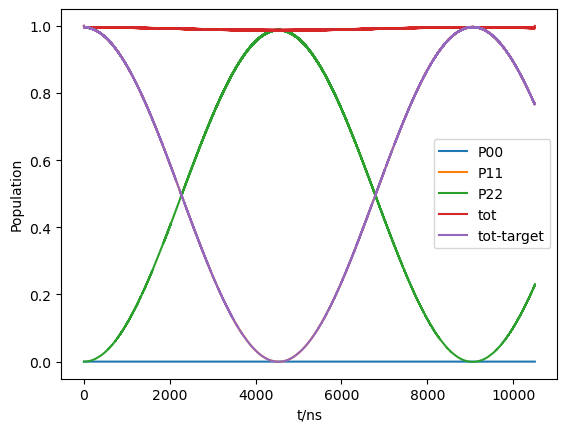

run end
wd_fit start 
 sp=1


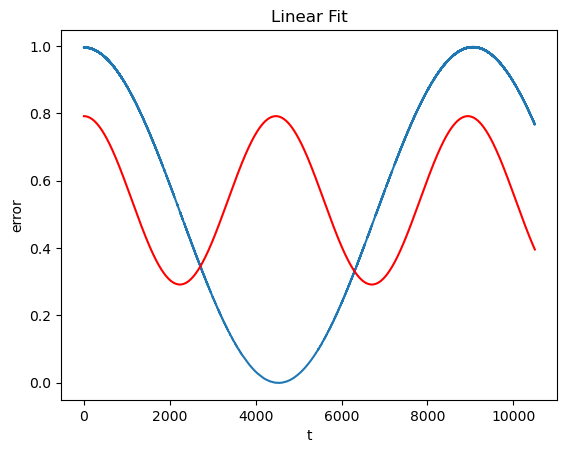

guess value of [d_eff,F,t0,c]=[0.00020056464654560365, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.00022383722680348312, 0.5000000000052417, 4.999999981795138, 0.29161979558615564, 4467.532118229581]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.05
amp=0.05
auto_scan_scope start 
 sp=1
T for scan:329.09910895212494
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_n

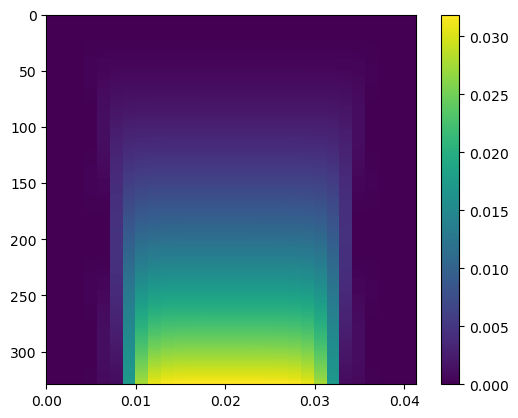

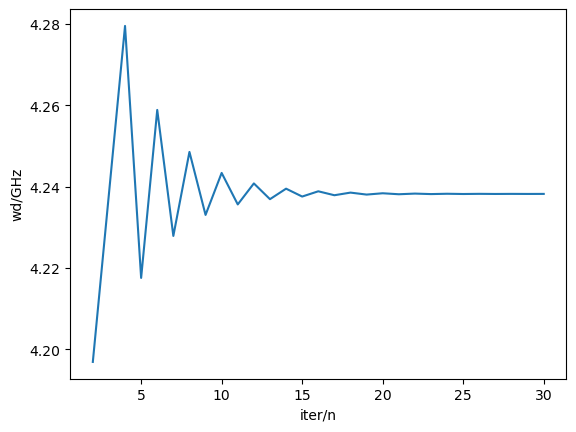

dpi=3.133822602275057e-06,w_match=4.238194112996447 
 auto_scan_scope end
run start


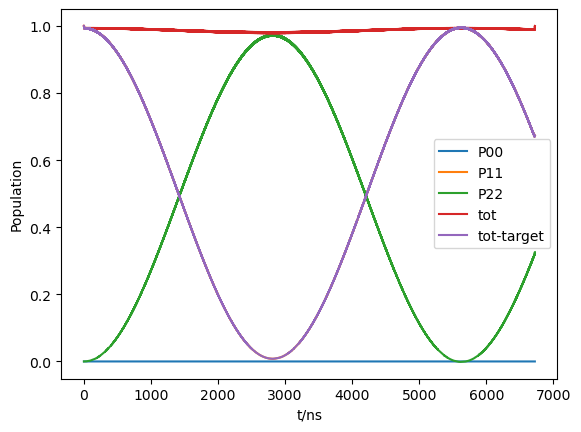

run end
wd_fit start 
 sp=1


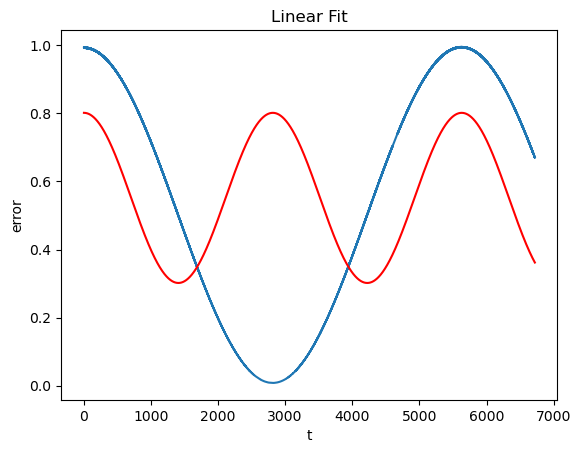

guess value of [d_eff,F,t0,c]=[0.0003133822602275057, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.000355610069934331, 0.5000000000000001, 4.999999999999903, 0.3017922829830639, 2812.068848850837]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.06
amp=0.06
auto_scan_scope start 
 sp=1
T for scan:231.59660343897565
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_num=2

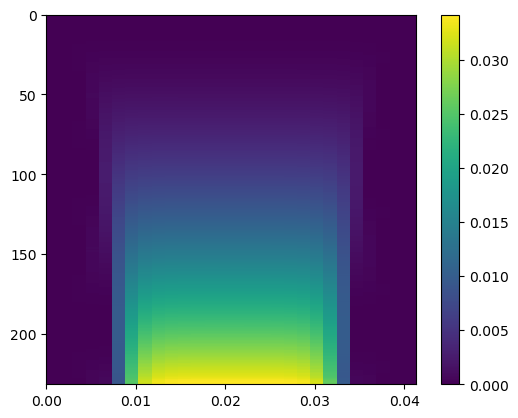

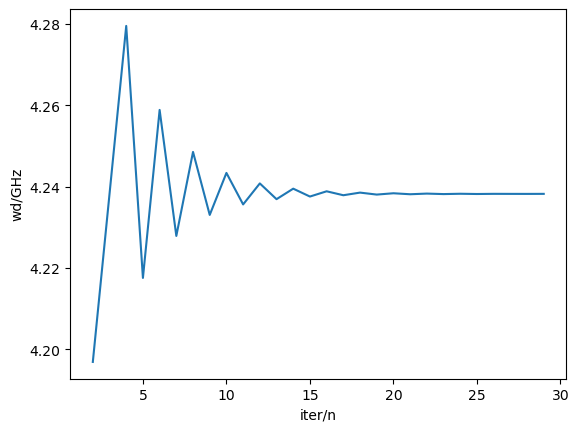

dpi=4.5127045472760824e-06,w_match=4.238199155518901 
 auto_scan_scope end
run start


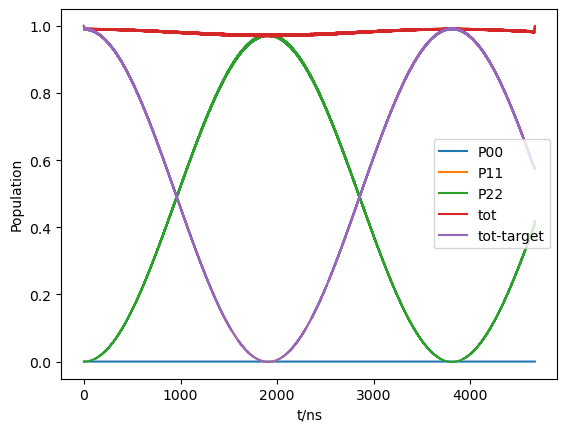

run end
wd_fit start 
 sp=1


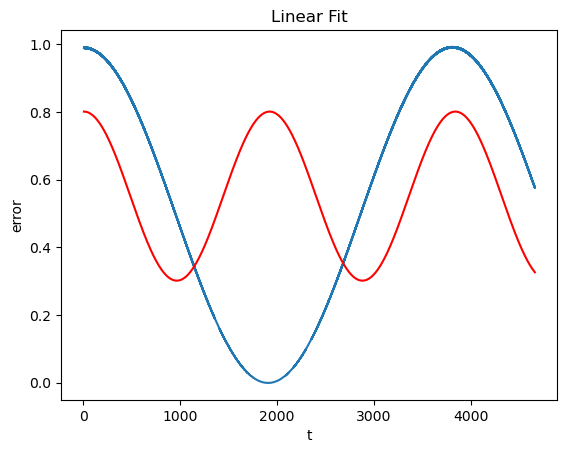

guess value of [d_eff,F,t0,c]=[0.0004512704547276082, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0005212360837282124, 0.5000000000000001, 4.999999999999999, 0.3013769898365733, 1918.5164481464199]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.07
amp=0.07
auto_scan_scope start 
 sp=1
T for scan:172.80566783271672
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=3
iter_num=22
run start
run end
iter_num

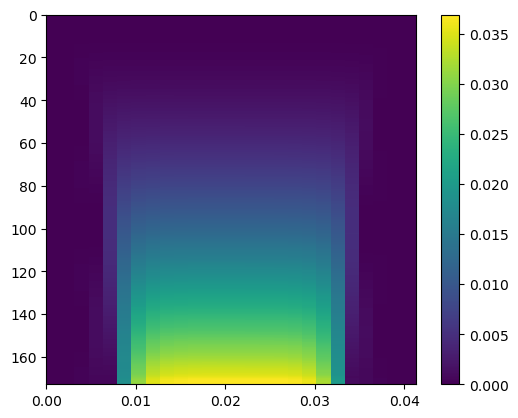

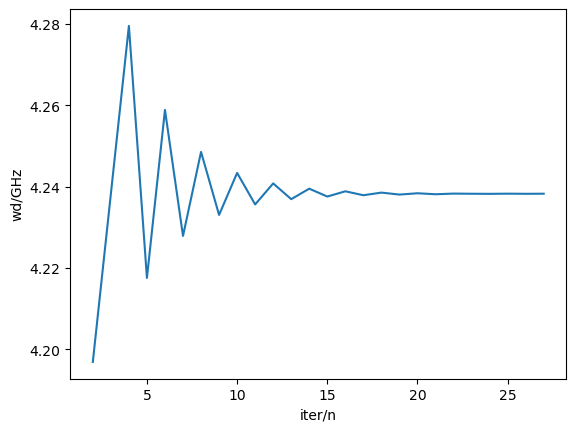

dpi=6.142292300459115e-06,w_match=4.238229410653623 
 auto_scan_scope end
run start


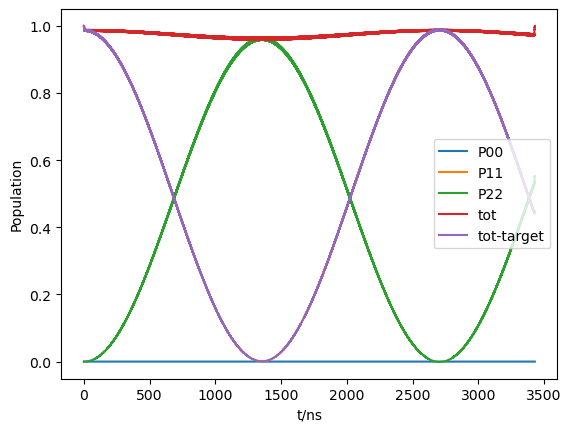

run end
wd_fit start 
 sp=1


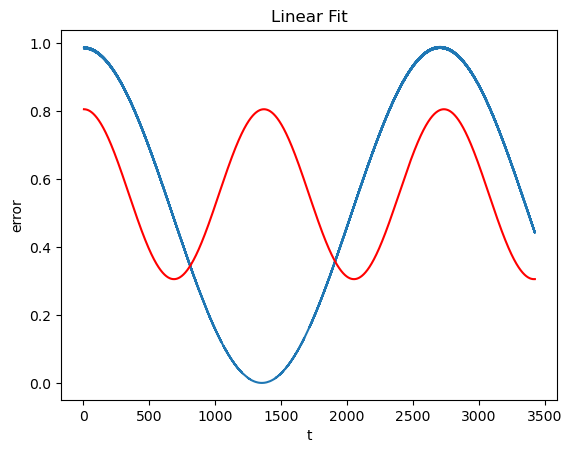

guess value of [d_eff,F,t0,c]=[0.0006142292300459115, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0007324317395251847, 0.5000000000000001, 4.999999999999999, 0.3061054252065591, 1365.314944773246]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.08
amp=0.08
auto_scan_scope start 
 sp=1
T for scan:134.6480894344238
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
iter_num=20
run start
run end
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
iter_num=2

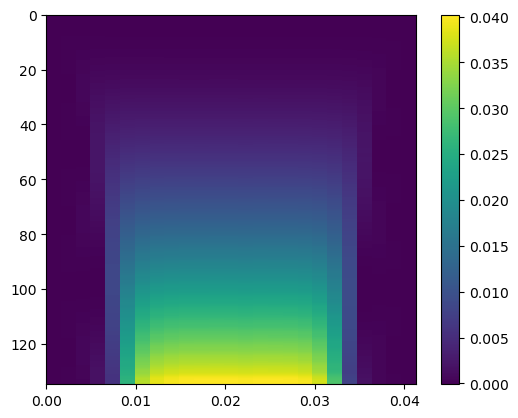

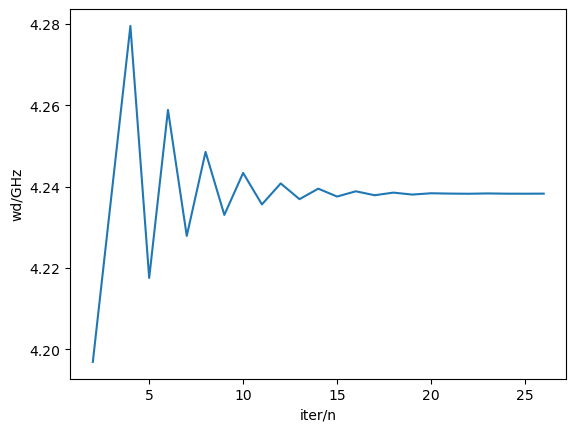

dpi=8.022585861824146e-06,w_match=4.238249580743437 
 auto_scan_scope end
run start


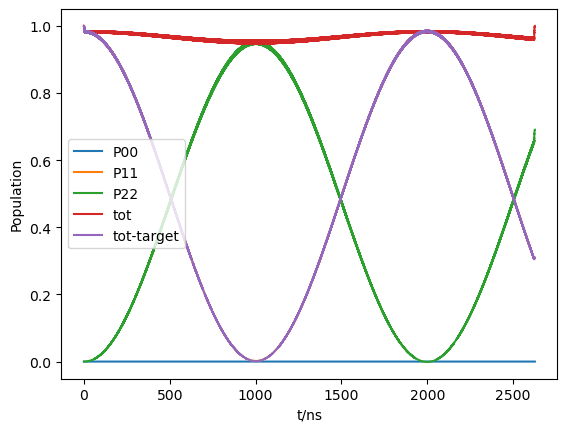

run end
wd_fit start 
 sp=1


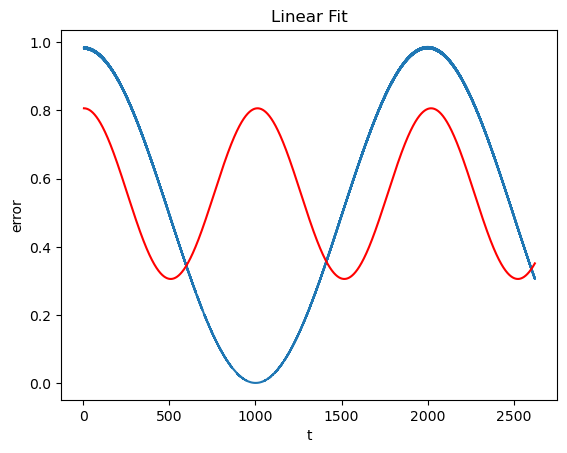

guess value of [d_eff,F,t0,c]=[0.0008022585861824146, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0009928921901335038, 0.5000000000000001, 4.999999999999999, 0.30609348016139404, 1007.1586924916194]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.09
amp=0.09
auto_scan_scope start 
 sp=1
T for scan:108.48737930621137
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
iter_num=22
run start
run end
iter_nu

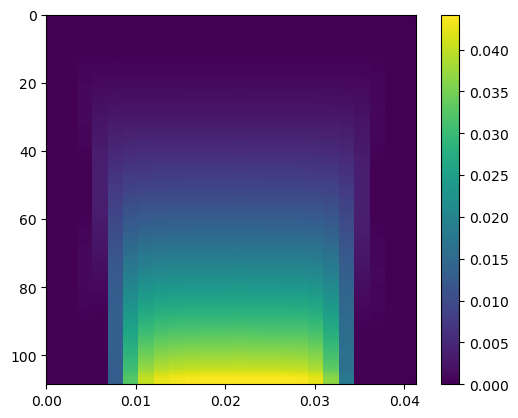

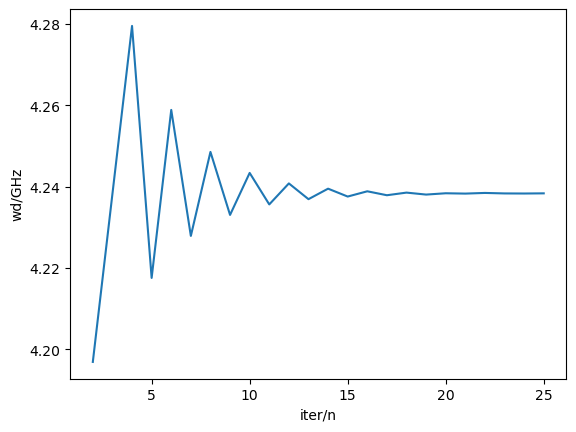

dpi=1.0153585231371188e-05,w_match=4.238310091012881 
 auto_scan_scope end
run start


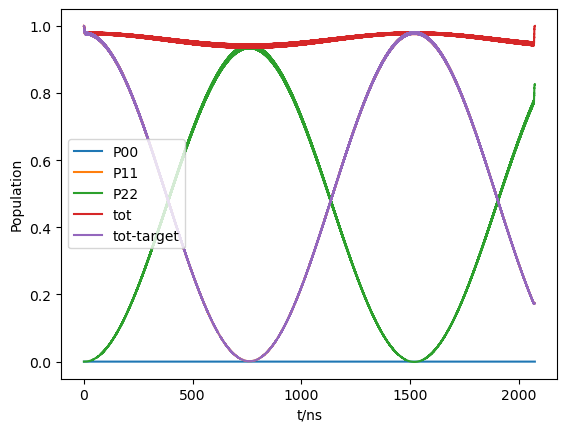

run end
wd_fit start 
 sp=1


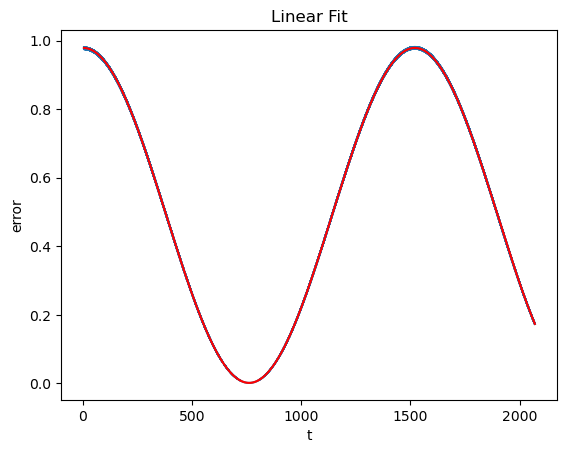

guess value of [d_eff,F,t0,c]=[0.0010153585231371188, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0006588597759627339, 0.9778664815156488, 2.7216925019804146, 0.0011909922655669617, 1517.773639373853]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.1
amp=0.1
auto_scan_scope start 
 sp=1
T for scan:89.77477723803123
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
iter_num

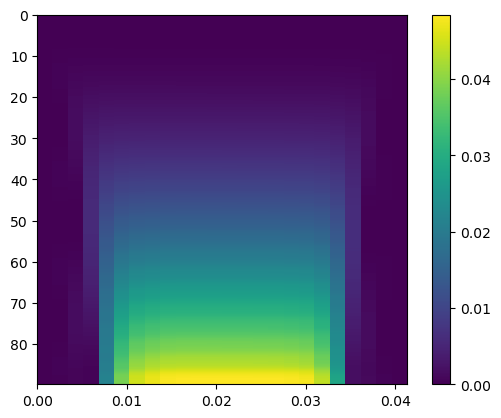

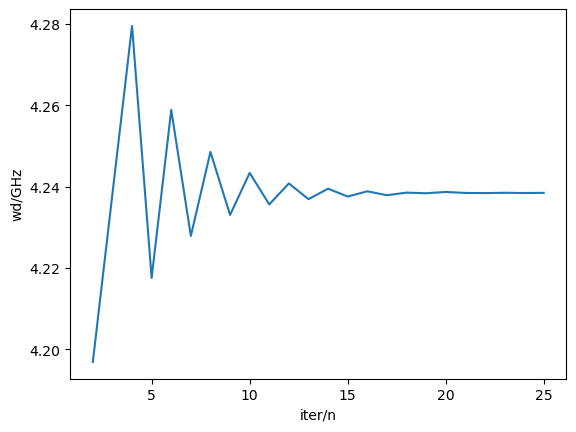

dpi=1.2535290409100228e-05,w_match=4.238451281641584 
 auto_scan_scope end
run start


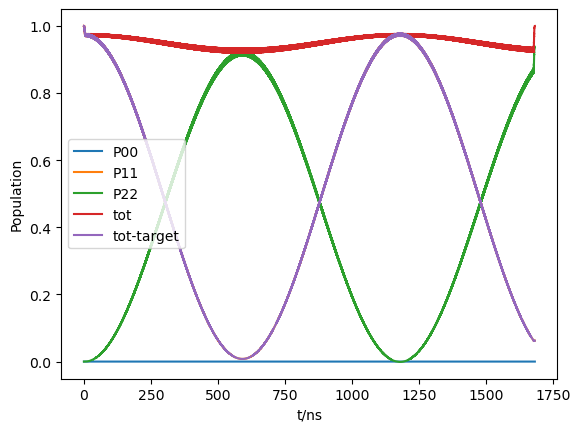

run end
wd_fit start 
 sp=1


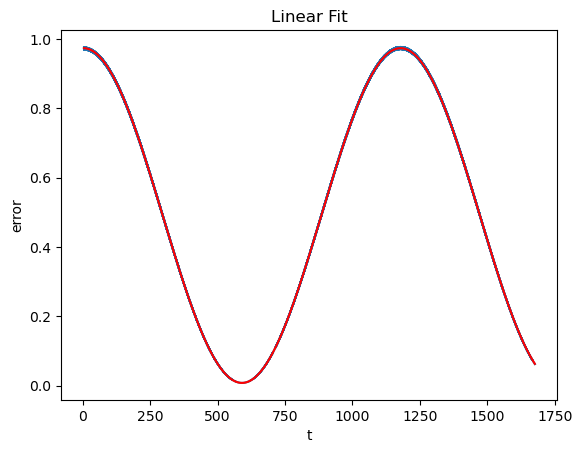

guess value of [d_eff,F,t0,c]=[0.0012535290409100227, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0008507968533279949, 0.9661074162084139, 3.000031432033205, 0.007816501052425642, 1175.368710037395]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.11000000000000001
amp=0.11000000000000001
auto_scan_scope start 
 sp=1
T for scan:75.92956796531504
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22


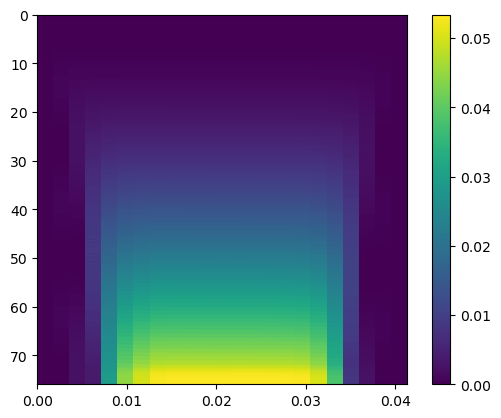

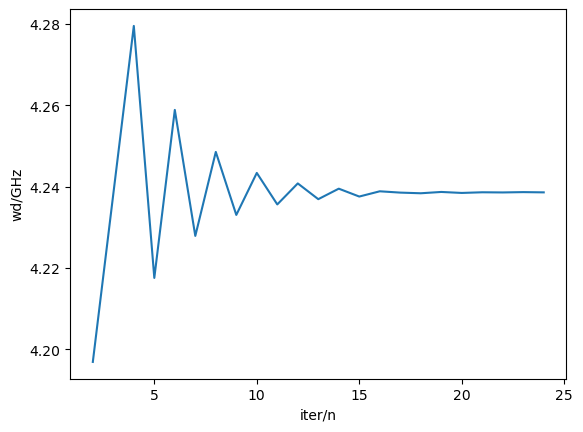

dpi=1.516770139501128e-05,w_match=4.238572302180472 
 auto_scan_scope end
run start


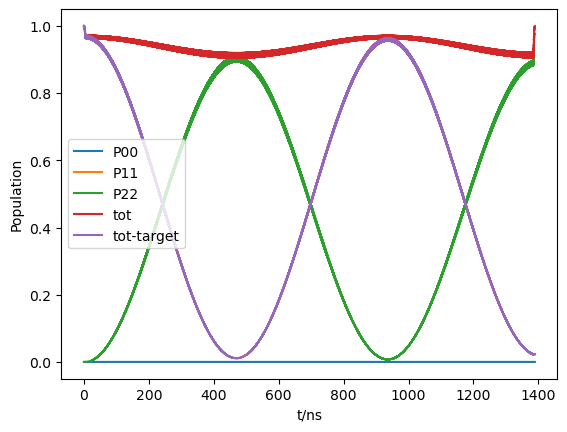

run end
wd_fit start 
 sp=1


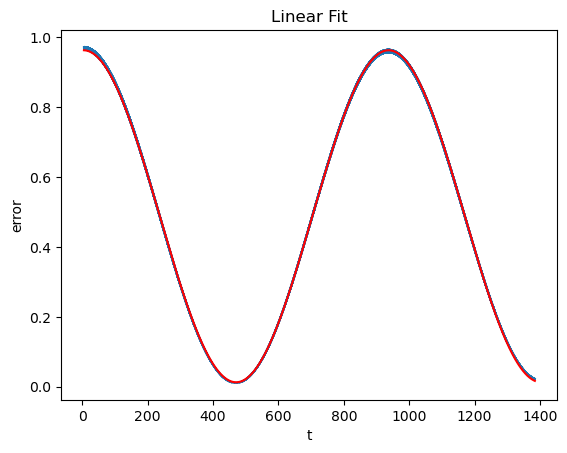

guess value of [d_eff,F,t0,c]=[0.001516770139501128, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0010718033245755338, 0.9487818540855973, 3.7842525064389823, 0.012903898909187689, 933.0069958460242]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.12
amp=0.12
auto_scan_scope start 
 sp=1
T for scan:65.39915085974391
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
iter_num=22
run start
run end
iter_num=23


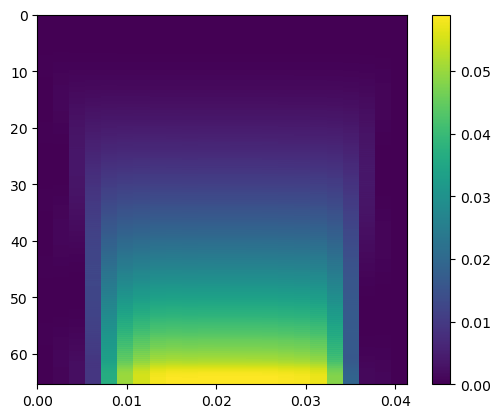

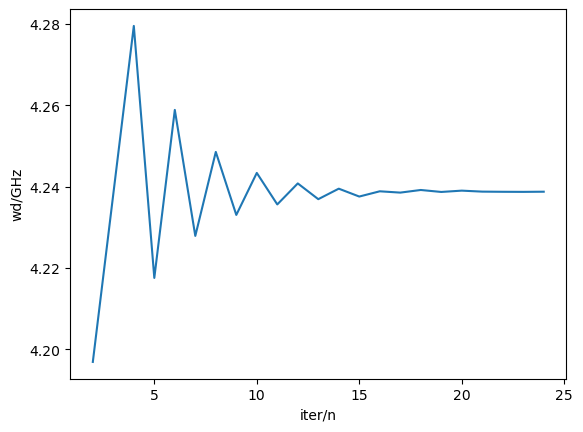

dpi=1.805081818910433e-05,w_match=4.238713492809175 
 auto_scan_scope end
run start


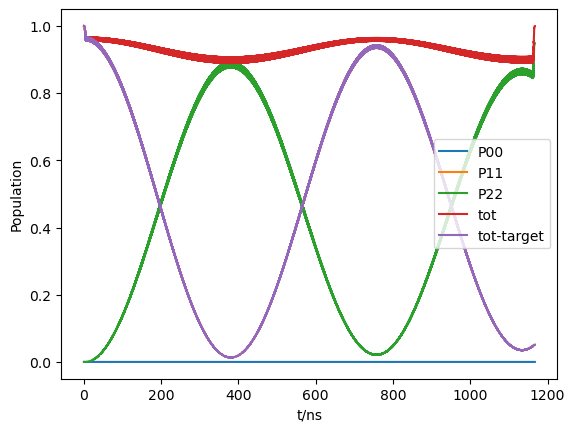

run end
wd_fit start 
 sp=1


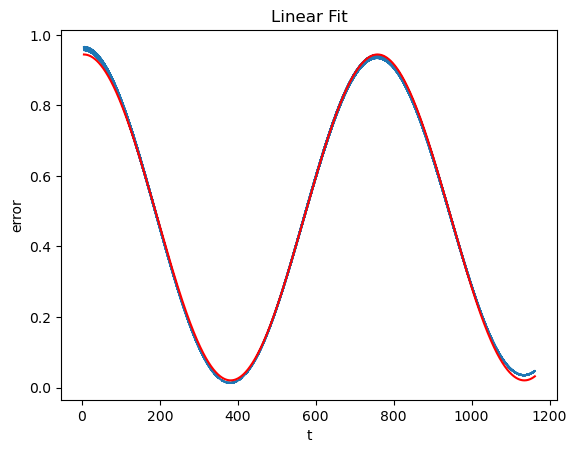

guess value of [d_eff,F,t0,c]=[0.0018050818189104328, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0013266094665238405, 0.9240292714766815, 4.655820972669067, 0.02029736337274199, 753.8013448828567]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.13
amp=0.13
auto_scan_scope start 
 sp=1
T for scan:57.20401020001847
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=3
iter_num=19
run start
run end
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.238915193707323, 0.06546239101230883]


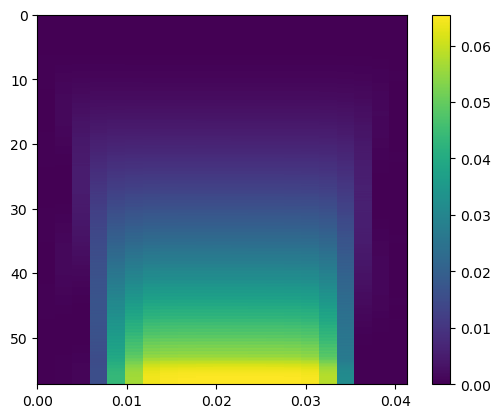

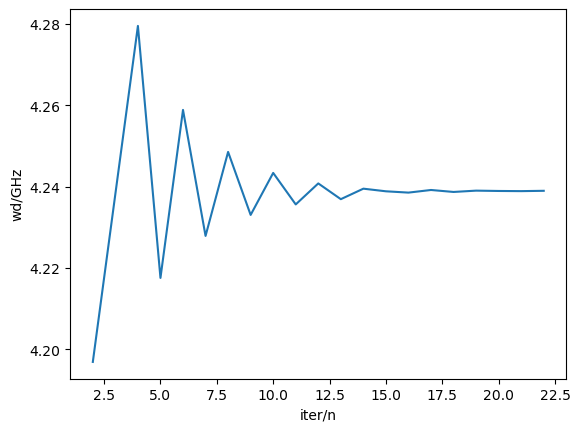

dpi=2.118464079137939e-05,w_match=4.238915193707323 
 auto_scan_scope end
run start


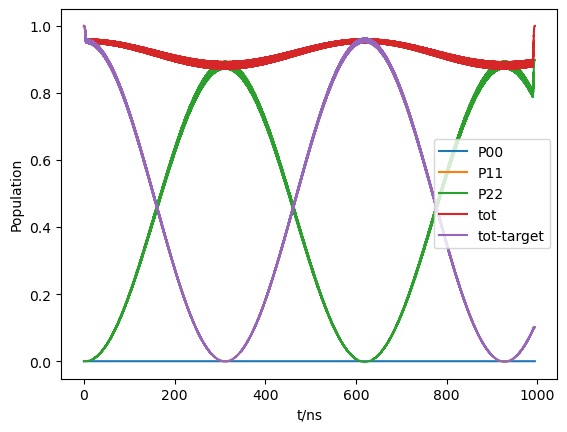

run end
wd_fit start 
 sp=1


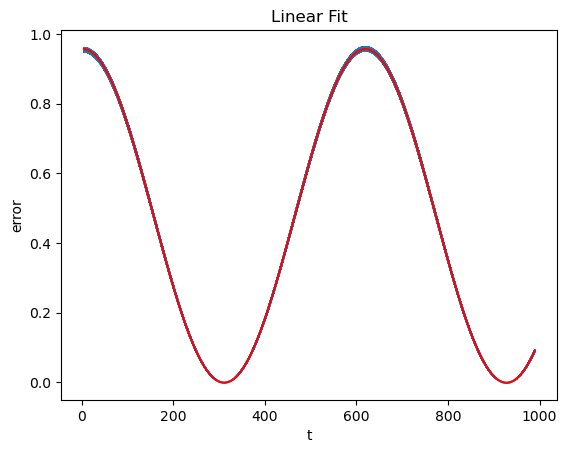

guess value of [d_eff,F,t0,c]=[0.002118464079137939, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0016223178548361048, 0.9576390941776899, 3.0898257524390362, -0.0010137503294230046, 616.4020182721994]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.14
amp=0.14
auto_scan_scope start 
 sp=1
T for scan:50.70141695817918
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=3
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
[4.239

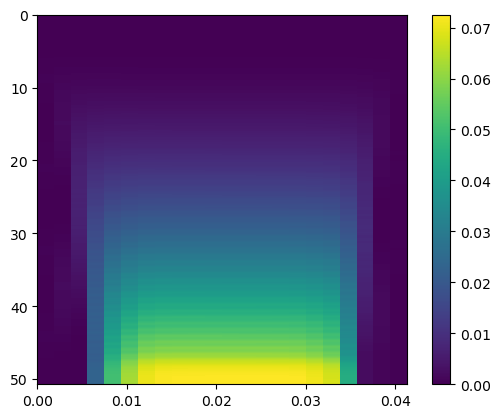

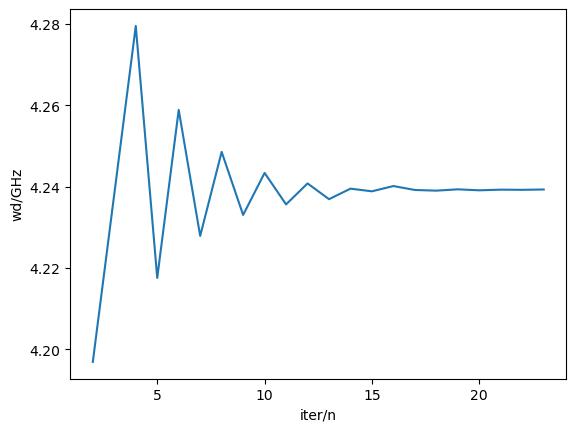

dpi=2.456916920183646e-05,w_match=4.239237915144358 
 auto_scan_scope end
run start


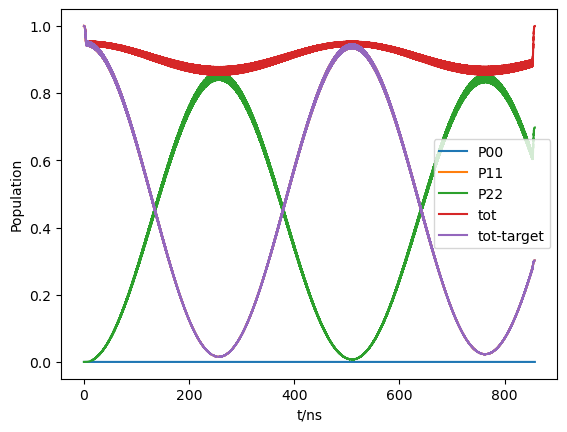

run end
wd_fit start 
 sp=1


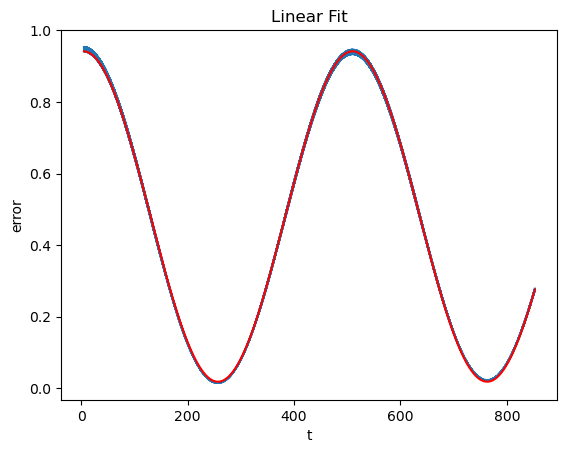

guess value of [d_eff,F,t0,c]=[0.002456916920183646, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.001975819013654691, 0.9229470984342271, 3.768829775939292, 0.018563533556966726, 506.11923110826365]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.15
amp=0.15
auto_scan_scope start 
 sp=1
T for scan:45.4554565502361
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
j=3
iter_num=21
run start
run end
iter_num=22
run start
run end
j=2
[4.2395606

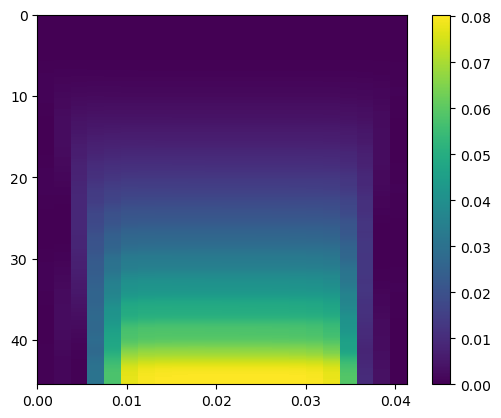

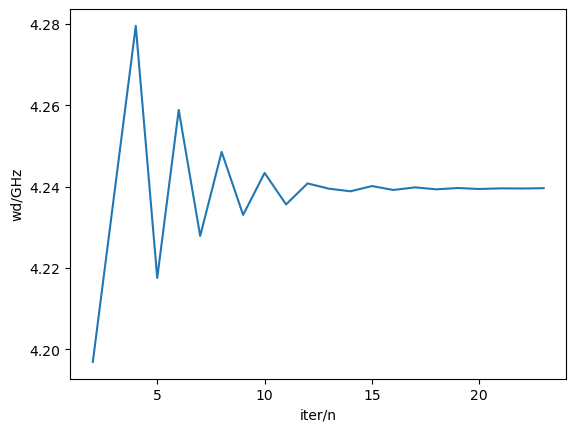

dpi=2.8204403420475512e-05,w_match=4.239560636581393 
 auto_scan_scope end
run start


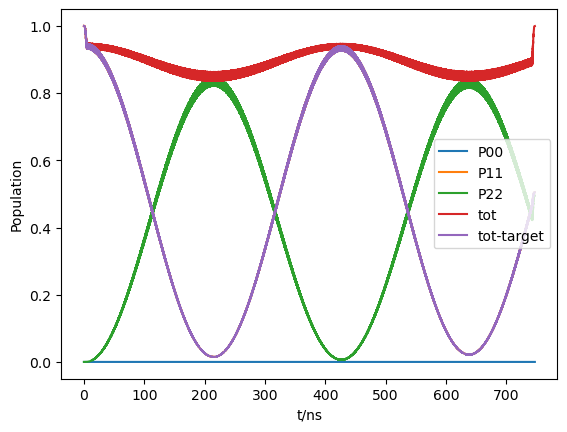

run end
wd_fit start 
 sp=1


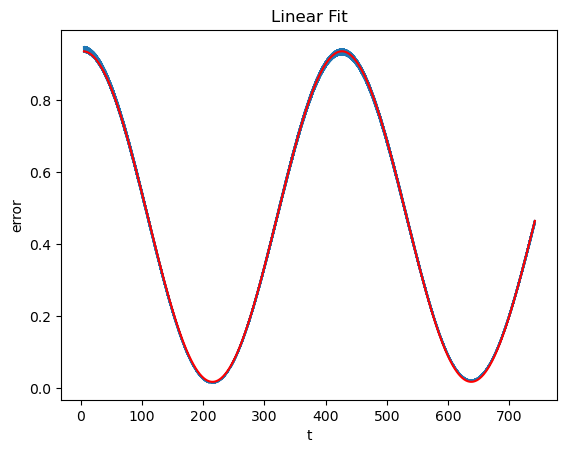

guess value of [d_eff,F,t0,c]=[0.0028204403420475513, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0023642098467337655, 0.9169891757082577, 3.6125271485570853, 0.017737142833143888, 422.9742978955668]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.16
amp=0.16
auto_scan_scope start 
 sp=1
T for scan:41.16202235860595
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.239964038377688, 0.08899795797655845]


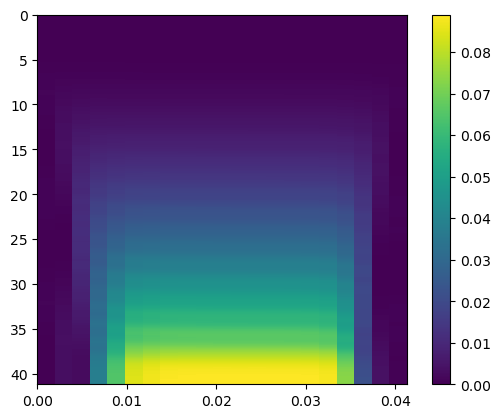

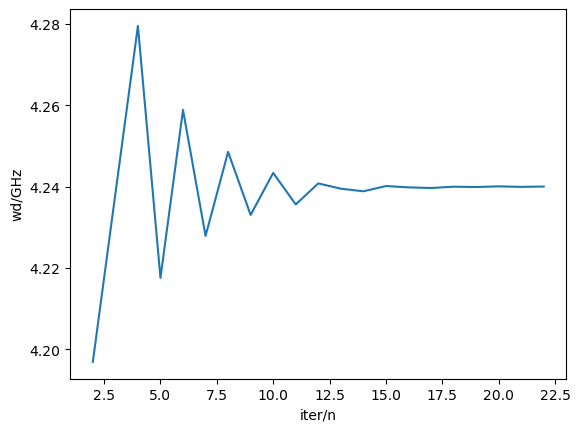

dpi=3.209034344729658e-05,w_match=4.239964038377688 
 auto_scan_scope end
run start


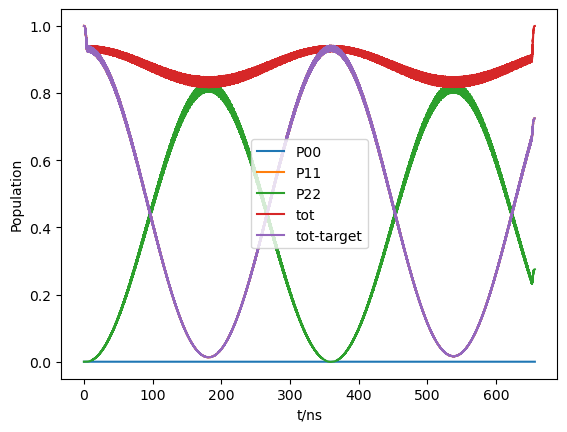

run end
wd_fit start 
 sp=1


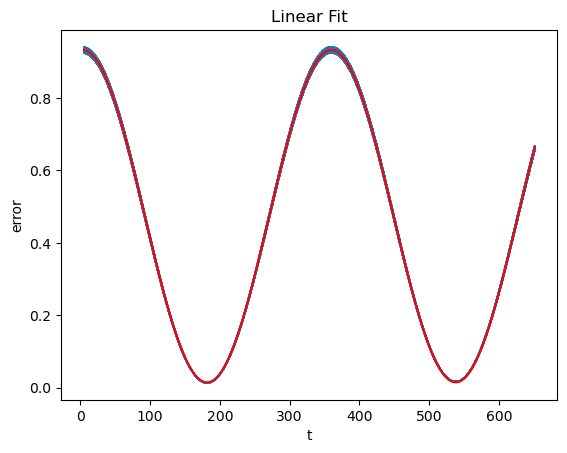

guess value of [d_eff,F,t0,c]=[0.0032090343447296584, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0028039600899926933, 0.917967108595353, 3.1852121580532793, 0.014652696977324737, 356.63845700550104]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.17
amp=0.17
auto_scan_scope start 
 sp=1
T for scan:37.60372914810769
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
iter_num=19
run start
run end
iter_num=20
run start
run end
iter_num=21
run start
run end
j=2
[4.240367440173982, 0.09846994204986663]


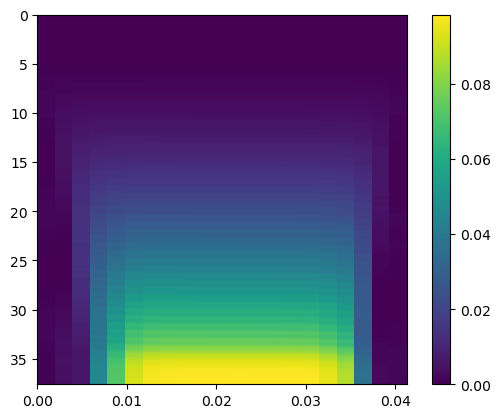

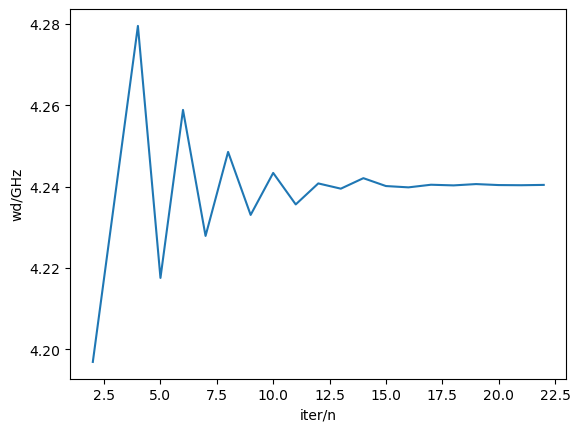

dpi=3.622698928229967e-05,w_match=4.240367440173982 
 auto_scan_scope end
run start


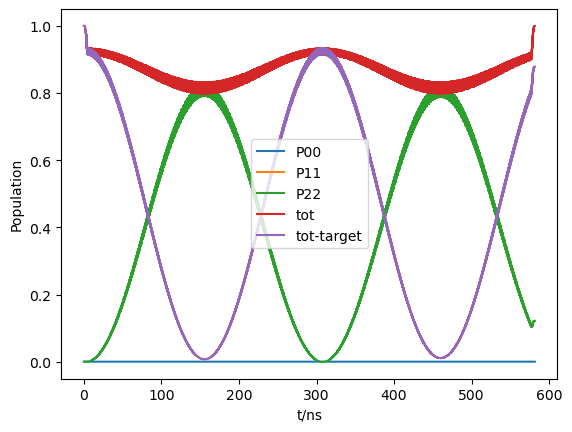

run end
wd_fit start 
 sp=1


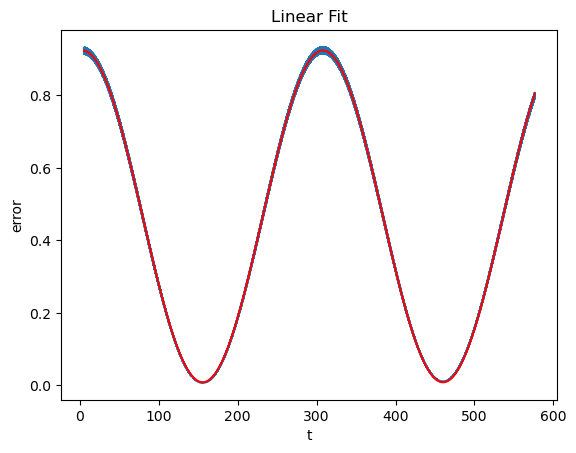

guess value of [d_eff,F,t0,c]=[0.0036226989282299666, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0032818663503680102, 0.9152575451720123, 3.1639259651453315, 0.00881074553066139, 304.704669002705]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.18000000000000002
amp=0.18000000000000002
auto_scan_scope start 
 sp=1
T for scan:34.621844826552845
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=3
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
[4.240932202688795, 0.10882216802651114]


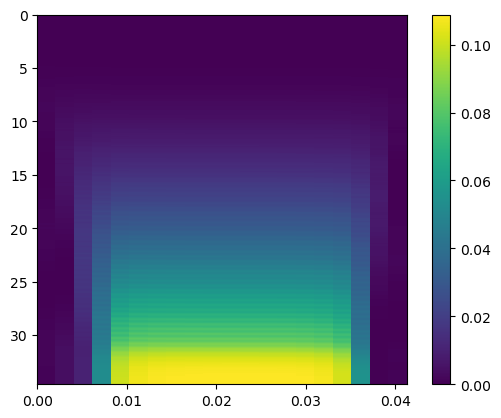

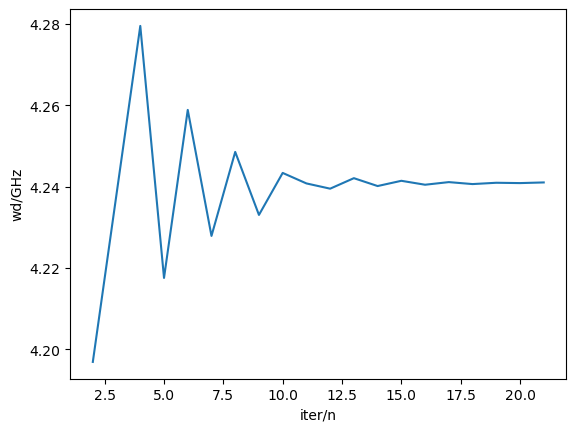

dpi=4.061434092548475e-05,w_match=4.240932202688795 
 auto_scan_scope end
run start


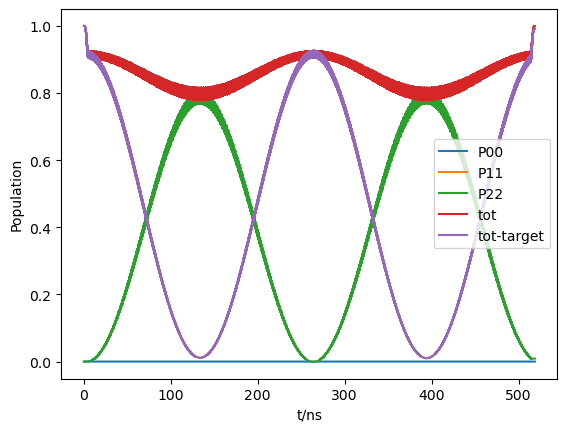

run end
wd_fit start 
 sp=1


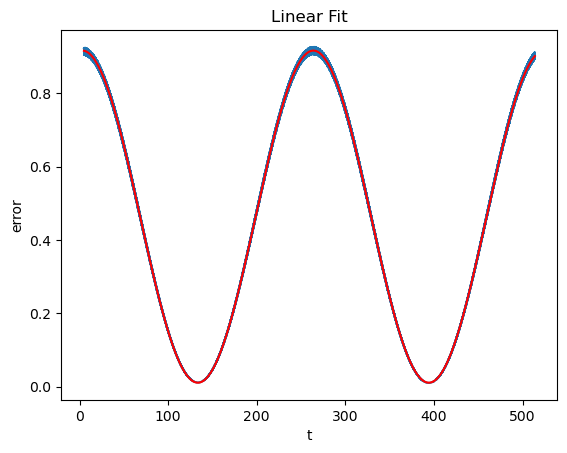

guess value of [d_eff,F,t0,c]=[0.004061434092548475, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.003836992982880705, 0.9054738011660927, 3.227100825799386, 0.01077543523434457, 260.6207528816559]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.19
amp=0.19
auto_scan_scope start 
 sp=1
T for scan:32.098276243221946
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
[4.241496965203606, 0.12004411682545185]


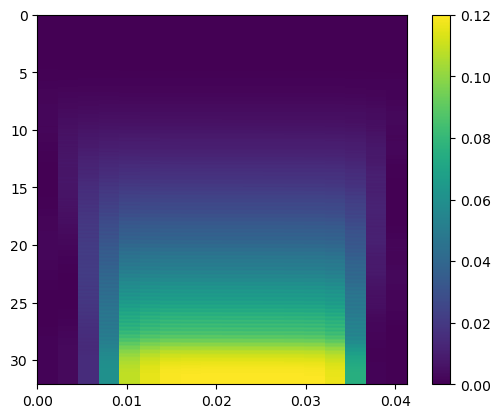

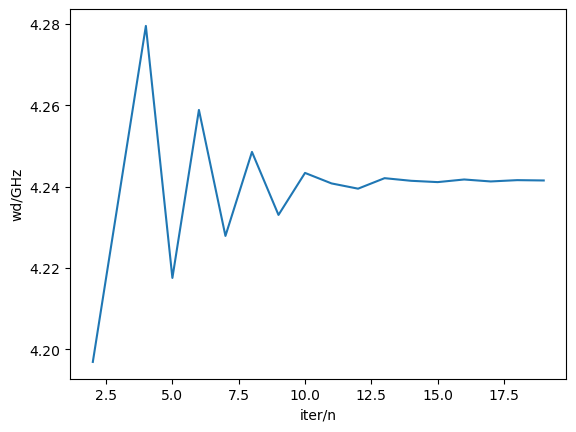

dpi=4.525239837685182e-05,w_match=4.241496965203606 
 auto_scan_scope end
run start


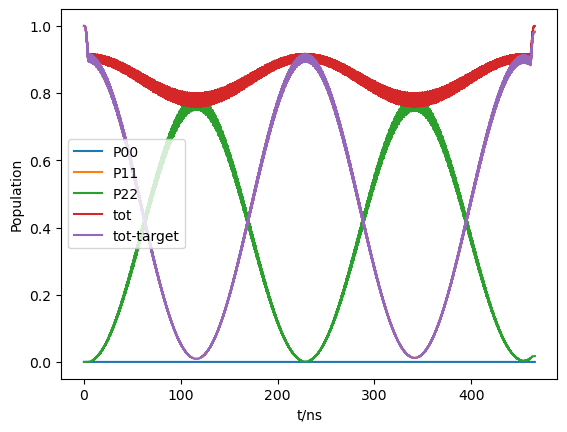

run end
wd_fit start 
 sp=1


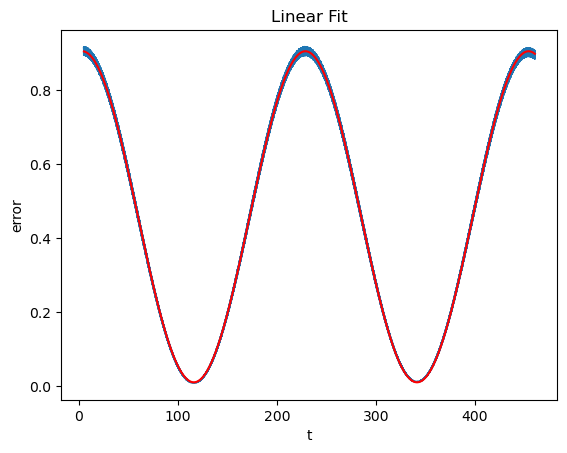

guess value of [d_eff,F,t0,c]=[0.004525239837685182, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.004434871518235307, 0.8932672933265237, 3.2894084526598752, 0.010784888250255736, 225.4856754898534]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.2
amp=0.2
auto_scan_scope start 
 sp=1
T for scan:29.94369430950781
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=2
iter_num=17
run start
run end
iter_num=18
run start
run end
j=3
iter_num=19
run start
run end
iter_num=20
run start
run end
j=2
[4.242223088436936, 0.13234781474691532]


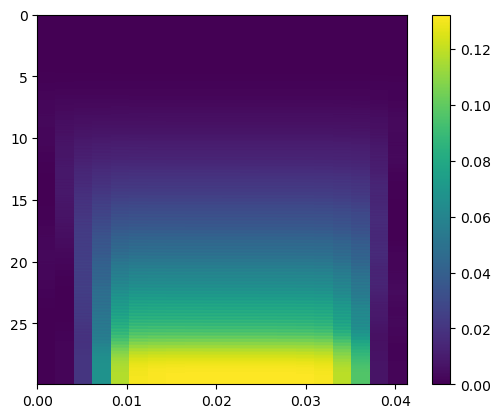

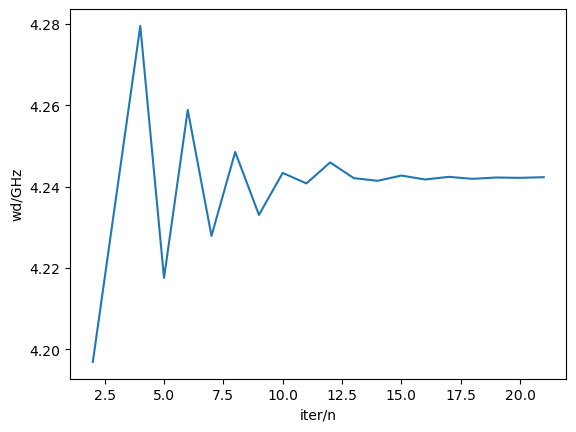

dpi=5.014116163640091e-05,w_match=4.242223088436936 
 auto_scan_scope end
run start


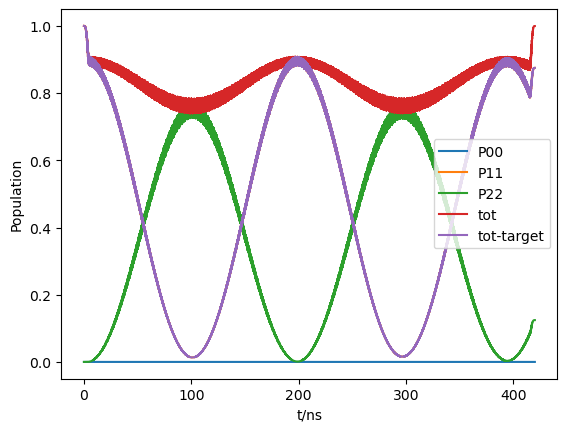

run end
wd_fit start 
 sp=1


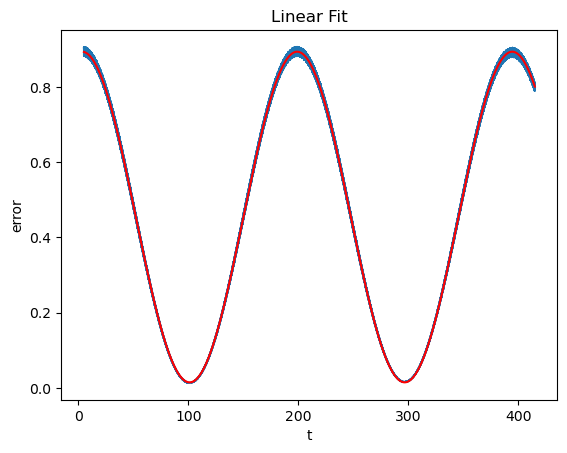

guess value of [d_eff,F,t0,c]=[0.005014116163640091, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.005111331088381168, 0.8796227087944328, 3.310952803447883, 0.014592618502993572, 195.64375359544835]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.21000000000000002
amp=0.21000000000000002
auto_scan_scope start 
 sp=1
T for scan:28.089518648079643
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
j=3
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
iter_num=18
run start
run end
iter_num=19
run start
run end
j=3
[4.242949211670265, 0.14535633584615607]


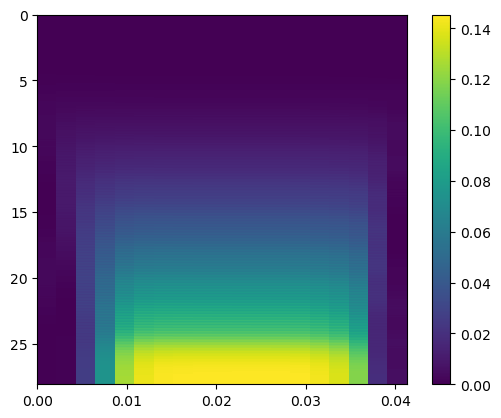

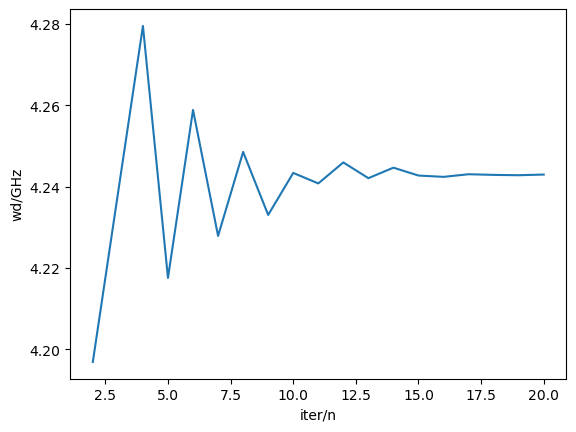

dpi=5.5280630704132014e-05,w_match=4.242949211670265 
 auto_scan_scope end
run start


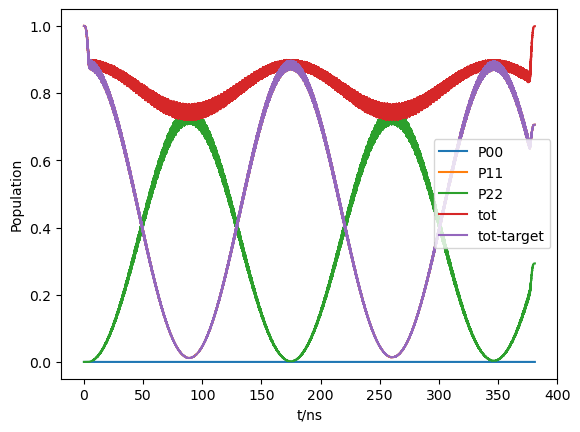

run end
wd_fit start 
 sp=1


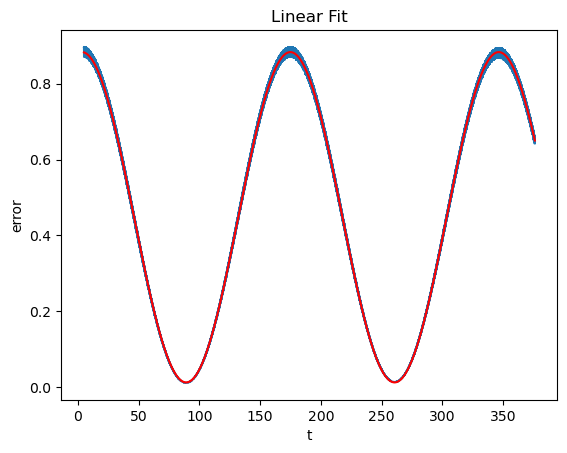

guess value of [d_eff,F,t0,c]=[0.005528063070413201, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.005828875270254623, 0.8702929458757891, 3.330323180721023, 0.012868200034267559, 171.55968409602235]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.22
amp=0.22
auto_scan_scope start 
 sp=1
T for scan:26.482391991328768
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=3
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=3
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
[4.243756015262855, 0.1595725712763913]


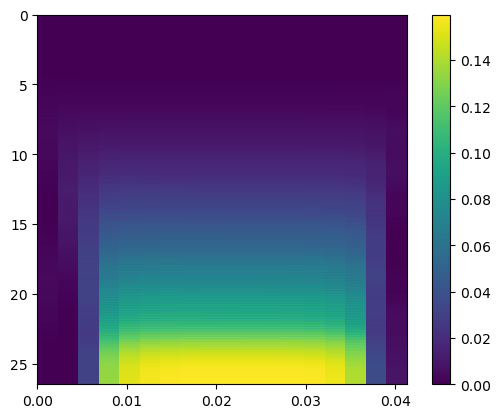

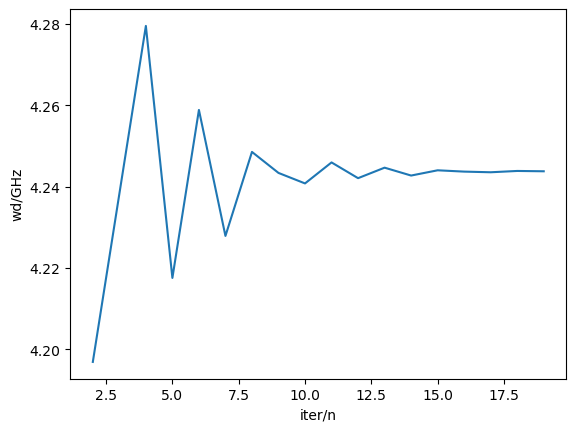

dpi=6.0670805580045095e-05,w_match=4.243756015262855 
 auto_scan_scope end
run start


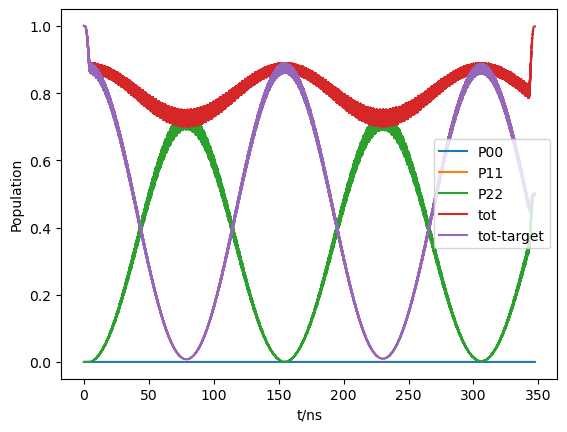

run end
wd_fit start 
 sp=1


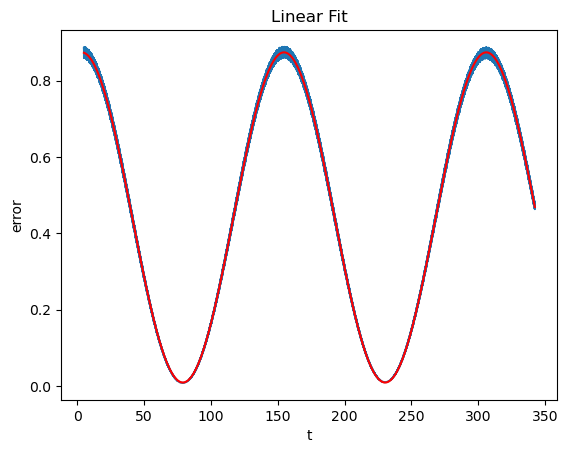

guess value of [d_eff,F,t0,c]=[0.00606708055800451, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.006608017313441161, 0.8651903601273585, 3.302507066211273, 0.00881081308545108, 151.33132262924482]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.23
amp=0.23
auto_scan_scope start 
 sp=1
T for scan:25.08029815463728
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=3
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
[4.244724179573961, 0.1746725975697935]


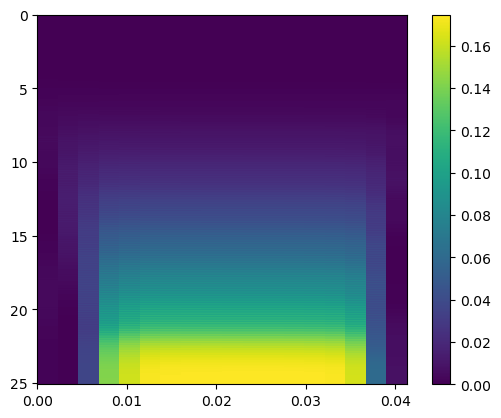

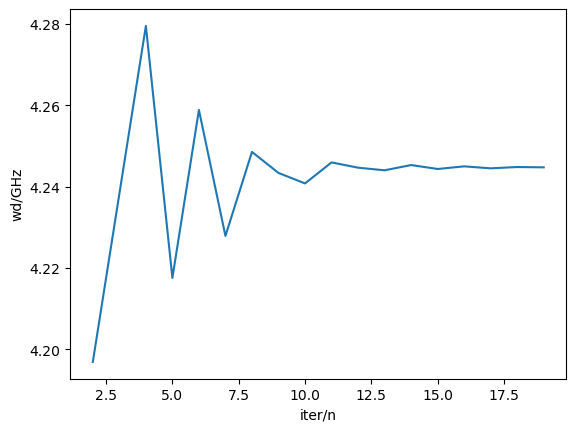

dpi=6.631168626414022e-05,w_match=4.244724179573961 
 auto_scan_scope end
run start


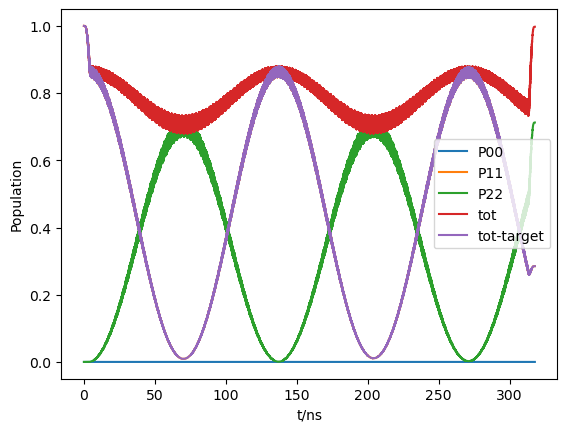

run end
wd_fit start 
 sp=1


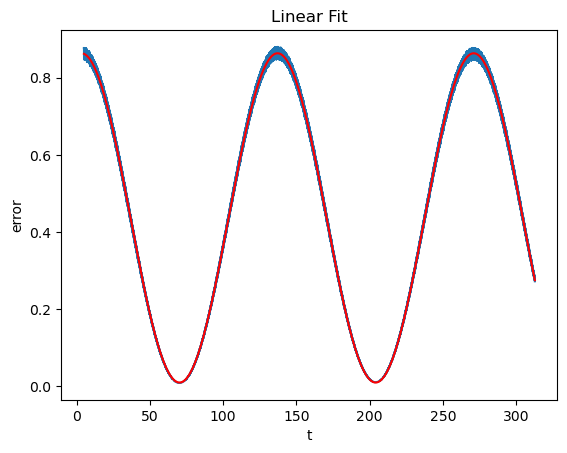

guess value of [d_eff,F,t0,c]=[0.006631168626414022, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.007470660672761633, 0.8528234815354357, 3.2979602773689756, 0.01016238015163798, 133.85696979198175]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.24000000000000002
amp=0.24000000000000002
auto_scan_scope start 
 sp=1
T for scan:23.84978771493597
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=3
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=3
iter_num=18
run start
run end
iter_num=19
run start
run end
j=2
[4.245773024244326, 0.19098664213605276]


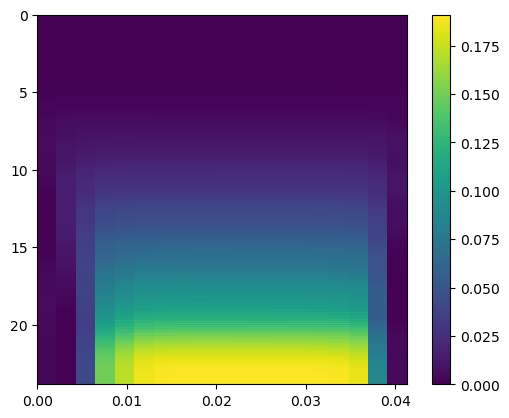

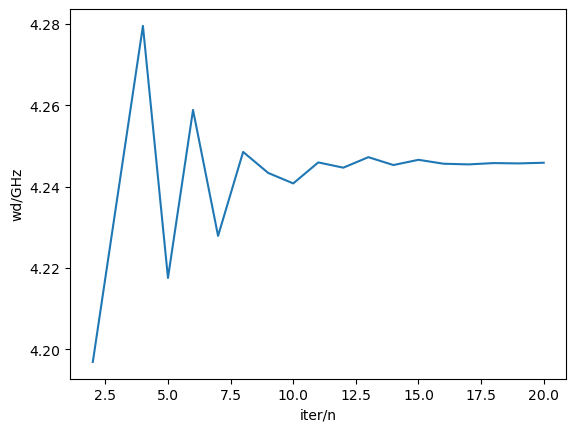

dpi=7.220327275641733e-05,w_match=4.245773024244326 
 auto_scan_scope end
run start


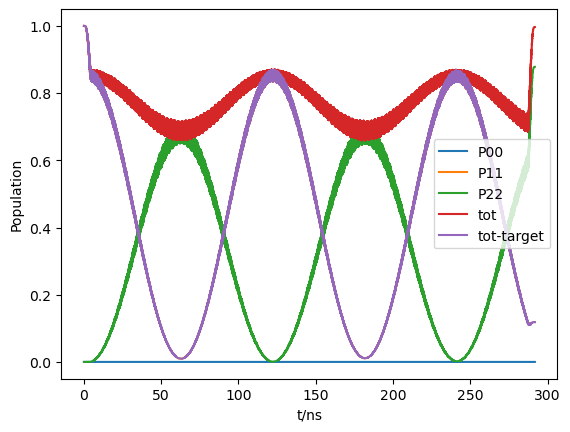

run end
wd_fit start 
 sp=1


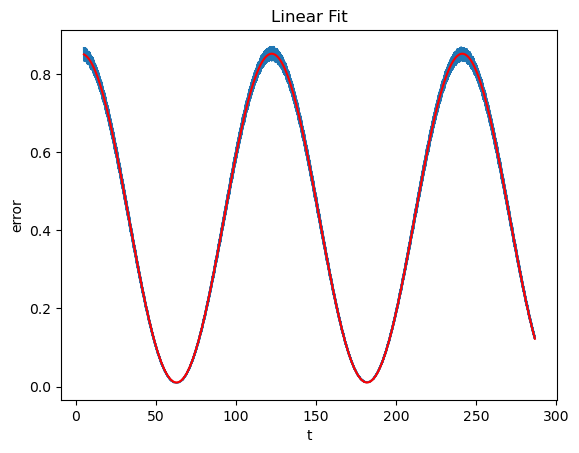

guess value of [d_eff,F,t0,c]=[0.007220327275641734, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.008398017350668979, 0.8414585849191268, 3.289334588580594, 0.010409646008023441, 119.0757244530271]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.25
amp=0.25
auto_scan_scope start 
 sp=1
T for scan:22.763964358084998
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=3
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
iter_num=18
run start
run end
j=3
[4.24682186891469, 0.20781853903940115]


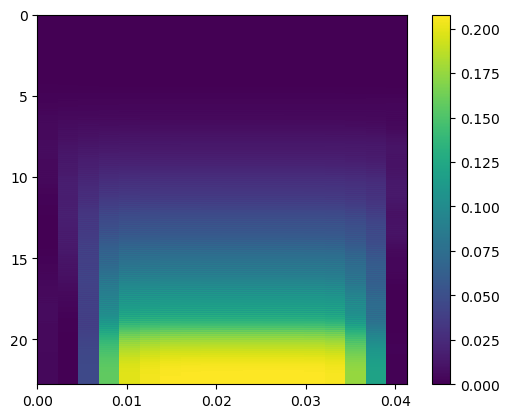

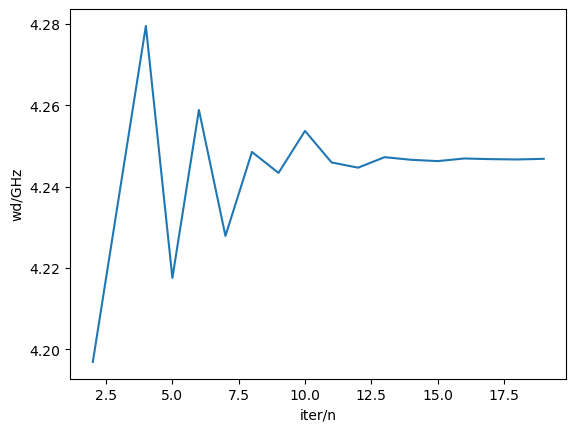

dpi=7.834556505687641e-05,w_match=4.24682186891469 
 auto_scan_scope end
run start


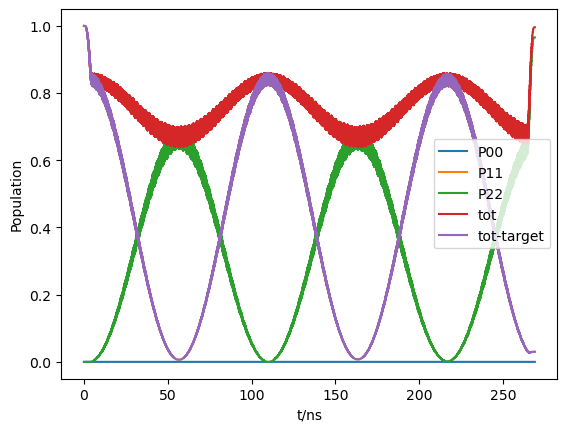

run end
wd_fit start 
 sp=1


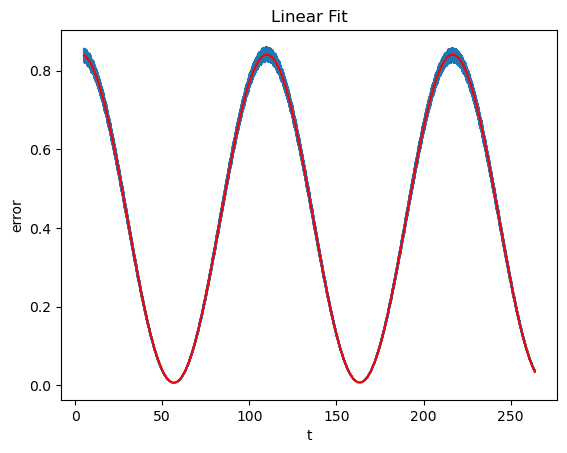

guess value of [d_eff,F,t0,c]=[0.00783455650568764, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.009369714861234375, 0.8334700578106078, 3.2782193455582433, 0.007075218338378594, 106.72683372013084]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.26
amp=0.26
auto_scan_scope start 
 sp=1
T for scan:21.80100255000462
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=2
iter_num=6
run start
run end
iter_num=7
run start
run end
j=3
iter_num=8
run start
run end
iter_num=9
run start
run end
j=2
iter_num=10
run start
run end
iter_num=11
run start
run end
j=2
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
[4.248032074303574, 0.22637093077352896]


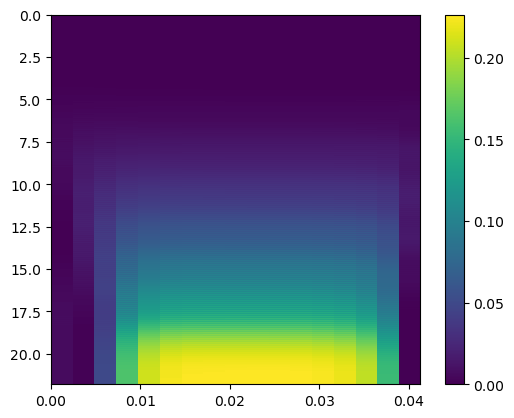

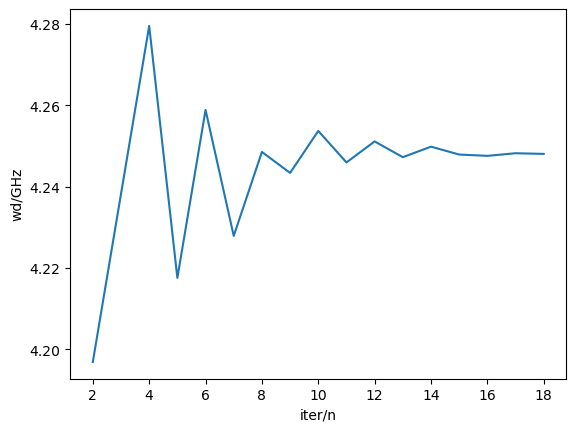

dpi=8.473856316551756e-05,w_match=4.248032074303574 
 auto_scan_scope end
run start


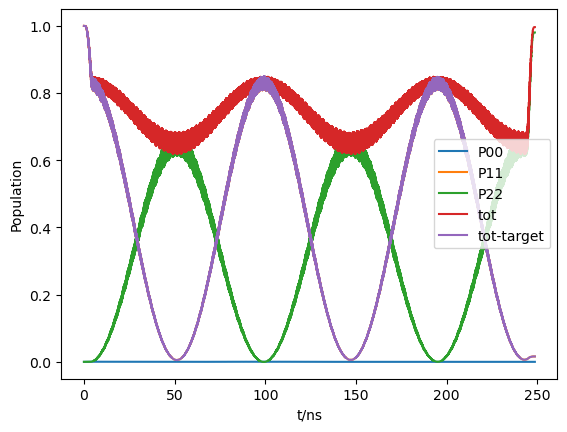

run end
wd_fit start 
 sp=1


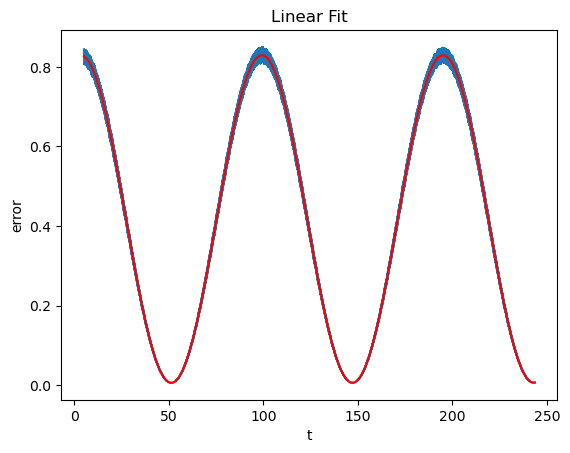

guess value of [d_eff,F,t0,c]=[0.008473856316551755, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.01042885454508033, 0.8235305230616435, 3.2804503376178737, 0.005705193920793358, 95.887807781511]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.27
amp=0.27
auto_scan_scope start 
 sp=1
T for scan:20.943042145134598
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=3
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=3
iter_num=13
run start
run end
iter_num=14
run start
run end
iter_num=15
run start
run end
j=3
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
[4.249484320770232, 0.245771042494519]


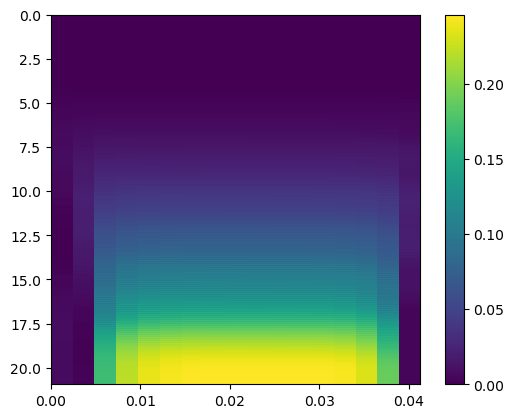

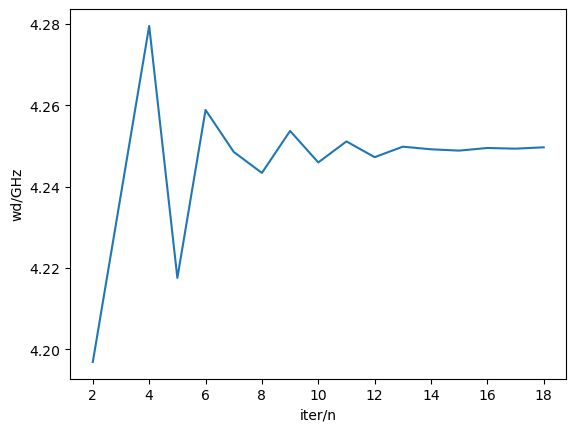

dpi=9.13822670823407e-05,w_match=4.249484320770232 
 auto_scan_scope end
run start


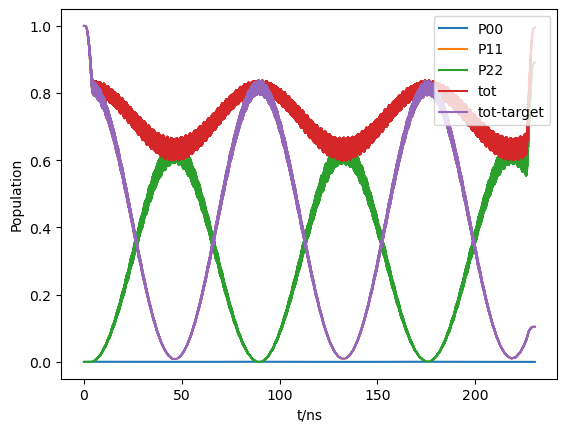

run end
wd_fit start 
 sp=1


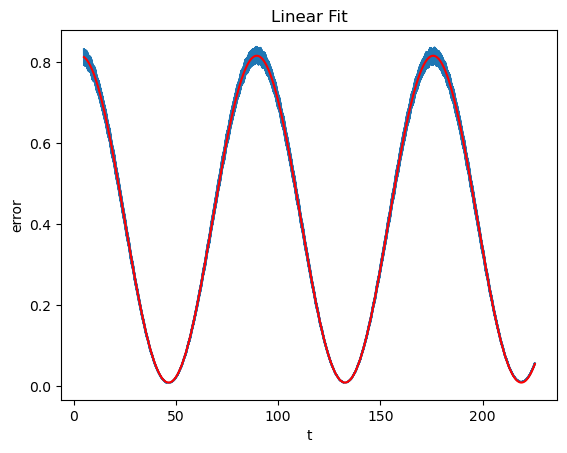

guess value of [d_eff,F,t0,c]=[0.00913822670823407, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.011591641139568456, 0.806711444073649, 3.281640394228203, 0.009366119544933852, 86.2690612968052]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.27999999999999997
amp=0.27999999999999997
auto_scan_scope start 
 sp=1
T for scan:20.175354239544802
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=3
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=2
iter_num=9
run start
run end
iter_num=10
run start
run end
j=3
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
[4.250775206518375, 0.26559238955766]


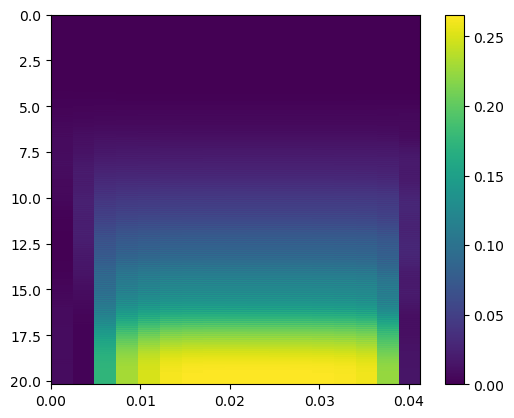

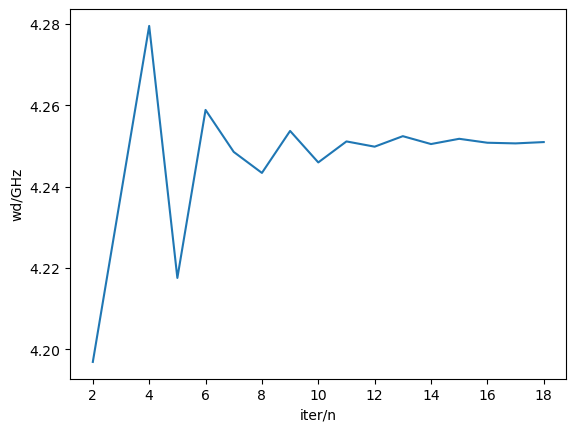

dpi=9.827667680734577e-05,w_match=4.250775206518375 
 auto_scan_scope end
run start


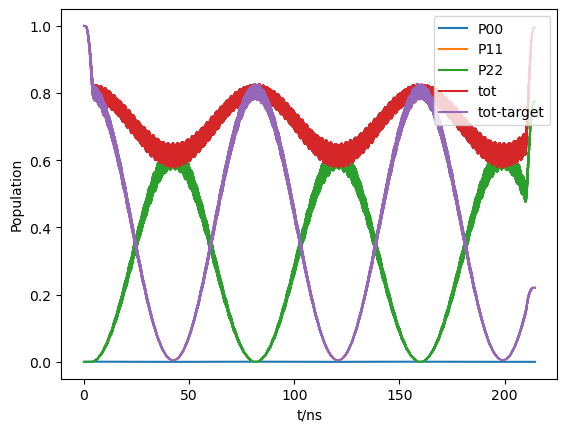

run end
wd_fit start 
 sp=1


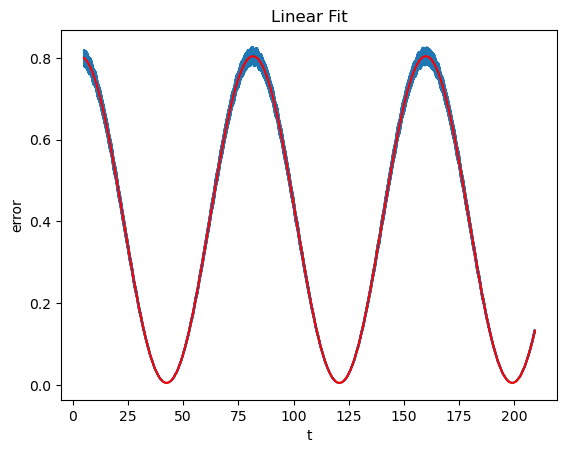

guess value of [d_eff,F,t0,c]=[0.009827667680734576, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.012764040897916464, 0.7994672902616153, 3.2755485854813013, 0.0047323222290752845, 78.3450952560983]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.29
amp=0.29
auto_scan_scope start 
 sp=1
T for scan:19.485704784545923
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=3
iter_num=6
run start
run end
iter_num=7
run start
run end
iter_num=8
run start
run end
j=3
iter_num=9
run start
run end
iter_num=10
run start
run end
iter_num=11
run start
run end
j=3
iter_num=12
run start
run end
iter_num=13
run start
run end
j=2
iter_num=14
run start
run end
iter_num=15
run start
run end
j=2
iter_num=16
run start
run end
iter_num=17
run start
run end
j=2
[4.252388813703552, 0.2865875049755163]


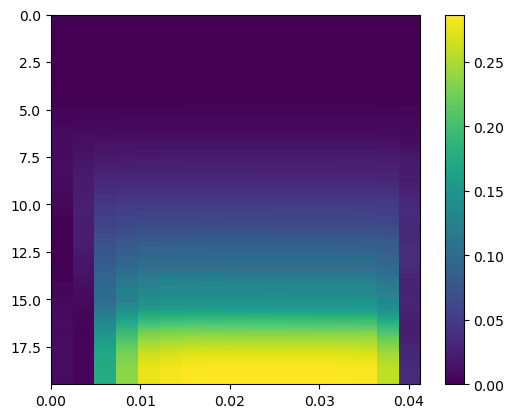

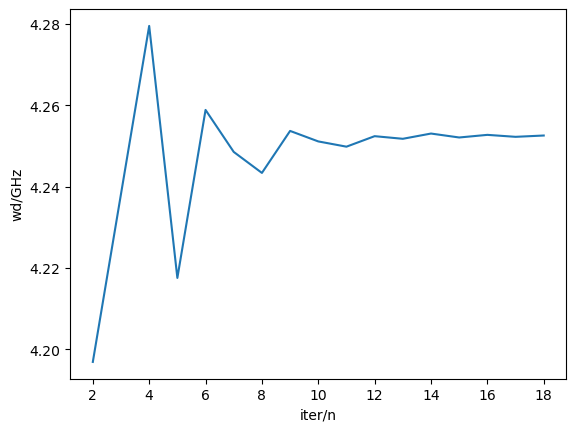

dpi=0.00010542179234053293,w_match=4.252388813703552 
 auto_scan_scope end
run start


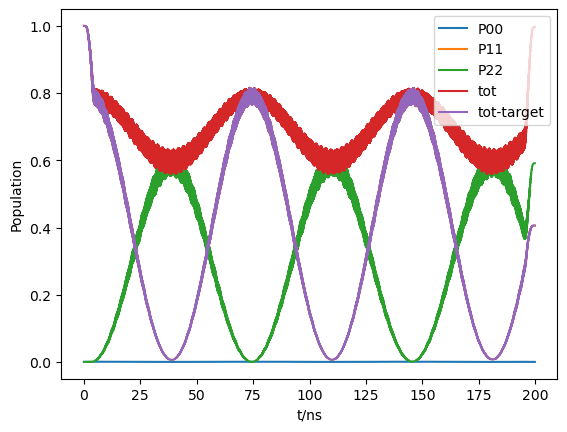

run end
wd_fit start 
 sp=1


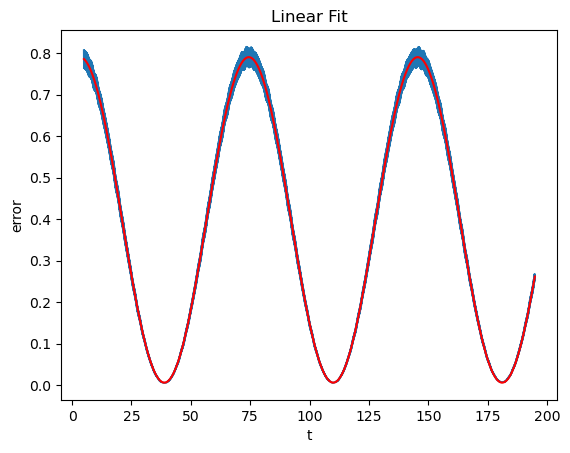

guess value of [d_eff,F,t0,c]=[0.010542179234053293, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.014059391112658439, 0.7840002462117138, 3.2829367314939075, 0.006390088361770605, 71.12683557822396]
 wd_fit end
auto_scan_amp ,sp=1 ,amp=0.3
amp=0.3
auto_scan_scope start 
 sp=1
T for scan:18.863864137559027
iter_num=1
run start
run end
iter_num=2
run start
run end
iter_num=3
run start
run end
iter_num=4
run start
run end
iter_num=5
run start
run end
j=3
iter_num=6
run start
run end
iter_num=7
run start
run end
j=2
iter_num=8
run start
run end
iter_num=9
run start
run end
iter_num=10
run start
run end
j=2
iter_num=11
run start
run end
iter_num=12
run start
run end
j=2
iter_num=13
run start
run end
iter_num=14
run start
run end
j=2
iter_num=15
run start
run end
iter_num=16
run start
run end
j=3
iter_num=17
run start
run end
iter_num=18
run start
run end
j=2
[4.25400242088873, 0.3094337132332545]


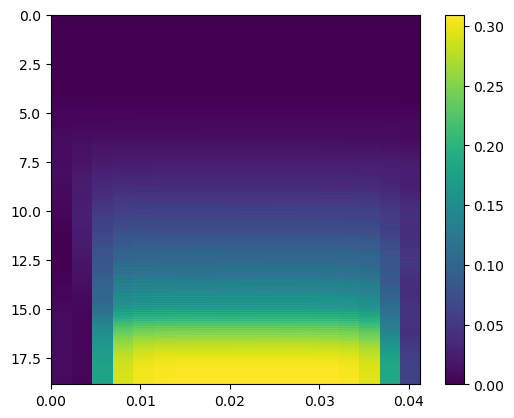

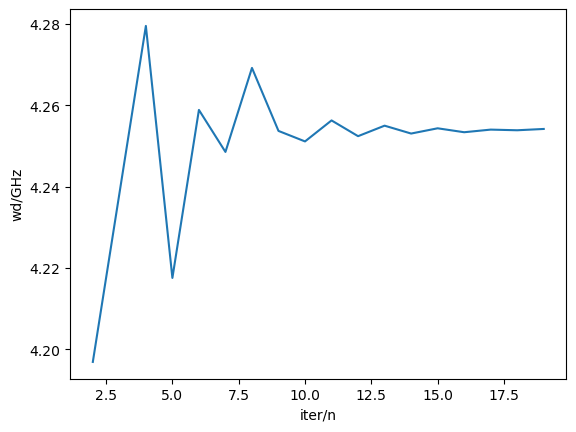

dpi=0.00011281761368190205,w_match=4.25400242088873 
 auto_scan_scope end
run start


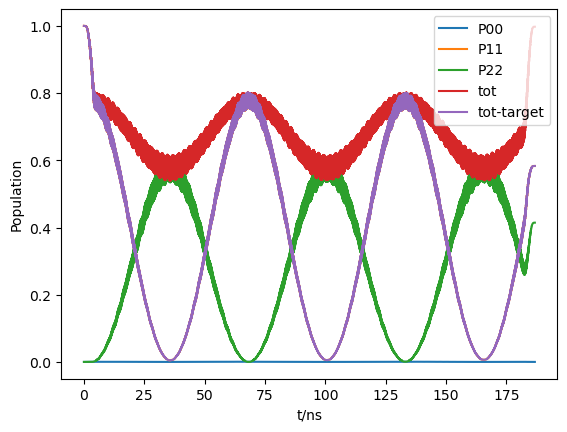

run end
wd_fit start 
 sp=1


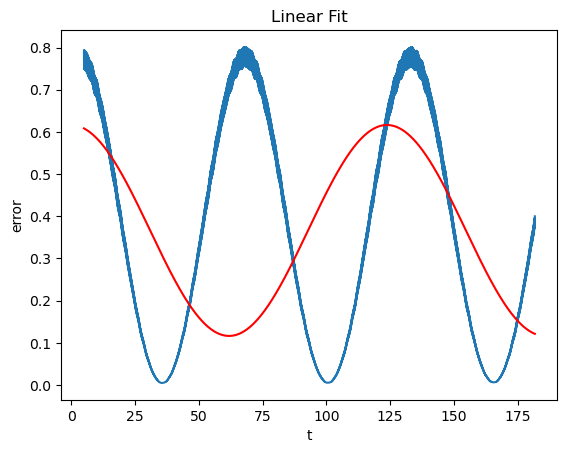

guess value of [d_eff,F,t0,c]=[0.011281761368190205, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.008078499670023116, 0.5000000000000001, 1.8505701063407452e-15, 0.11634403946407927, 123.7853612485372]
 wd_fit end


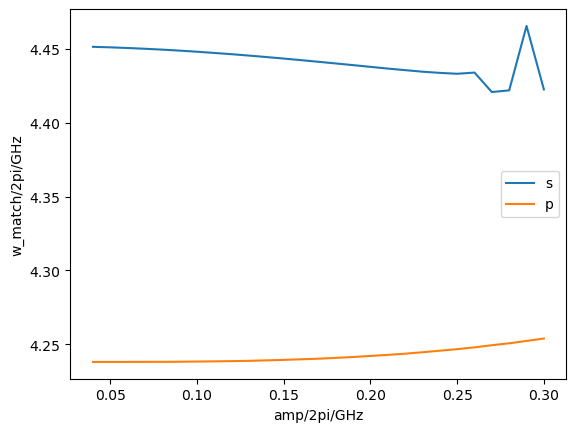

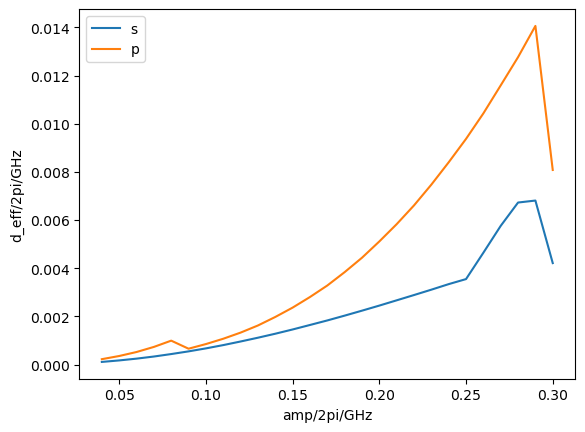

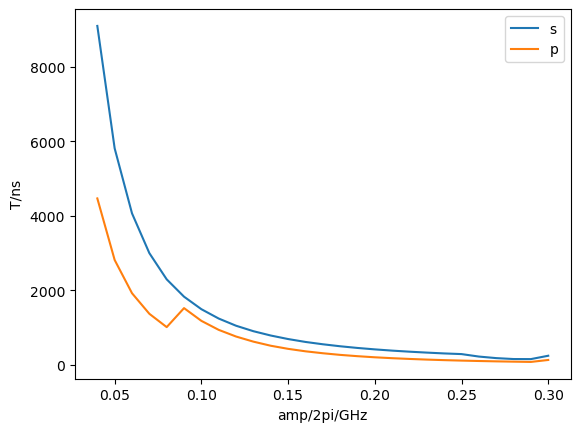

auto_scan_amp end


In [70]:
!!!!!dont run
# wd=[4.434592382431534,4.244749961774963]
# 4.244749961774963
# a=sideband(level=4,Tstep=100000,t_edge=5,
# w=[5,4],yita=[0.3,0.3],g=[0.1],
# L=3000,wd=wd,sp_direct=[1,0],amp=0.15,
# rho0=0)


In [71]:
wd=[4.434592382431534,4.244749961774963]
4.244749961774963
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[4.5,4],yita=[0.3,0.3],g=[0.1],

L=3000,wd=wd,sp_direct=[1,0],amp=0.15,
rho0=0)
# a.d_eff_g
# a.d_eff_g
# a.ksp_g
# a.wd
# b=a.auto_scan_scope(sp=0,)
amp_result=a.auto_scan_amp(0.02,0.2,19)
# res=a.run(plot=True)
# fit=a.wd_fit(res)
# res=a.run(plot=False)
# a.T_g/2
# c=a.wd_fit(res,sp=1)

auto_scan_amp start 
 astart,astop,astep=(0.02, 0.2, 19)
auto_scan_amp ,sp=0 ,amp=0.02
amp=0.02
auto_scan_scope start 
 sp=0
T for scan:746.5241746120429
iter_num=1
run start
run end
iter_num=2
run start


KeyboardInterrupt: 

run start


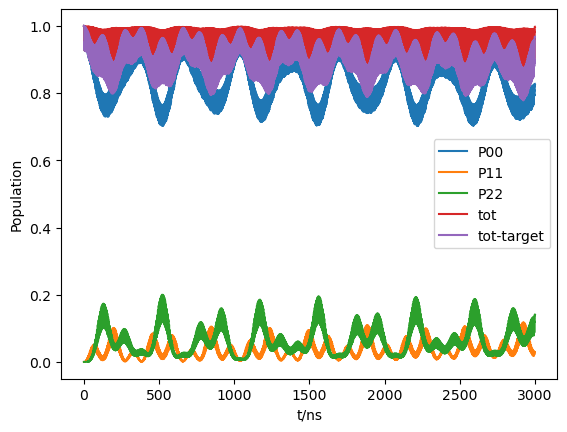

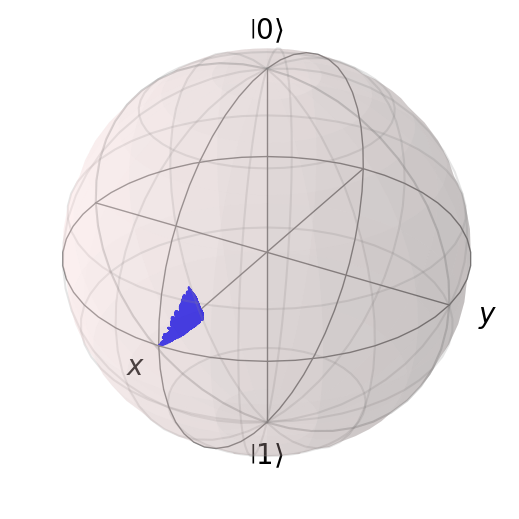

run end
wd_fit start 
 sp=0


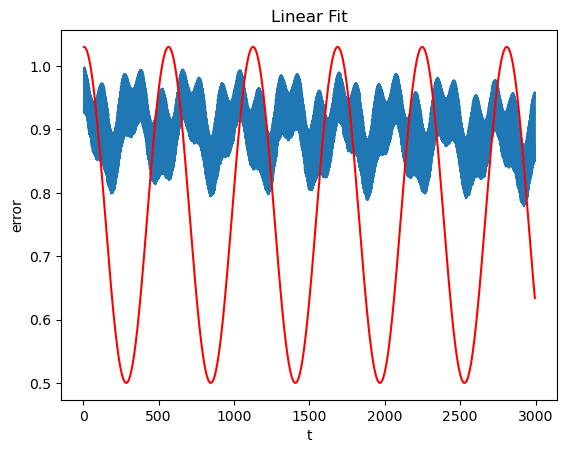

guess value of [d_eff,F,t0,c]=[0.001825246901286344, 1, 2.5, 0]
fit coeff [d_eff,F,t0,c,T]=[0.0017833981202037075, 0.5301652728595795, 4.999999999999999, 0.49999999999999994, 560.7272928412506]
 wd_fit end


In [63]:
wd=[4.434592382431534,4.244749961774963]
4.244749961774963
a=sideband(level=4,Tstep=100000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.15],

L=3000,wd=wd,sp_direct=[1,1],amp=0.15,
rho0=0)
# a.d_eff_g
# a.d_eff_g
# a.ksp_g
# a.wd
# b=a.auto_scan_scope(sp=0,)
# amp_result=a.auto_scan_amp(0.06,0.24,10)
res=a.run(plot=True)
fit=a.wd_fit(res)
# res=a.run(plot=False)
# a.T_g/2
# c=a.wd_fit(res,sp=1)

auto_scan_scope start 
 sp=1
T for scan:35.657787743397265
iter_num=1
run start


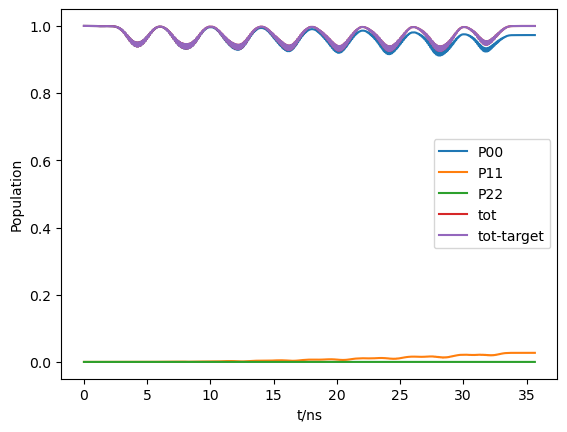

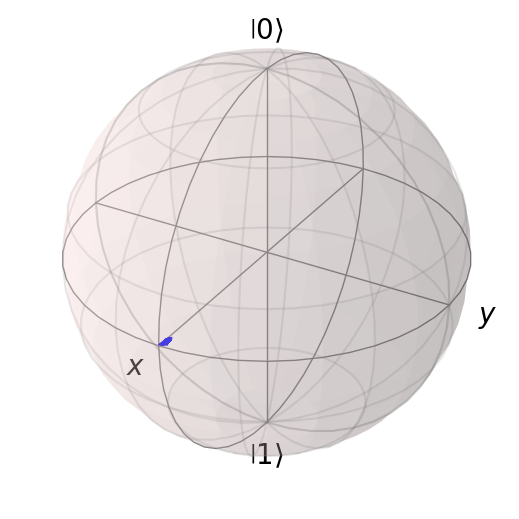

run end
iter_num=2
run start


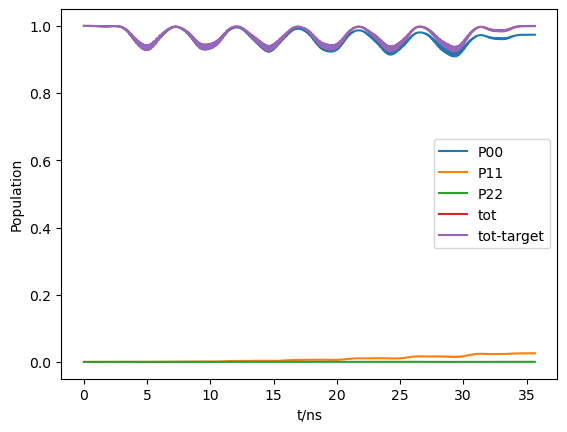

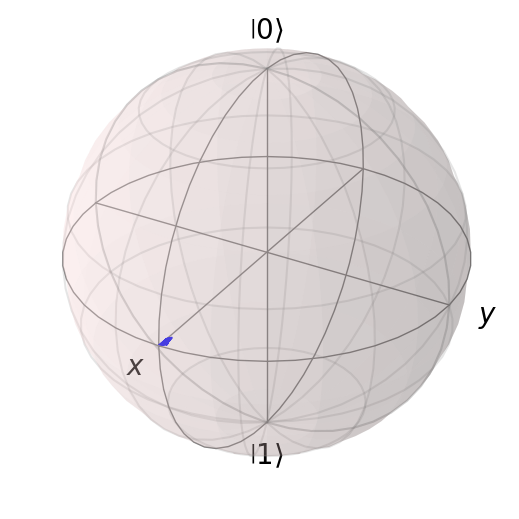

run end
iter_num=3
run start


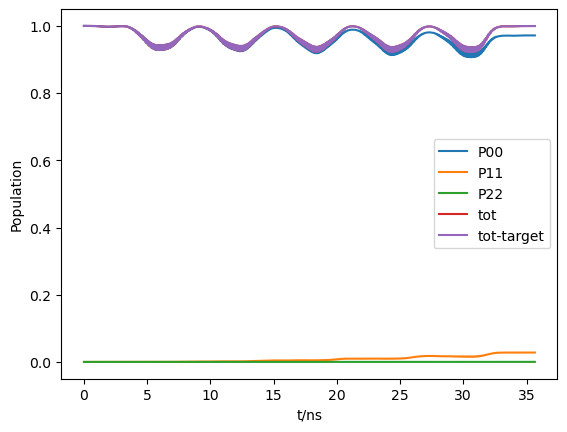

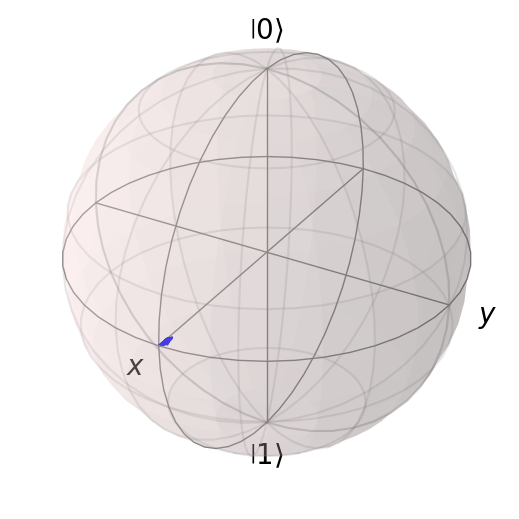

run end
iter_num=4
run start


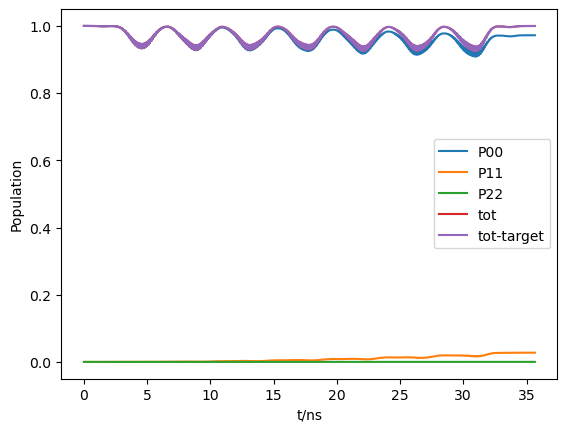

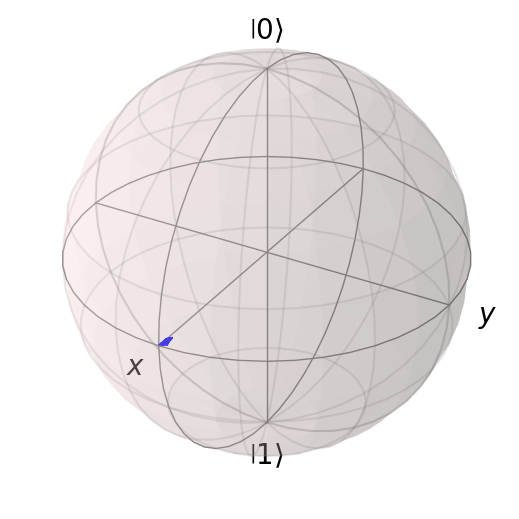

run end
iter_num=5
run start


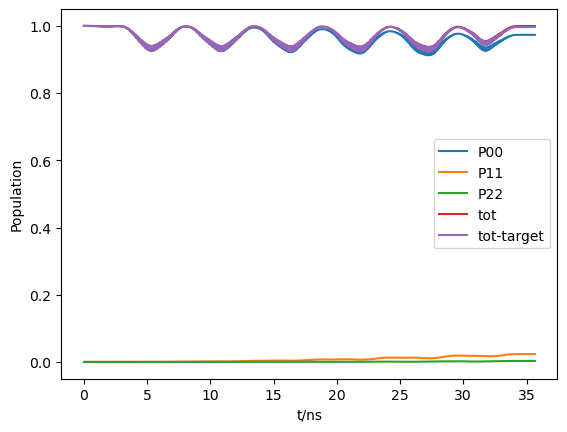

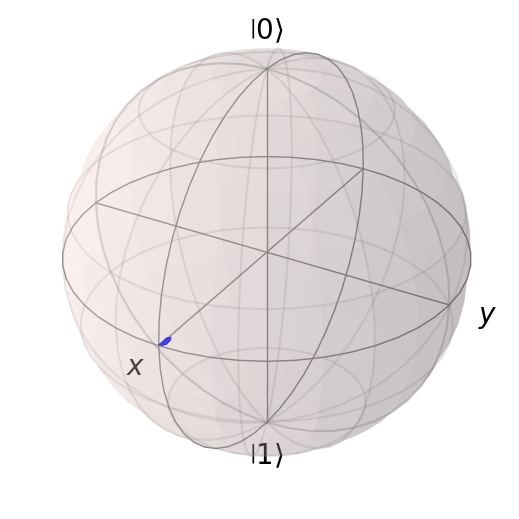

run end
j=3
iter_num=6
run start


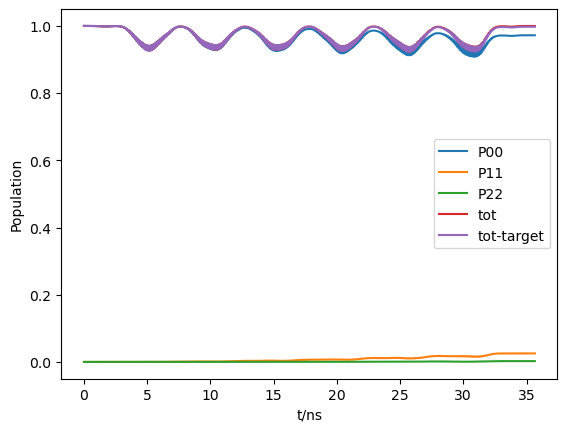

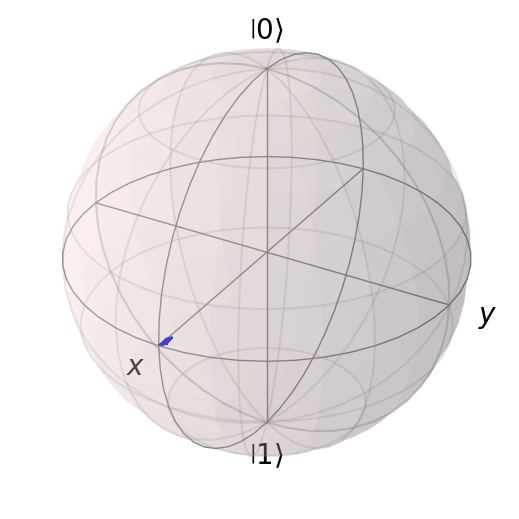

run end
iter_num=7
run start


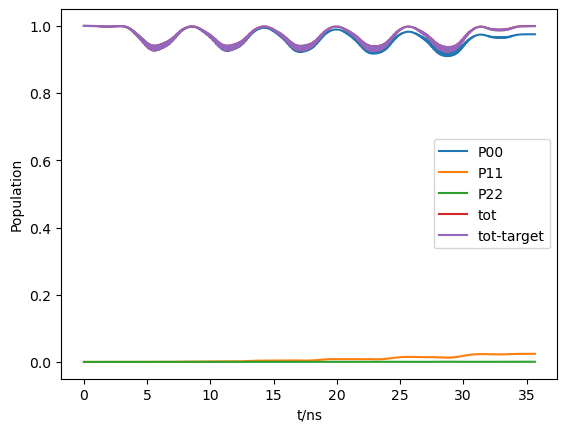

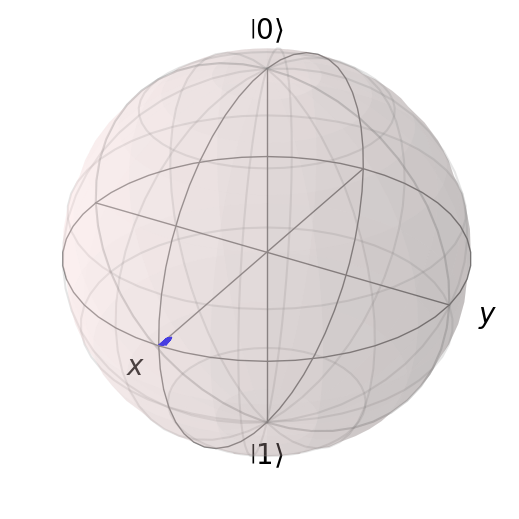

run end
j=2
iter_num=8
run start


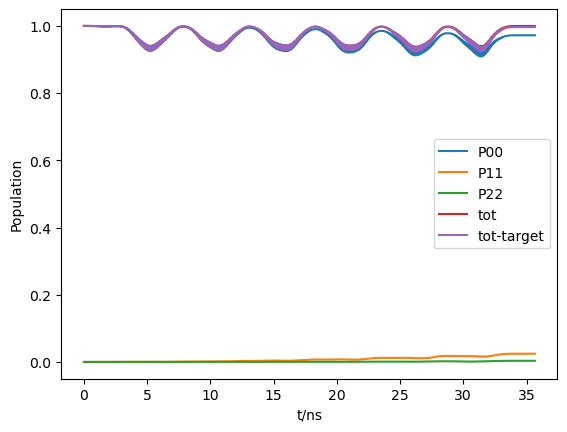

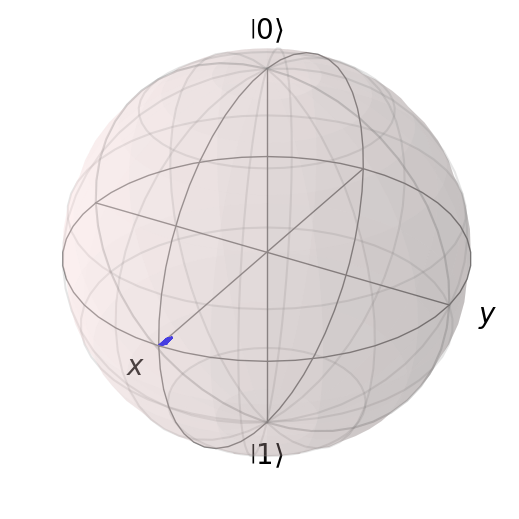

run end
iter_num=9
run start


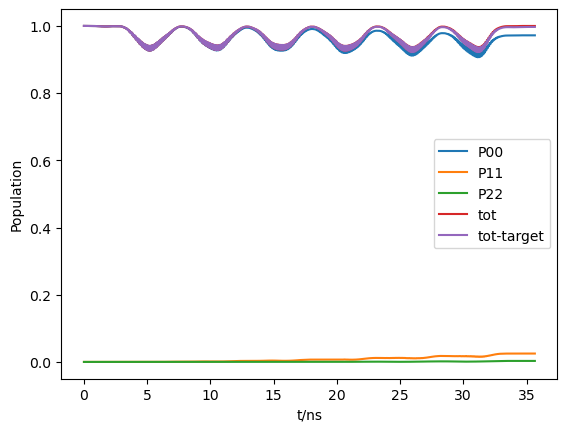

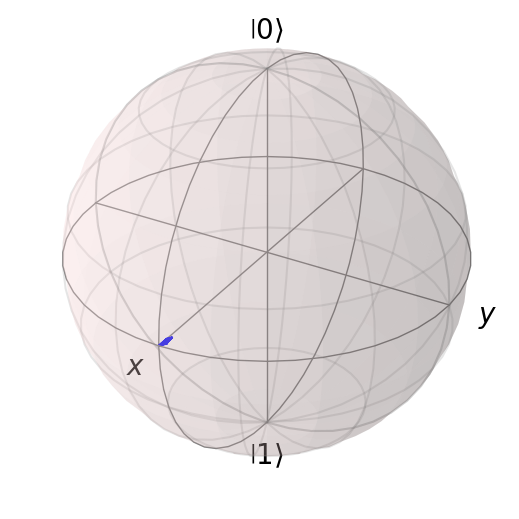

run end
iter_num=10
run start


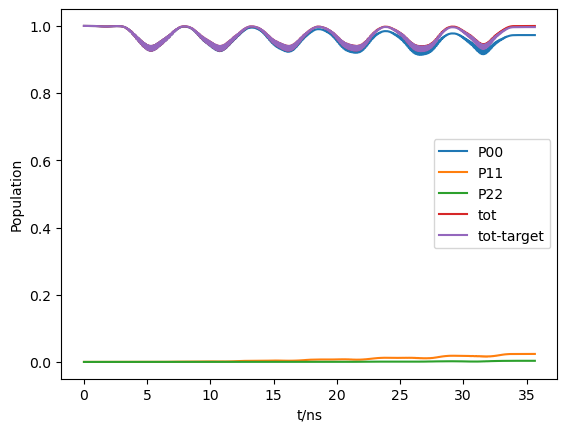

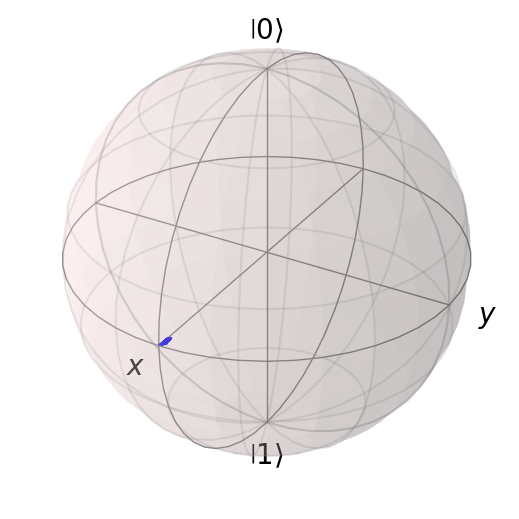

run end
j=2
iter_num=11
run start


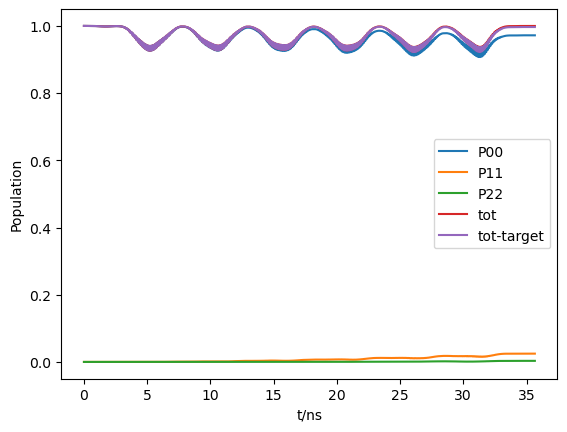

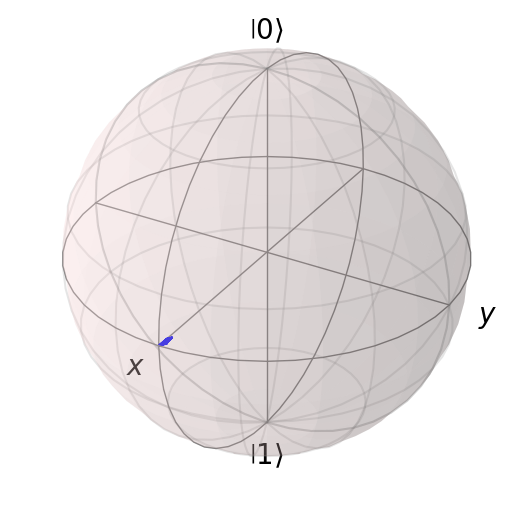

run end
iter_num=12
run start


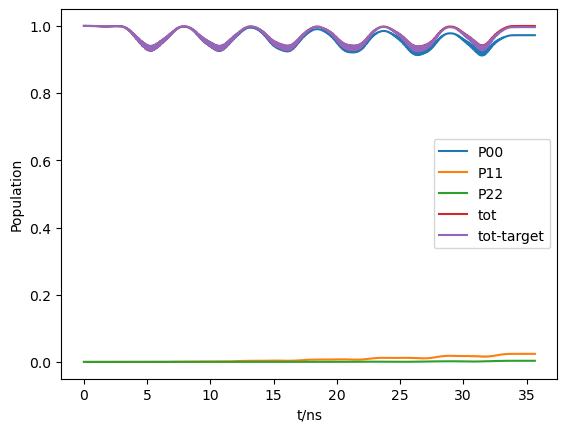

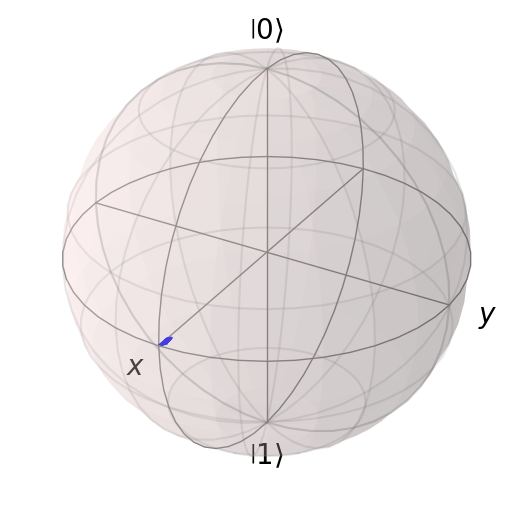

run end
j=3
iter_num=13
run start


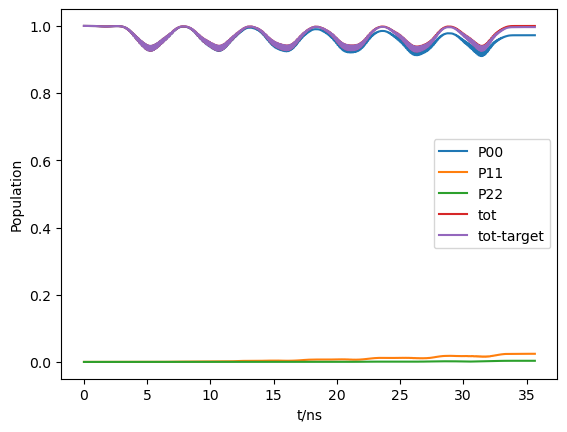

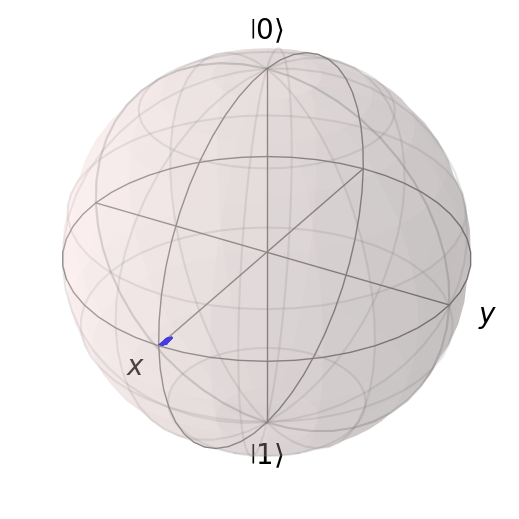

run end
iter_num=14
run start


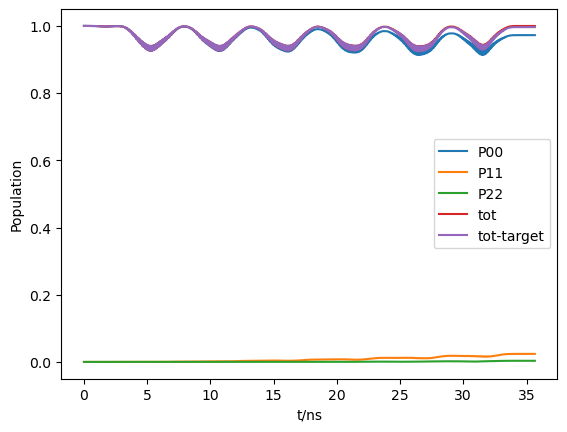

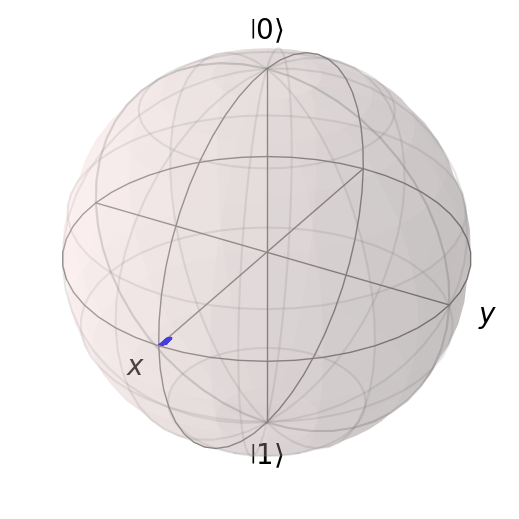

run end
j=2
iter_num=15
run start


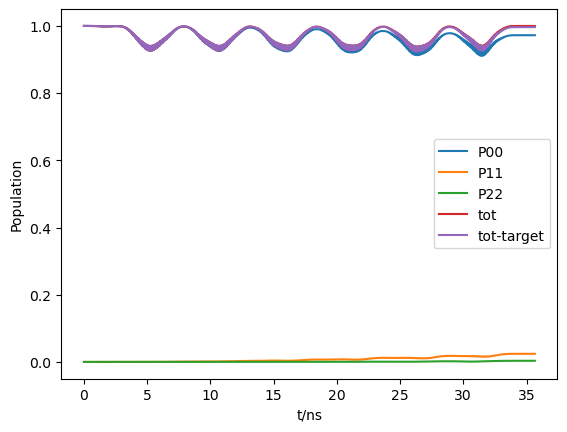

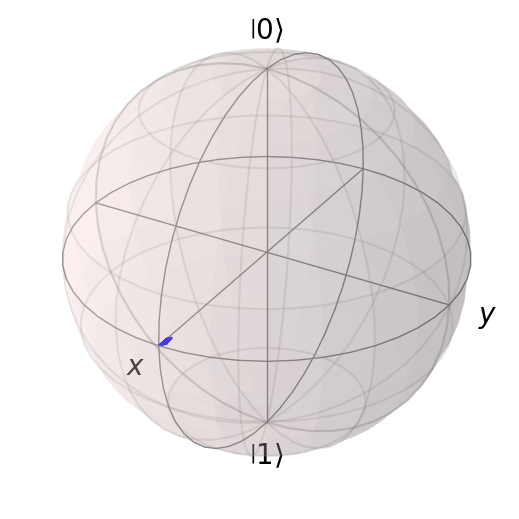

run end
iter_num=16
run start


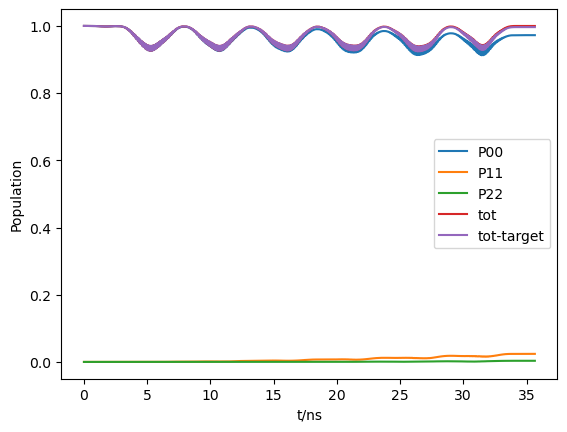

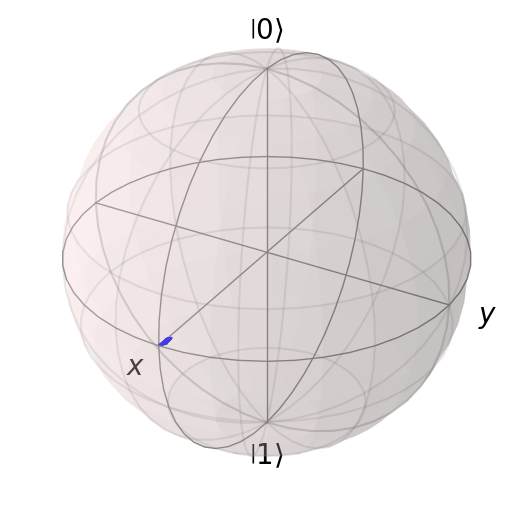

run end
j=2
iter_num=17
run start


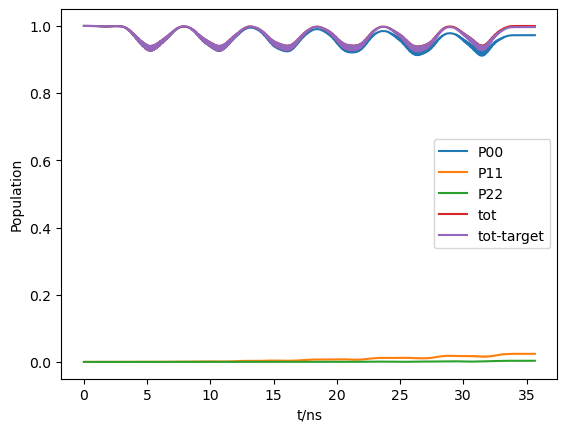

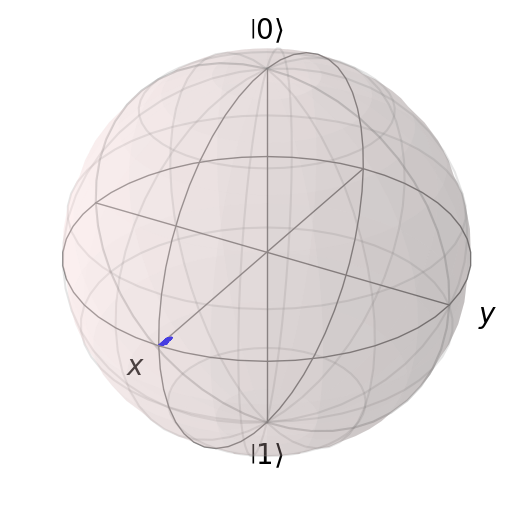

run end
iter_num=18
run start


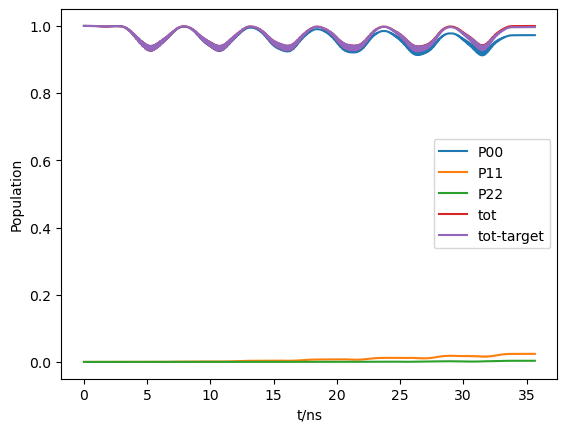

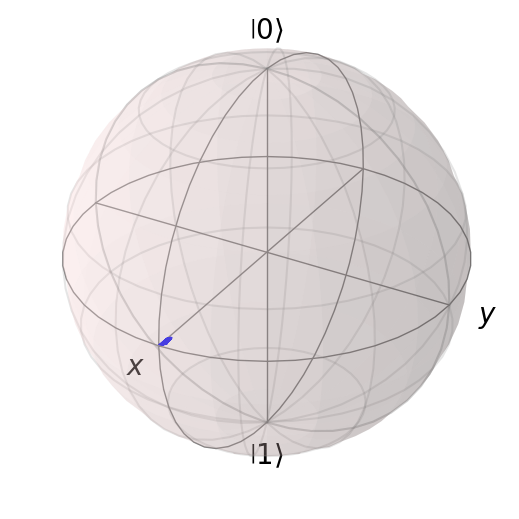

run end
j=2
iter_num=19
run start


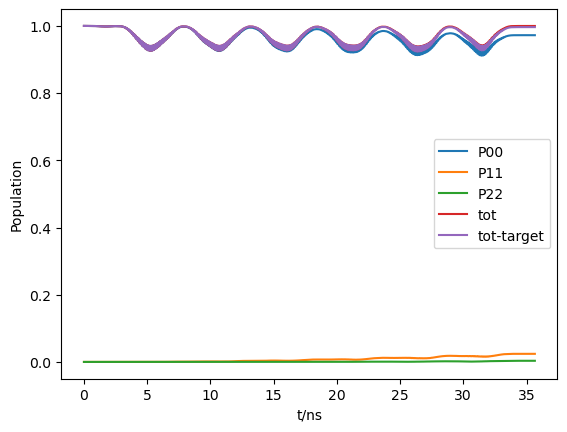

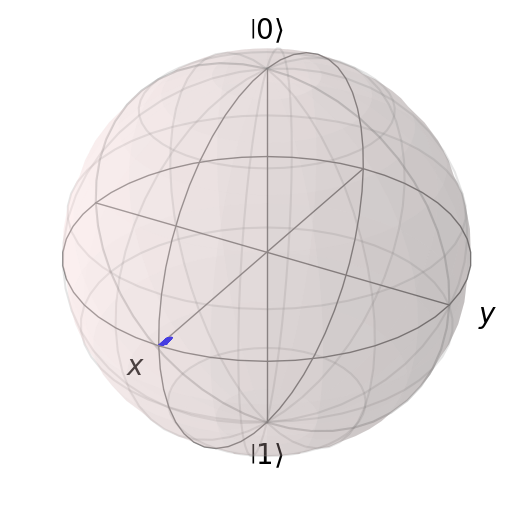

run end
iter_num=20
run start


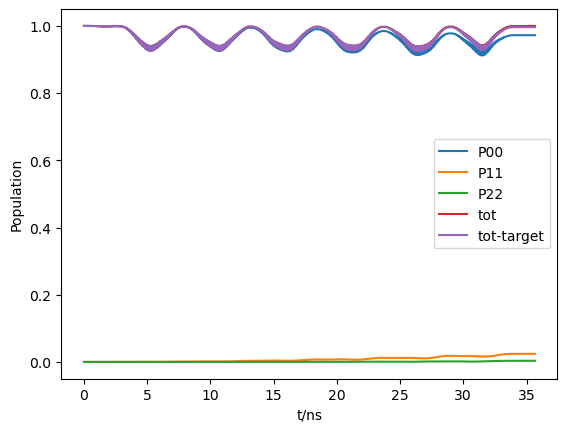

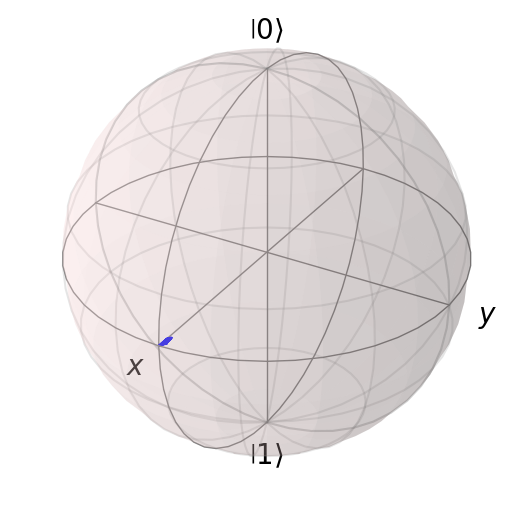

run end
j=2
iter_num=21
run start


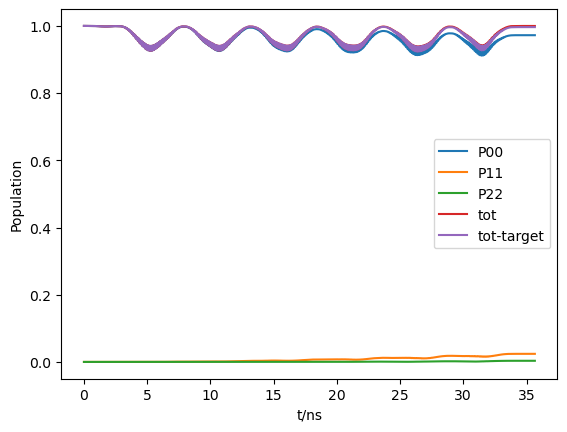

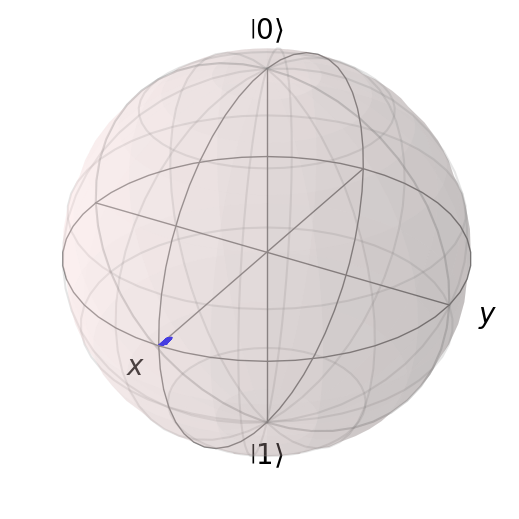

run end
iter_num=22
run start


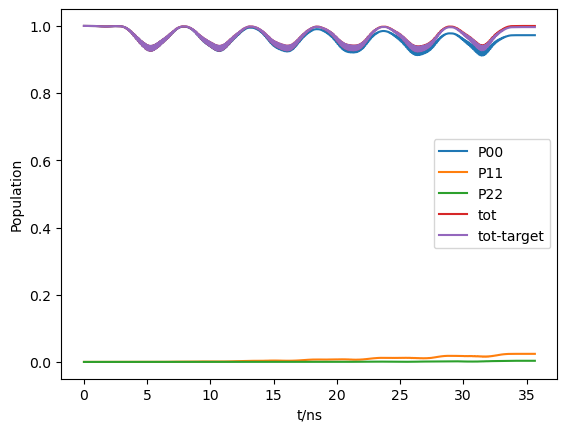

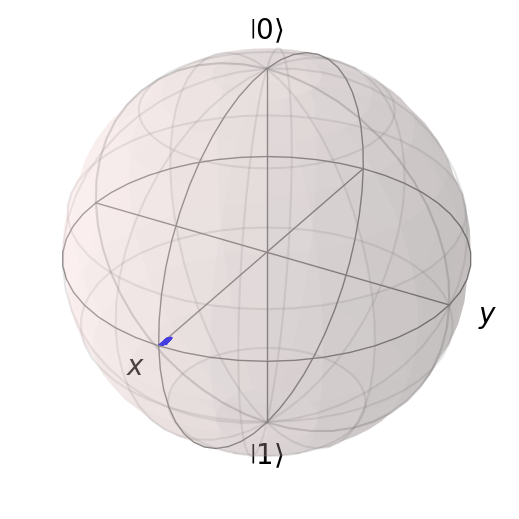

run end
j=2
[4.244749961774963, 0.003391080081467083]


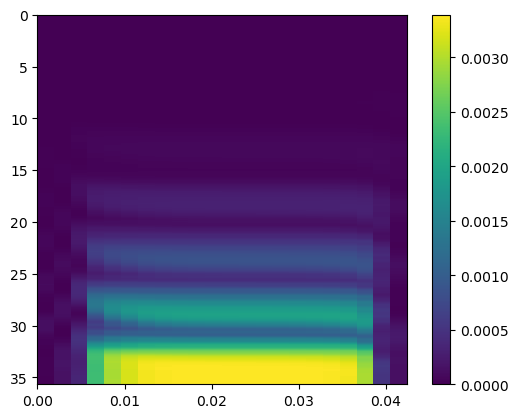

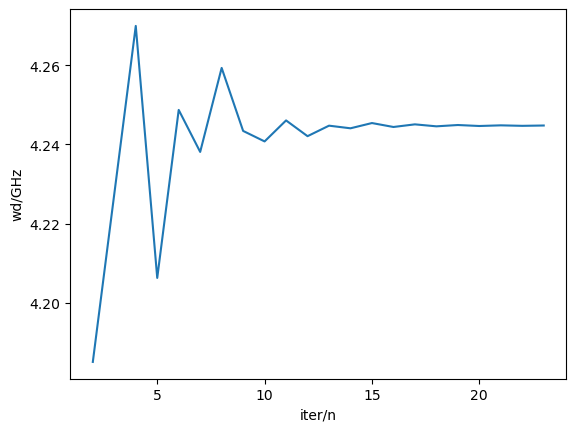

dpi=3.8974521498149755e-05,w_match=4.244749961774963 
 auto_scan_scope end


In [59]:
wd=[4.434592382431534,4.190524124255707]
4.244749961774963
a=sideband(level=4,Tstep=10000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.15],

L=500,wd=wd,sp_direct=[1,1],amp=0.15,
rho0=0,rho_tar=2)
# a.d_eff_g
# a.d_eff_g
# a.ksp_g
# a.wd
b=a.auto_scan_scope(sp=1,tar=2)
# amp_result=a.auto_scan_amp(0.06,0.24,10)
# a.run()
# res=a.run(plot=False)
# a.T_g/2
# c=a.wd_fit(res,sp=1)

T_g=1095.7421697801535,ws_g=4.444324760355917,wp_g=4.2275215821301


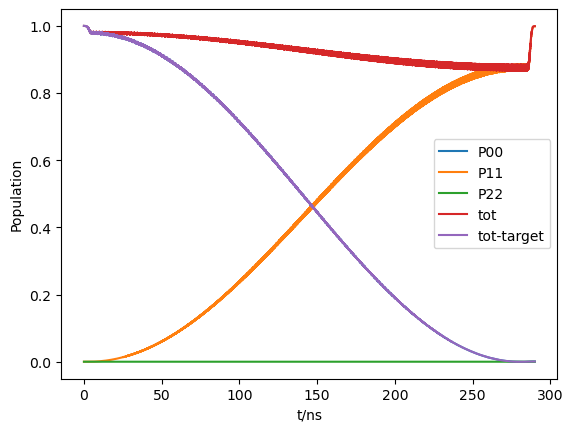

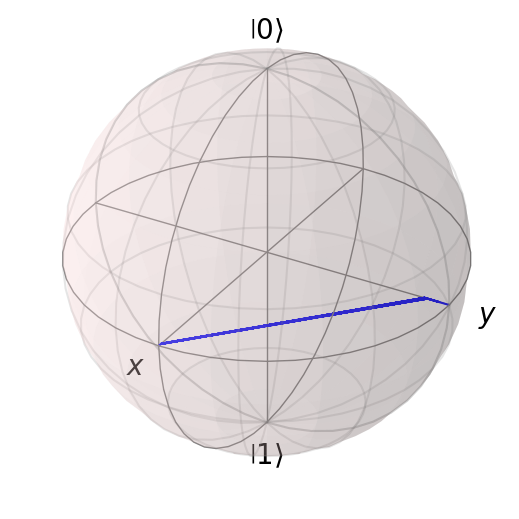

Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [190]:
wd=[4.437136778043149,4.230516359060555]

a=sideband(level=4,Tstep=10000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.15],
L=290,wd=wd,sp_eff=[1,0],amp=0.15,
rho0=0,rho_tar=1)


a.run(plot=True)


C:\Users\1163080609\AppData\Local\Temp\ipykernel_18652\3268121770.py:81: RuntimeWarning: divide by zero encountered in scalar divide
  self.T_g=2/self.ds_g


T_g=inf,ws_g=4.444324760355917,wp_g=4.2275215821301


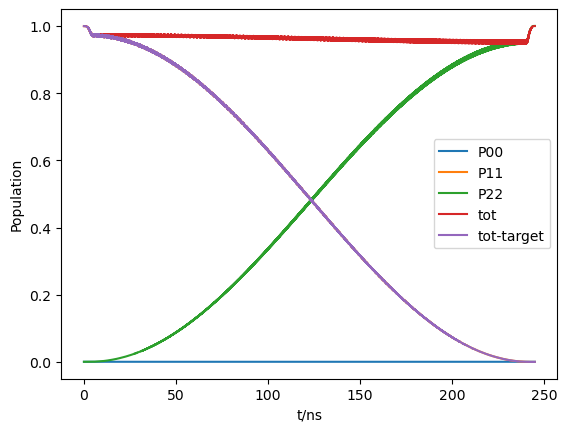

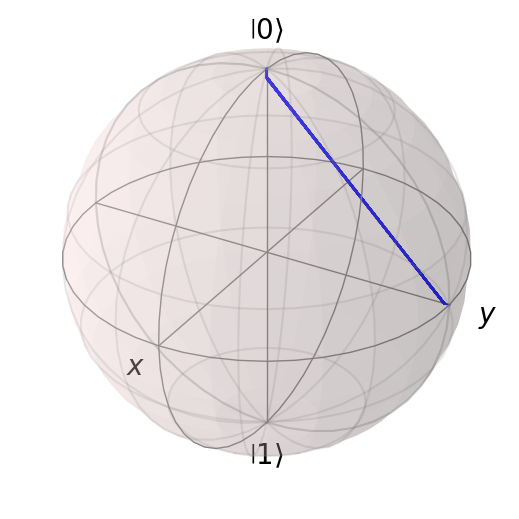

Result object with mesolve data.
--------------------------------
expect = True
num_expect = 3, num_collapse = 0

In [194]:
wd=[4.437136778043149,4.230516359060555]

a=sideband(level=4,Tstep=10000,t_edge=5,
w=[5,4],yita=[0.3,0.3],g=[0.15],
L=245,wd=wd,sp_eff=[0,1],amp=0.15,
rho0=1,rho_tar=2)

print(f'T_g={a.T_g},ws_g={a.ws_g},wp_g={a.wp_g}')
a.run(plot=True)


In [ ]:
    ###############################################
def fit_w_mat(self,input,target=None,plot=False):
        '''for rabi'''
        if target==None:
            target=self.rho0+1
        x,z=input[4],input[0]
        y=np.transpose(z[target][-1])
        if self.rho0==0:
            d_guess=2*(self.amp*self.ks)**2*self.yita[0]*self.g[0]/self.ee[1]
            guess=[5.927+0*self.ee[4]/2,d_guess,1,self.L-self.tupdown]
            print(guess)
        else :
            d_guess=8*(self.amp*self.kp)**2*self.yita[0]*self.g[0]/self.ee[1],
            guess=[(self.ee[self.s22]-self.ee[4])/2,d_guess,1,self.L]
            print(guess)
        def func(x,wm,d,F,t):
            # F=2
            # wm=5.928
            # return 0.5*(1/(1+((x-b)/d)**2))*(1-0*np.cos(t*(1+((x-b/d)**2))))
            # return np.abs(1/(1+(x-b)**2))
            # return F*1/(((x-wm)/d)**2+1)#*(0.5*(1-np.cos(t*np.sqrt(d**2+(x-wm)**2))))
            return F*1/(((x-5.927)/d)**2+1)#*(0.5*(1-np.cos(t*np.sqrt(d**2+(x-wm)**2))))
        
        # 拟合数据
        coeff, var_matrix = curve_fit(func,x,y,guess,\
            bounds=([self.ee[1],d_guess*0.5,0,0],[self.ee[2],d_guess*2,1,1000]))
 
        # 输出拟合参数
        
        if plot==True:
            print(f"wm,d,f,t: {coeff}")#, D/2pi: {coeff[1]}")
            plt.scatter(x, y)
            plt.plot(x, func(x,*coeff),color='red')
            plt.xlabel('x')
            plt.ylabel('y')
            plt.title('Linear Fit')
            plt.show()

        return 0

# 
class optimize:
    '''optimize of gate parameters and visualize
    func_targ(result) --> value
    '''
    def __init__(self,name,start,step_start,step_m,dpi,gateclass,func_targ):
        self.name=name
        self.start,self.step,self.step_m,self.dpi=start,step_start,step_m,dpi
        self.gate,self.func=gateclass,func_targ
        self.dict_p={name:start}
    
    def opti_process(self,plot=True):
        name,gate,dic=self.name,self.gate,self.dict_p
        step,step_m,dpi=self.step,self.step_m,self.dpi
        para0=gate.params
        
        plist,expect_list=[],[]
        #确定范围
        while step>=dpi: 
            gate.params.update(dic)
            result=gate.run()
        result


    def imshow(self):

        plt.imshow(z[target],extent=[0,stop-start,self.tlist[-1],self.tlist[0]],\
        aspect=(wstop-wstart)/(self.tlist[-1]-self.tlist[0]),interpolation='none')
        plt.colorbar()
        plt.show()

    def fit_w_mat(self,input,target=None,plot=False):
        '''for rabi'''
        if target==None:
            target=self.rho0+1
        x,z=input[4],input[0]
        y=np.transpose(z[target][-1])
        if self.rho0==0:
            d_guess=self.ds
            wm_guess=self.ee[4]/2
            guess=[wm_guess,d_guess,1,self.L-self.tupdown]
            print(guess)
        elif self.rho0==1:
            d_guess=self.dp
            wm_guess=(self.ee[self.s22]-self.ee[4])/2
            guess=[wm_guess,d_guess,1,self.L-self.tupdown]
            print(guess)

        def func(x,wm,d,F,t):
            # F=2
            # wm=5.928
            # d=0.004
            # t=150
            # wm=5.927
            # return F*1/(((x-wm)/d)**2+1)#*(0.5*(1-np.cos(t*np.sqrt(d**2+(x-wm)**2))))
            return F*1/(((x-wm)/d)**2+1)*(0.5*(1-np.cos(2*np.pi*t*np.sqrt(d**2+(x-wm)**2))))
        
        # 拟合数据
        print(type(wm_guess),type(d_guess))
        coeff, var_matrix = curve_fit(func,x,y,guess,\
            bounds=([wm_guess-0.1,d_guess*0.6,0,0*(self.L-5*self.tupdown)],\
                    [wm_guess+0.1,d_guess*1.5,1.0,1000+0*(self.L+5*self.tupdown)]))
 
        # 输出拟合参数
        
        if plot==True:
            print(f"wm,d,f,t: {coeff}")#, D/2pi: {coeff[1]}")
            plt.scatter(x, y)
            plt.plot(x, func(x,*coeff),color='red')
            plt.xlabel('x')
            plt.ylabel('y')
            plt.title('Linear Fit')
            plt.show()

        return coeff



In [ ]:
    def auto_scan_scope(self,sp=0):
        s22=self.s22
        ws=self.ee[4]/2
        wp=(self.ee[s22]-self.ee[4])/2
        dw=self.ee[2]-self.ee[1]

        if sp==0:
            T=2*self.tupdown+1/self.ds*0.2
            self.update(L=T)
            print(f'T_guess={T}')
            while dpi>0.0001:
                input1=self.scan_wd(ws-dw*0.05,ws+dw*0.05,7,sp=sp,plot=True)
                coeff1=self.find_w_mat(input=input1,plot=True)
                ws1=coeff1[0]
                print(f'({ws-dw/20},{ws+dw/20}),{ws1}')
                input2=self.scan_wd(ws1-dw/100,ws1+dw/100,10,sp=sp,rho0=self.rho0,plot=True)
                coeff2=self.find_w_mat(input=input2,plot=True)
                ws2=coeff2[0]
                print(f'({ws1-dw/100},{ws1+dw/100}),{ws2}')

                dpi=dpi/2
                dom=1
            # self.run(plot=True)
            return ws2
        if sp==1:
            T=2*self.tupdown+1/self.dp*0.1
            self.update(L=T)
            print(f'T={T}')
            input1=self.scan_wd(wp-dw/20,wp+dw/20,10,sp=sp,rho0=self.rho0,plot=True)
            coeff1=self.find_w_mat(input=input1,plot=True)
            wp1=coeff1[0]
            print(f'({wp-dw/20},{wp+dw/20}),{wp1}')
            input2=self.scan_wd(wp1-dw/100,wp1+dw/100,10,sp=sp,rho0=self.rho0,plot=True)
            coeff2=self.find_w_mat(input=input2,plot=True)
            wp2=coeff2[0]
            print(f'({wp1-dw/100},{wp1+dw/100}),{wp2}')
            # self.run(plot=True)
            return wp2

In [ ]:
# amp_result_delat1G=a.auto_scan_amp(0.04,0.3,27)